# Air pollution analysis in India (EDA and Clustering [K Mean])

## Import Library

In [301]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb

import warnings
warnings.filterwarnings('ignore')

## Import Data

In [385]:
dt=pd.read_csv('indian_air_pollution_2015_2024.csv')

In [387]:
df=dt.copy()

In [389]:
df.head(2)

,stn_code,date,state,location,agency,type,so2,no2,co,pb,location_monitoring_station,pm_10,pm_2.5
0,AP100000001,20-04-2023,Delhi,Dwarka,IIT Research,Residential,400.03,22.65,334.35,0.67,Dwarka Station 13,20.34,75.04
1,AP100000002,07-10-2018,Punjab,Jalandhar,NEERI,Residential,909.26,22.79,217.87,1.17,Jalandhar Station 16,42.54,117.61


## Features

In [392]:
# Stn_Code : Station code. A code is given to each station that recorded the data.
# Date: The date when the data was recorded.
# State: It represents the states whose air quality data is measured.
# location: It represents the city whose air quality data is measured.
# agency: Name of the agency that measured the data.
# type: The type of area where the measurement was made.
# so2: The amount of Sulphur Dioxide measured.
# no2: The amount of Nitrogen Dioxide measured
# co:  The amount of Carbon Monoxide measured
# pb:  The amount of Lead  measured
# location_monitoring_station: It indicates the location of the monitoring area.
# pm_2.5: It represents the value of particulate matter measured that are 2.5 microns or less in diameter
# pm_10:  It represents the value of particulate matter measured  that is 10 micrometers or less in diameter

## Data Transformation

### Change Datatypes

In [396]:
df.dtypes

stn_code                        object
date                            object
state                           object
location                        object
agency                          object
type                            object
so2                            float64
no2                            float64
co                             float64
pb                             float64
location_monitoring_station     object
pm_10                          float64
pm_2.5                         float64
dtype: object

### Drop unnecessary data

In [398]:
df=df.drop(['stn_code','agency','location_monitoring_station' ],axis=1 )

### Handle null value

In [400]:
n=df.isnull().sum()
n=n[n>0]
n

Series([], dtype: int64)

### Handle Duplicate Values

In [402]:
df.duplicated().sum()

0

## Change Datatype

In [404]:
df['date']=pd.to_datetime(df['date'])

### Extract date elements from  Date

In [406]:
df['Year']=df['date'].dt.year
df['Qtr']=df['date'].dt.quarter
df['Qtr']=[f'Qtr {i}' for i in df['Qtr'] ]
df['Month']=df['date'].dt.month_name()
df['Day']=df['date'].dt.day_name()
df['IsWeekend']=np.where(df['Day'].isin(['Saturday','Sunday']),'Weekend','Weekday')
df['Seasons']=np.where(df['Month'].isin(['December','January','February']),'Winter',
            np.where(df['Month'].isin(['March','April']),'Spring',
                    np.where(df['Month'].isin(['May','June','July']),'Summer',
                      np.where(df['Month'].isin(['August','September']),'Rainy','Autumn') )))

### Assigning Region based on State

In [408]:
east_india = ['West Bengal', 'Odisha', 'Jharkhand', 'Bihar', 'Arunachal Pradesh',
              'Assam', 'Meghalaya', 'Nagaland', 'Mizoram']

west_india = ['Maharashtra', 'Gujarat', 'Rajasthan', 'Goa',
              'Dadra & Nagar Haveli','Daman & Diu']

north_india = [ 'Delhi', 'Punjab', 'Haryana', 'Uttarakhand', 'Uttar Pradesh',
    'Himachal Pradesh', 'Jammu & Kashmir', 'Chandigarh', 'Madhya Pradesh',
    'Chhattisgarh']

south_india = ['Telangana', 'Karnataka', 'Andhra Pradesh', 'Tamil Nadu', 'Kerala',
    'Puducherry']

df['region']=np.where(df['state'].isin(east_india),'East',
                     np.where(df['state'].isin(west_india),'West',
                             np.where(df['state'].isin(north_india),'North','South' )))

### Assigning Inland or Costal based on State

In [410]:
Coastal= ['West Bengal', 'Maharashtra', 'Dadra & Nagar Haveli', 'Daman & Diu', 'Kerala', 'Karnataka',
                 'Goa', 'Puducherry', 'Andhra Pradesh', 'Odisha', 'Gujarat', 'Tamil Nadu']
Inland = ['Telangana', 'Chhattisgarh', 'Delhi', 'Punjab', 'Uttarakhand', 'Jharkhand', 'Uttar Pradesh',
                'Madhya Pradesh', 'Rajasthan', 'Himachal Pradesh', 'Jammu & Kashmir', 'Chandigarh', 'Haryana',
                'Nagaland', 'Mizoram', 'Arunachal Pradesh', 'Meghalaya', 'Assam', 'Bihar']

df['In_ct']= np.where(df['state'].isin(Coastal),'Coastal','Inland' )

### Leveling values in 'Type'

In [412]:
df['type']=df['type'].replace({'Residential and others':'Residential','Industrial Areas':'Industrial Area',
                              'Sensitive Areas':'Sensitive Area','Residential ':'Residential',
                              'Residential, Rural and other Areas':'Rural and other Areas'} )

In [413]:
df['type'].unique()

array(['Residential', 'Rural and other Areas', 'Sensitive Area',
       'Industrial Area', 'RIRUO'], dtype=object)

In [414]:
df.columns

Index(['date', 'state', 'location', 'type', 'so2', 'no2', 'co', 'pb', 'pm_10',
       'pm_2.5', 'Year', 'Qtr', 'Month', 'Day', 'IsWeekend', 'Seasons',
       'region', 'In_ct'],
      dtype='object')

### Outliers Treatment

In [416]:
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']
df[clm].describe(percentiles=[0.01,0.02,0.05,0.95,0.98,0.99]).T.iloc[:,3:]

,min,1%,2%,5%,50%,95%,98%,99%,max
so2,0.01,15.2299,30.7798,78.3890,800.080,1519.6705,1567.7604,1584.2601,1599.99
no2,0.00,4.0500,8.1198,20.3400,200.920,380.2105,392.1900,396.0600,400.00
co,0.00,3.8400,7.9098,20.0100,200.420,379.9405,392.0400,395.9400,400.00
pb,0.00,0.0400,0.0800,0.2000,2.000,3.7900,3.9200,3.9600,4.00
pm_10,0.00,4.3900,8.7700,21.8500,214.810,408.3300,421.2500,425.7001,430.00
pm_2.5,0.00,2.4300,4.9200,12.5295,124.905,237.4100,244.9800,247.5400,250.00


In [417]:
for i in clm:
    q1=np.percentile(df[i],25)
    q3=np.percentile(df[i],75)
    iqr=q3-q1
    bmin=q1-(iqr*1.5)
    bmax=q3+(iqr*1.5)
    df[i]=np.where(df[i]>bmax,bmax,df[i])
    df[i]=np.where(df[i]<bmin,bmin,df[i])


In [418]:
df[clm].describe(percentiles=[0.01,0.02,0.05,0.95,0.98,0.99]).T.iloc[:,3:]

,min,1%,2%,5%,50%,95%,98%,99%,max
so2,0.01,15.2299,30.7798,78.3890,800.080,1519.6705,1567.7604,1584.2601,1599.99
no2,0.00,4.0500,8.1198,20.3400,200.920,380.2105,392.1900,396.0600,400.00
co,0.00,3.8400,7.9098,20.0100,200.420,379.9405,392.0400,395.9400,400.00
pb,0.00,0.0400,0.0800,0.2000,2.000,3.7900,3.9200,3.9600,4.00
pm_10,0.00,4.3900,8.7700,21.8500,214.810,408.3300,421.2500,425.7001,430.00
pm_2.5,0.00,2.4300,4.9200,12.5295,124.905,237.4100,244.9800,247.5400,250.00


## Analysis

### Note:- Most of the analysis is done Year Based ( data analysed per year)

### Analytical Analysis

#### 1. Date & Time-Based Analysis

In [423]:
# What is the average concentration of PM2.5 for each year?

pm_yr=round(df.groupby(['Year'])['pm_2.5'].mean(),3)
pm_yr

Year
2015    124.865
2016    125.360
2017    125.600
2018    124.144
2019    124.929
2020    124.294
2021    124.582
2022    124.696
2023    124.892
2024    125.848
Name: pm_2.5, dtype: float64

In [424]:
# How does the PM10 concentration vary across different months?
yr=df['Year'].unique()
print('Yearwise PM10 concentration based on different month is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('Month')['pm_10'].mean()
    print(f'For Year {i}')
    print(round(yt,3))
    print('\n')


Yearwise PM10 concentration based on different month is : 

For Year 2023
Month
April        220.058
August       214.035
December     217.317
February     211.120
January      213.899
July         211.410
June         217.928
March        218.042
May          216.014
November     214.663
October      213.197
September    217.965
Name: pm_10, dtype: float64


For Year 2018
Month
April        219.598
August       217.188
December     222.553
February     215.128
January      216.493
July         215.834
June         220.763
March        215.705
May          214.395
November     213.358
October      216.036
September    219.497
Name: pm_10, dtype: float64


For Year 2016
Month
April        215.654
August       216.503
December     219.236
February     212.491
January      217.080
July         214.815
June         209.026
March        214.618
May          213.269
November     214.501
October      213.256
September    215.473
Name: pm_10, dtype: float64


For Year 2015
Month
April        2

In [425]:
# Which month recorded the highest average NO2 levels in the last 5 years

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:5]


print('Yearwise NO2 concentration in month is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('Month')['no2'].mean().reset_index()

    yt_m=yt['no2'].max()
    ind=yt[yt['no2'] == yt_m].index

    print(f'For Year {i}')
    print(yt['Month'][ind].values,':',yt_m)
    print('\n')


Yearwise NO2 concentration in month is : 

For Year 2024
['November'] : 206.69295143212952


For Year 2023
['December'] : 206.95170584689572


For Year 2022
['December'] : 204.11735191637632


For Year 2021
['May'] : 204.3267880597015


For Year 2020
['March'] : 203.0534166182452




In [426]:
# What is the pattern (min and max) of SO2 emissions over the last 5 years (monthwise)

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:5]


print('Yearwise NO2 concentration in month is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('Month')['no2'].mean().reset_index()

    yt_mx=yt['no2'].max()
    ind_mx=yt[yt['no2'] == yt_mx].index

    yt_mn=yt['no2'].min()
    ind_mn=yt[yt['no2'] == yt_mn].index

    print(f'For Year {i}')
    print('Max Value => ',yt['Month'][ind_mx].values,':',yt_mx)
    print('Min Value => ',yt['Month'][ind_mn].values,':',yt_mn)
    print('Trend Pattern:',yt_mx-yt_mn)
    print('\n')


Yearwise NO2 concentration in month is : 

For Year 2024
Max Value =>  ['November'] : 206.69295143212952
Min Value =>  ['June'] : 195.5462001156738
Trend Pattern: 11.14675131645572


For Year 2023
Max Value =>  ['December'] : 206.95170584689572
Min Value =>  ['January'] : 198.1250326022525
Trend Pattern: 8.826673244643217


For Year 2022
Max Value =>  ['December'] : 204.11735191637632
Min Value =>  ['February'] : 195.43331511839708
Trend Pattern: 8.684036797979246


For Year 2021
Max Value =>  ['May'] : 204.3267880597015
Min Value =>  ['August'] : 195.63623926380367
Trend Pattern: 8.690548795897826


For Year 2020
Max Value =>  ['March'] : 203.0534166182452
Min Value =>  ['July'] : 195.60820238843496
Trend Pattern: 7.445214229810233




In [427]:
# What is the average pollution level (PM2.5) on weekends vs. weekdays (yearwise)

wk_pm= df.groupby(['Year','IsWeekend'])['pm_2.5'].mean()
wk_pm

Year  IsWeekend
2015  Weekday      124.722906
      Weekend      125.219860
2016  Weekday      125.353403
      Weekend      125.375504
2017  Weekday      125.517915
      Weekend      125.801542
2018  Weekday      124.209373
      Weekend      123.977652
2019  Weekday      124.679132
      Weekend      125.548800
2020  Weekday      124.631674
      Weekend      123.464715
2021  Weekday      124.435566
      Weekend      124.945398
2022  Weekday      124.637596
      Weekend      124.841199
2023  Weekday      124.828996
      Weekend      125.045370
2024  Weekday      125.982642
      Weekend      125.498605
Name: pm_2.5, dtype: float64

In [428]:
#  How do pollution level CO change seasonwise

pd.pivot_table(data=df,index=['Year','Seasons'],values=['co'],
               aggfunc=['min','mean','max'])

min        mean     max
                co          co      co
Year Seasons                          
2015 Autumn   0.01  201.338149  400.00
     Rainy    0.06  200.655751  399.59
     Spring   0.12  197.400057  399.83
     Summer   0.16  201.811967  399.94
     Winter   0.00  200.661469  399.96
2016 Autumn   0.07  199.723869  399.88
     Rainy    0.02  198.282393  399.98
     Spring   0.08  199.643227  399.96
     Summer   0.02  201.512630  399.94
     Winter   0.01  201.606221  399.96
2017 Autumn   0.01  199.187085  399.93
     Rainy    0.01  201.287046  399.98
     Spring   0.03  198.704846  399.84
     Summer   0.14  202.472216  399.97
     Winter   0.13  199.504982  399.98
2018 Autumn   0.05  201.771265  399.93
     Rainy    0.09  201.328444  399.93
     Spring   0.05  199.455003  399.90
     Summer   0.03  199.286890  399.83
     Winter   0.04  196.590265  399.96
2019 Autumn   0.01  201.934834  399.91
     Rainy    0.00  200.083116  399.89
     Spring   0.13  201.845871  400.00
     Summer   0.22  200.548860  400.00
     Winter   0.23  203.994660  399.89
2020 Autumn   0.20  201.078879  399.84
     Rainy    0.11  199.042469  399.96
     Spring   0.28  200.679583  399.86
     Summer   0.13  200.673194  399.87
     Winter   0.02  199.774584  399.89
2021 Autumn   0.10  197.670015  399.96
     Rainy    0.00  202.560924  399.97
     Spring   0.06  198.113289  399.99
     Summer   0.37  199.065391  399.98
     Winter   0.04  198.714608  399.97
2022 Autumn   0.18  198.822225  399.84
     Rainy    0.02  200.838676  399.97
     Spring   0.29  202.532155  399.95
     Summer   0.12  200.988120  400.00
     Winter   0.09  201.829843  399.90
2023 Autumn   0.24  198.764821  399.97
     Rainy    0.18  195.049677  399.94
     Spring   0.26  201.858162  399.97
     Summer   0.06  197.883862  400.00
     Winter   0.07  201.452033  399.87
2024 Autumn   0.13  203.794925  399.87
     Rainy    0.01  200.364892  399.93
     Spring   0.06  197.441607  399.78
     Summer   0.05  198.080724  399.94
     Winter   0.10  200.797141  399.93

In [429]:
# What is the most polluted season based on average PM10 levels

yr=list(df['Year'].unique())

print('Yearwise PM 10 concentration in seasons is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('Seasons')['pm_10'].mean().reset_index()

    yt_m=yt['pm_10'].max()
    ind=yt[yt['pm_10'] == yt_m].index

    print(f'For Year {i}')
    print(yt['Seasons'][ind].values,':',yt_m)
    print('\n')


Yearwise PM 10 concentration in seasons is : 

For Year 2023
['Spring'] : 219.03363363363363


For Year 2018
['Rainy'] : 218.32483738646354


For Year 2016
['Winter'] : 216.25746241365297


For Year 2015
['Autumn'] : 216.40800596125186


For Year 2024
['Autumn'] : 218.96435380384966


For Year 2022
['Summer'] : 218.81901525658807


For Year 2017
['Winter'] : 217.78626687847495


For Year 2020
['Autumn'] : 217.0442784125075


For Year 2021
['Winter'] : 216.29166767371598


For Year 2019
['Winter'] : 217.454876837505




In [430]:
# How do pollution levels vary by quarter (Qtr) over different years

clm=[ 'so2', 'no2', 'co', 'pb','pm_10', 'pm_2.5']
df.groupby(['Year','Qtr'])[clm].mean()


so2         no2          co        pb       pm_10  \
Year Qtr                                                               
2015 Qtr 1  786.549838  200.370487  200.440981  2.035053  214.145842   
     Qtr 2  796.180420  198.873564  200.460530  1.995598  211.175484   
     Qtr 3  800.802380  201.573477  200.549121  1.970327  214.246102   
     Qtr 4  805.133697  200.420101  200.626382  2.001864  214.859650   
2016 Qtr 1  800.226460  200.096809  203.059393  1.993015  214.698780   
     Qtr 2  808.974116  201.521734  199.758584  1.991811  212.722720   
     Qtr 3  809.641333  198.791599  199.594231  1.975396  215.597074   
     Qtr 4  809.830551  199.753904  199.167446  2.007845  215.657460   
2017 Qtr 1  805.651505  201.810008  200.006940  2.003446  219.874738   
     Qtr 2  800.797058  199.489184  200.579778  2.005174  216.047038   
     Qtr 3  805.377014  200.395094  201.802734  1.985635  210.608043   
     Qtr 4  795.903113  201.488970  199.044663  2.009085  213.684279   
2018 Qtr 1  799.361221  200.073631  196.213475  2.013784  215.767489   
     Qtr 2  796.262675  197.288298  201.408371  2.005318  218.227807   
     Qtr 3  798.377104  198.330882  199.817872  1.986073  217.503197   
     Qtr 4  808.953254  199.810457  200.165422  1.988875  217.274884   
2019 Qtr 1  794.291367  198.369021  203.790324  2.008050  217.782756   
     Qtr 2  790.718352  202.401808  201.153337  2.001364  212.258025   
     Qtr 3  797.291941  202.405804  200.652584  2.012911  214.217652   
     Qtr 4  789.502532  199.935088  201.534680  2.006202  214.845645   
2020 Qtr 1  795.545578  200.889110  199.709292  2.004980  214.793635   
     Qtr 2  795.008353  200.041285  200.694133  2.010166  212.591924   
     Qtr 3  802.187041  199.626739  199.273455  1.984466  214.933579   
     Qtr 4  792.052397  199.711476  201.306798  2.003249  216.034556   
2021 Qtr 1  791.407935  198.199625  198.197850  2.021473  214.396220   
     Qtr 2  798.822251  203.223501  198.399115  1.995867  213.690318   
     Qtr 3  794.088359  199.705252  201.404073  1.994203  214.133781   
     Qtr 4  803.033792  198.966459  198.665056  2.025181  214.679312   
2022 Qtr 1  805.236590  199.639709  203.191874  1.985953  213.761551   
     Qtr 2  799.246790  200.997907  202.996413  1.989990  216.588780   
     Qtr 3  808.391451  201.756671  199.195201  2.016094  216.067506   
     Qtr 4  792.697776  200.876731  198.929003  1.984067  213.473966   
2023 Qtr 1  802.793495  199.642126  202.975983  2.011168  214.412367   
     Qtr 2  805.389256  201.262932  197.475919  2.015443  217.972710   
     Qtr 3  780.814337  202.959301  196.574867  2.000218  214.486120   
     Qtr 4  803.734640  205.005158  199.406144  2.003418  215.065154   
2024 Qtr 1  804.445587  201.031824  198.201983  1.978111  215.135337   
     Qtr 2  796.059295  198.346601  197.496113  1.981357  213.752110   
     Qtr 3  806.968016  200.380843  200.263691  1.998799  213.506442   
     Qtr 4  800.104954  204.169445  203.952713  2.015551  219.116596   

                pm_2.5  
Year Qtr                
2015 Qtr 1  124.198534  
     Qtr 2  123.955663  
     Qtr 3  126.715340  
     Qtr 4  124.626098  
2016 Qtr 1  126.674917  
     Qtr 2  124.341385  
     Qtr 3  126.321822  
     Qtr 4  124.123566  
2017 Qtr 1  126.058829  
     Qtr 2  124.884579  
     Qtr 3  125.620079  
     Qtr 4  125.830170  
2018 Qtr 1  124.029352  
     Qtr 2  123.862071  
     Qtr 3  125.112362  
     Qtr 4  123.568804  
2019 Qtr 1  124.388482  
     Qtr 2  125.119799  
     Qtr 3  126.202671  
     Qtr 4  124.050840  
2020 Qtr 1  124.203865  
     Qtr 2  123.882298  
     Qtr 3  123.828157  
     Qtr 4  125.260085  
2021 Qtr 1  124.367161  
     Qtr 2  124.323081  
     Qtr 3  125.142188  
     Qtr 4  124.495369  
2022 Qtr 1  124.944053  
     Qtr 2  124.843810  
     Qtr 3  122.893295  
     Qtr 4  126.092466  
2023 Qtr 1  124.911423  
     Qtr 2  124.455668  
     Qtr 3  124.591865  
     Qtr 4  125.607430  
2024 Qtr 1  124.971841  
     Qtr 2  127.571

In [431]:
# Which  week of the month  has the highest pollution (PB) levels  on average

yr=list(df['Year'].unique())

print('Yearwise PM 10 concentration in seasons is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby(['Month','Day'])['pb'].mean().reset_index()

    yt_m=yt['pb'].max()
    ind=yt[yt['pb'] == yt_m].index

    print(f'For Year {i}')
    print('Month :',yt['Month'][ind].values)
    print('Day :',yt['Day'][ind].values)
    print('RPSM :',yt_m)
    print('\n')


Yearwise PM 10 concentration in seasons is : 

For Year 2023
Month : ['November']
Day : ['Monday']
RPSM : 2.1695175438596492


For Year 2018
Month : ['October']
Day : ['Thursday']
RPSM : 2.120214592274678


For Year 2016
Month : ['November']
Day : ['Saturday']
RPSM : 2.2190688259109312


For Year 2015
Month : ['March']
Day : ['Thursday']
RPSM : 2.129134199134199


For Year 2024
Month : ['December']
Day : ['Thursday']
RPSM : 2.188247863247863


For Year 2022
Month : ['May']
Day : ['Wednesday']
RPSM : 2.2188260869565215


For Year 2017
Month : ['May']
Day : ['Monday']
RPSM : 2.1532188841201716


For Year 2020
Month : ['July']
Day : ['Tuesday']
RPSM : 2.185219298245614


For Year 2021
Month : ['December']
Day : ['Friday']
RPSM : 2.143030303030303


For Year 2019
Month : ['April']
Day : ['Sunday']
RPSM : 2.1913991769547323




In [432]:
# Is there a monthly pattern in the increase or decrease of SO2 levels

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Yearwise SO2 concentration in month is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('Month')['so2'].mean().reset_index()

    yt_mx=yt['so2'].max()
    ind_mx=yt[yt['so2'] == yt_mx].index

    yt_mn=yt['so2'].min()
    ind_mn=yt[yt['so2'] == yt_mn].index

    print(f'For Year {i}')
    print('Max Value => ',yt['Month'][ind_mx].values,':',yt_mx)
    print('Min Value => ',yt['Month'][ind_mn].values,':',yt_mn)
    print('\n')

Yearwise SO2 concentration in month is : 

For Year 2024
Max Value =>  ['July'] : 825.8964403669725
Min Value =>  ['August'] : 782.756295162278


For Year 2023
Max Value =>  ['November'] : 822.6984181818182
Min Value =>  ['September'] : 764.6130588235295


For Year 2022
Max Value =>  ['May'] : 813.3592588092346
Min Value =>  ['December'] : 778.4719396051103


For Year 2021
Max Value =>  ['June'] : 805.5882244071718
Min Value =>  ['May'] : 788.4423701492537


For Year 2020
Max Value =>  ['September'] : 822.9250950570342
Min Value =>  ['May'] : 778.0361602373887


For Year 2019
Max Value =>  ['March'] : 809.4642735042735
Min Value =>  ['November'] : 770.5187309048177


For Year 2018
Max Value =>  ['November'] : 815.1724169530355
Min Value =>  ['March'] : 782.2633529411764


For Year 2017
Max Value =>  ['March'] : 812.5065113500597
Min Value =>  ['December'] : 785.3754786273329


For Year 2016
Max Value =>  ['July'] : 820.5345183887915
Min Value =>  ['March'] : 785.4653573573574


For Yea

In [433]:
# What is the impact of rainy seasons on air pollution levels in every year

clm=[  'so2', 'no2', 'co', 'pb','pm_10', 'pm_2.5']
df[df['Seasons']=='Rainy'].groupby(['Year','Month'])[clm].mean()

so2         no2          co        pb       pm_10  \
Year Month                                                                 
2015 August     792.031988  203.602384  198.944036  1.928775  214.562715   
     September  809.606099  201.317087  202.381981  1.954615  208.880357   
2016 August     805.337062  199.620340  194.254997  1.971302  216.502657   
     September  802.767474  201.604317  202.451615  1.985932  215.472672   
2017 August     798.973871  200.967353  200.455125  1.976957  209.460533   
     September  808.671072  199.219909  202.094647  1.991474  214.395445   
2018 August     805.157673  200.820346  200.059163  2.013152  217.187587   
     September  792.159578  196.107085  202.636234  1.984301  219.496591   
2019 August     801.323070  201.619676  200.144966  2.000171  214.072630   
     September  809.237043  205.257648  200.020031  2.022364  209.901123   
2020 August     800.288186  200.959515  199.163802  1.973563  215.560509   
     September  822.925095  202.267902  198.914062  1.973200  214.645241   
2021 August     788.606791  195.636239  208.860847  1.988307  216.282362   
     September  793.651118  199.170434  196.455767  1.979031  210.642943   
2022 August     811.277168  202.898317  203.781867  2.022310  218.883569   
     September  810.710625  201.193492  197.988281  2.013962  209.980446   
2023 August     790.964166  203.311999  198.606285  2.015960  214.035480   
     September  764.613059  203.542861  191.380755  1.945548  217.964718   
2024 August     782.756295  201.565946  200.568622  1.999896  210.869688   
     September  812.017848  203.567743  200.169306  1.965550  215.976767   

                    pm_2.5  
Year Month                  
2015 August     127.268523  
     September  124.599637  
2016 August     123.196499  
     September  125.751597  
2017 August     125.852127  
     September  127.276486  
2018 August     124.772090  
     September  126.252570  
2019 August     123.744654  
     September  127.511073  
2020 August     123.462419  
     September  125.406806  
2021 August     125.431393  
     September  127.198020  
2022 August     124.050031  
     September  121.484051  
2023 August     124.268613  
     September  123.683269  
2024 August     127.115426  
     September  127.118812

In [434]:
# Which quarter experiences the largest increase in pollution () year over year?

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Yearwise maximum pb concentration in Quarter is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('Qtr')['pb'].mean().reset_index()

    yt_mx=yt['pb'].max()
    ind_mx=yt[yt['pb'] == yt_mx].index

    print(f'For Year {i}')
    print(yt['Qtr'][ind_mx].values,':',yt_mx)
    print('\n')


Yearwise maximum pb concentration in Quarter is : 

For Year 2024
['Qtr 4'] : 2.0155506430868164


For Year 2023
['Qtr 2'] : 2.0154427602712404


For Year 2022
['Qtr 3'] : 2.0160944976076554


For Year 2021
['Qtr 4'] : 2.025180577849117


For Year 2020
['Qtr 2'] : 2.010166270783848


For Year 2019
['Qtr 3'] : 2.0129111842105263


For Year 2018
['Qtr 1'] : 2.0137839444995045


For Year 2017
['Qtr 4'] : 2.0090851485148513


For Year 2016
['Qtr 4'] : 2.007845358775591


For Year 2015
['Qtr 1'] : 2.035053212455656




In [435]:
# How do pollution levels (pm 10) differ between winter and summer months

wn=df[df['Seasons']=='Winter']
sm=df[df['Seasons']=='Summer']

s_wn=wn.groupby('Year')['pm_10'].mean()
s_sm=sm.groupby('Year')['pm_10'].mean()

ws=pd.DataFrame({'Winter':s_wn.values ,'Summer':s_sm.values},index=s_wn.index )
ws['Diff']=ws['Summer']-ws['Winter']
ws

,Winter,Summer,Diff
Year,,,
2015,212.962538,213.216508,0.253970
2016,216.257462,212.428299,-3.829164
2017,217.786267,213.994024,-3.792243
2018,218.058950,216.963970,-1.094980
2019,217.454877,215.399582,-2.055294
2020,214.350094,212.704683,-1.645411
2021,216.291668,215.451368,-0.840300
2022,214.700336,218.819015,4.118679
2023,214.145022,215.189593,1.044570


In [436]:
# How does pollution change on 1st and 2nd 1st half

# 1st Half = [Qtr2 and Qtr3]
# 2nd Half = [Qtr1 and Qtr4]

clm=[  'so2', 'no2', 'co', 'pb','pm_10', 'pm_2.5']

q1=df[df['Qtr'].isin(['Qtr 2','Qtr 3'])]
q2=df[df['Qtr'].isin(['Qtr 1','Qtr 4'])]

print(q1.groupby('Year')[clm].mean())
print('\n')
print(q2.groupby('Year')[clm].mean())

             so2         no2          co        pb       pm_10      pm_2.5
Year                                                                      
2015  798.465139  200.208180  200.504322  1.983106  212.693346  125.319822
2016  809.308517  200.153425  199.676212  1.983584  214.163310  125.333955
2017  803.069929  199.938755  201.186688  1.995477  213.347856  125.249582
2018  797.322282  197.810769  200.611321  1.995674  217.864682  124.488631
2019  793.967406  202.403783  200.905836  2.007071  213.226588  125.655018
2020  798.520401  199.838475  199.999091  1.997593  213.737538  123.855810
2021  796.476633  201.480228  199.888055  1.995042  213.910051  124.728944
2022  803.844787  201.379419  201.085138  2.003115  216.326680  123.863078
2023  793.289648  202.098149  197.032281  2.007947  216.256067  124.522726
2024  801.494513  199.360152  198.875046  1.990047  213.629707  127.377337


             so2         no2          co        pb       pm_10      pm_2.5
Year                   

In [437]:
# Do pollution levels (PM 2.5) tend to increase during the weekend

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    wd=df[(df['Year']==i)&(df['IsWeekend']=='Weekday')].groupby(['IsWeekend'])['pm_2.5'].mean()
    wn=df[(df['Year']==i)&(df['IsWeekend']=='Weekend')].groupby(['IsWeekend'])['pm_2.5'].mean()

    print(f'For year {i}')
    print('Weekday: ',wd.values)
    print('Weekend: ',wn.values)
    print('Diff: ',wd.values-wn.values)


    if  wd.values<wn.values:
        print('Tends to incresae in Weekend')
    else:
        print('Tends to incresae in Weekdays')
    print('\n')

For year 2024
Weekday:  [125.98264193]
Weekend:  [125.49860474]
Diff:  [0.4840372]
Tends to incresae in Weekdays


For year 2023
Weekday:  [124.82899609]
Weekend:  [125.0453696]
Diff:  [-0.2163735]
Tends to incresae in Weekend


For year 2022
Weekday:  [124.63759609]
Weekend:  [124.8411986]
Diff:  [-0.20360251]
Tends to incresae in Weekend


For year 2021
Weekday:  [124.43556606]
Weekend:  [124.94539763]
Diff:  [-0.50983157]
Tends to incresae in Weekend


For year 2020
Weekday:  [124.6316742]
Weekend:  [123.46471508]
Diff:  [1.16695912]
Tends to incresae in Weekdays


For year 2019
Weekday:  [124.67913221]
Weekend:  [125.54880007]
Diff:  [-0.86966786]
Tends to incresae in Weekend


For year 2018
Weekday:  [124.2093726]
Weekend:  [123.97765181]
Diff:  [0.23172079]
Tends to incresae in Weekdays


For year 2017
Weekday:  [125.51791514]
Weekend:  [125.80154203]
Diff:  [-0.28362689]
Tends to incresae in Weekend


For year 2016
Weekday:  [125.35340271]
Weekend:  [125.37550369]
Diff:  [-0.022

In [438]:
# Is there a significant difference in SO2 between weekdays and weekends

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    wd=df[(df['Year']==i)&(df['IsWeekend']=='Weekday')].groupby(['IsWeekend'])['so2'].mean()
    wn=df[(df['Year']==i)&(df['IsWeekend']=='Weekend')].groupby(['IsWeekend'])['so2'].mean()

    print(f'For year {i}')
    print('Weekday: ',wd.values)
    print('Weekend: ',wn.values)
    print('Diff: ',wd.values-wn.values)

    print('\n')


For year 2024
Weekday:  [803.08099177]
Weekend:  [798.7588921]
Diff:  [4.32209967]


For year 2023
Weekday:  [798.71383091]
Weekend:  [797.25187413]
Diff:  [1.46195678]


For year 2022
Weekday:  [800.64447576]
Weekend:  [803.2391636]
Diff:  [-2.59468785]


For year 2021
Weekday:  [798.136339]
Weekend:  [793.68039065]
Diff:  [4.45594835]


For year 2020
Weekday:  [797.77231351]
Weekend:  [792.16800035]
Diff:  [5.60431316]


For year 2019
Weekday:  [794.39692541]
Weekend:  [789.24397061]
Diff:  [5.15295479]


For year 2018
Weekday:  [801.25931569]
Weekend:  [799.40797824]
Diff:  [1.85133745]


For year 2017
Weekday:  [804.56679588]
Weekend:  [795.43788723]
Diff:  [9.12890866]


For year 2016
Weekday:  [810.30330317]
Weekend:  [799.40996139]
Diff:  [10.89334178]


For year 2015
Weekday:  [797.22214888]
Weekend:  [796.8085405]
Diff:  [0.41360838]




In [439]:
# Are pollution levels (NO2 ) higher at the start or end of the month

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    jn=df[(df['Year']==i)&(df['Month']=='January')].groupby(['Month'])['no2'].mean()
    dc=df[(df['Year']==i)&(df['Month']=='December')].groupby(['Month'])['no2'].mean()

    print(f'For year {i}')
    print('January: ',jn.values)
    print('December: ',dc.values)
    print('Diff: ',jn.values-dc.values)

    if jn.values>dc.values:
        print('Start Month has high pollution level')
    else:
        print('End Month has high pollution level')

    print('\n')



For year 2024
January:  [201.26095465]
December:  [201.77450969]
Diff:  [-0.51355503]
End Month has high pollution level


For year 2023
January:  [198.1250326]
December:  [206.95170585]
Diff:  [-8.82667324]
End Month has high pollution level


For year 2022
January:  [202.55308943]
December:  [204.11735192]
Diff:  [-1.56426249]
End Month has high pollution level


For year 2021
January:  [196.33916262]
December:  [203.99155058]
Diff:  [-7.65238795]
End Month has high pollution level


For year 2020
January:  [199.71085119]
December:  [199.11643075]
Diff:  [0.59442044]
Start Month has high pollution level


For year 2019
January:  [201.38365135]
December:  [200.12194411]
Diff:  [1.26170725]
Start Month has high pollution level


For year 2018
January:  [199.54793796]
December:  [199.30552913]
Diff:  [0.24240882]
Start Month has high pollution level


For year 2017
January:  [204.34421146]
December:  [201.27034919]
Diff:  [3.07386227]
Start Month has high pollution level


For year 2016

In [440]:
# Which three months contribute the most to annual co levels in each year

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Top 3 months contribute the most to annual co levels in each year are: ')
for i in yr:
    yt=df[df['Year']==i]
    print(f'For year {i}')
    yt_rm=yt.groupby(['Month'])['co'].mean()
    yt_rm_c=yt_rm.sort_values(ascending=False)[:3]
    print(yt_rm_c)
    print('\n')

Top 3 months contribute the most to annual co levels in each year are: 
For year 2024
Month
November    204.256276
December    204.255966
October     203.350456
Name: co, dtype: float64


For year 2023
Month
March       205.180863
January     202.736141
February    200.899800
Name: co, dtype: float64


For year 2022
Month
June        204.599227
February    204.435853
August      203.781867
Name: co, dtype: float64


For year 2021
Month
August      208.860847
December    200.673822
June        199.451324
Name: co, dtype: float64


For year 2020
Month
November    203.712304
May         202.108386
December    201.769311
Name: co, dtype: float64


For year 2019
Month
February    207.995988
April       203.644470
January     203.198316
Name: co, dtype: float64


For year 2018
Month
October      205.087758
April        203.079165
September    202.636234
Name: co, dtype: float64


For year 2017
Month
June        203.955655
July        202.796048
November    202.338854
Name: co, dtype: float64

#### 2. State & Location-Based Analysis

In [442]:
# Which state has the highest average PM 2.5 concentration in different year

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Yearwise maximum pb concentration in month is : \n')
for i in yr:
    y_pm=df[df['Year']==i]
    yt=y_pm.groupby('state')['pm_2.5'].mean().reset_index()

    yt_mx=yt['pm_2.5'].max()
    ind_mx=yt[yt['pm_2.5'] == yt_mx].index

    print(f'For Year {i}')
    print(yt['state'][ind_mx].values,':',yt_mx)
    print('\n')

Yearwise maximum pb concentration in month is : 

For Year 2024
['Karnataka'] : 128.76768800813008


For Year 2023
['Punjab'] : 128.0267794922847


For Year 2022
['West Bengal'] : 126.01403902439024


For Year 2021
['Maharashtra'] : 127.27168592436975


For Year 2020
['Tamil Nadu'] : 127.79512707722384


For Year 2019
['Tamil Nadu'] : 128.83274753758423


For Year 2018
['Uttar Pradesh'] : 127.84757899854155


For Year 2017
['Rajasthan'] : 128.45290025575449


For Year 2016
['Madhya Pradesh'] : 127.3855472263868


For Year 2015
['Punjab'] : 127.99885381253036




In [443]:
# How does air pollution so2 differ between north and south locations

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('SO2 feature for north and south:')
for i in yr:
    nt=df[(df['Year']==i)&(df['region']=='North')].groupby(['region'])['so2'].mean()
    st=df[(df['Year']==i)&(df['region']=='South')].groupby(['region'])['so2'].mean()

    print(f'For year {i}')
    print('North: ',nt.values)
    print('South: ',st.values)
    print('Diff: ',nt.values-st.values)

    print('\n')


SO2 feature for north and south:
For year 2024
North:  [796.04015427]
South:  [808.13035378]
Diff:  [-12.09019951]


For year 2023
North:  [799.11575171]
South:  [798.80933112]
Diff:  [0.30642059]


For year 2022
North:  [800.67269077]
South:  [799.72742363]
Diff:  [0.94526715]


For year 2021
North:  [794.68077302]
South:  [791.49427743]
Diff:  [3.18649559]


For year 2020
North:  [794.15165331]
South:  [798.73389201]
Diff:  [-4.5822387]


For year 2019
North:  [789.15692097]
South:  [792.83243939]
Diff:  [-3.67551842]


For year 2018
North:  [798.78789016]
South:  [789.28921013]
Diff:  [9.49868003]


For year 2017
North:  [799.56466552]
South:  [807.89708344]
Diff:  [-8.33241792]


For year 2016
North:  [812.39367942]
South:  [806.26337784]
Diff:  [6.13030158]


For year 2015
North:  [794.98709753]
South:  [795.10382834]
Diff:  [-0.11673081]




In [444]:
# What are the top 5 most polluted (PM 10 )locations over the past decade

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Top 5 Location contribute the most to annual co levels in each year are: ')
for i in yr:
    yt=df[df['Year']==i]
    print(f'For year {i}')
    yt_rm=yt.groupby(['state','location'])['pm_10'].mean()
    yt_rm_c=yt_rm.sort_values(ascending=False)[:5]
    print(yt_rm_c)
    print('\n')

Top 5 Location contribute the most to annual co levels in each year are: 
For year 2024
state       location
Delhi       Dwarka      222.644594
Rajasthan   Udaipur     221.120496
Tamil Nadu  Madurai     220.259748
Rajasthan   Jodhpur     219.874292
Karnataka   Mysore      219.241374
Name: pm_10, dtype: float64


For year 2023
state           location  
Gujarat         Vadodara      223.944412
Madhya Pradesh  Bhopal        223.583096
Tamil Nadu      Coimbatore    222.429609
Rajasthan       Jaipur        221.596003
Madhya Pradesh  Indore        220.199890
Name: pm_10, dtype: float64


For year 2022
state        location 
Delhi        New Delhi    222.121201
Tamil Nadu   Madurai      221.993015
Maharashtra  Nagpur       221.479019
Punjab       Amritsar     220.154085
Karnataka    Bangalore    219.716079
Name: pm_10, dtype: float64


For year 2021
state          location 
Gujarat        Surat        223.322825
               Ahmedabad    223.046809
Uttar Pradesh  Kanpur       222.617500
Gu

In [445]:
# Which states show the largest improvement (PM 2.5) in air quality

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    st=yt.groupby(['state'])['pm_2.5'].mean()
    st=st.sort_values()
    print(f'For year {i}')
    print(st.index[0],': ',st.values[0])
    print('\n')

For year 2024
Delhi :  123.60028278888346


For year 2023
Gujarat :  121.10401598401597


For year 2022
Delhi :  122.91548568507157


For year 2021
Madhya Pradesh :  121.39358744394619


For year 2020
Rajasthan :  121.10258198854763


For year 2019
Gujarat :  121.44712846347606


For year 2018
West Bengal :  120.79412884333821


For year 2017
Punjab :  123.00957311089304


For year 2016
West Bengal :  122.5837157107232


For year 2015
Maharashtra :  120.8478517776665




In [446]:
# How do pollution levels (pb) differ between coastal and inland states

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('pb feature for coastal and inland:')
for i in yr:
    ct=df[(df['Year']==i)&(df['In_ct']=='Coastal')].groupby(['In_ct'])['pb'].mean()
    il=df[(df['Year']==i)&(df['In_ct']=='Inland')].groupby(['In_ct'])['pb'].mean()

    print(f'For year {i}')
    print('Central: ',ct.values)
    print('Inland: ',il.values)
    print('Diff: ',il.values-ct.values)

    print('\n')

pb feature for coastal and inland:
For year 2024
Central:  [1.98356504]
Inland:  [2.00320008]
Diff:  [0.01963504]


For year 2023
Central:  [1.98650317]
Inland:  [2.02884639]
Diff:  [0.04234321]


For year 2022
Central:  [2.00157519]
Inland:  [1.98638296]
Diff:  [-0.01519223]


For year 2021
Central:  [2.0100599]
Inland:  [2.00809402]
Diff:  [-0.00196588]


For year 2020
Central:  [1.9847186]
Inland:  [2.01760732]
Diff:  [0.03288872]


For year 2019
Central:  [2.00839544]
Inland:  [2.00583532]
Diff:  [-0.00256012]


For year 2018
Central:  [1.99940728]
Inland:  [1.99755715]
Diff:  [-0.00185013]


For year 2017
Central:  [2.0037169]
Inland:  [1.99816918]
Diff:  [-0.00554772]


For year 2016
Central:  [1.98484885]
Inland:  [1.99915259]
Diff:  [0.01430375]


For year 2015
Central:  [2.00870492]
Inland:  [1.99305171]
Diff:  [-0.01565321]




In [447]:
# What is the  statewise  maximum pollution pollutants

clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']
df.groupby('state')[clm].max()

,so2,no2,co,pb,pm_10,pm_2.5
state,,,,,,
Delhi,1599.95,400.00,400.00,4.0,430.00,250.00
Gujarat,1599.99,400.00,399.98,4.0,429.98,249.99
Karnataka,1599.94,399.96,400.00,4.0,429.95,249.99
Madhya Pradesh,1599.93,399.99,399.99,4.0,429.99,249.99
Maharashtra,1599.94,400.00,399.96,4.0,429.99,250.00
Punjab,1599.97,399.98,399.96,4.0,430.00,249.99
Rajasthan,1599.95,399.97,399.98,4.0,429.99,250.00
Tamil Nadu,1599.73,399.99,399.97,4.0,429.94,249.99
Uttar Pradesh,1599.98,399.98,400.00,4.0,430.00,249.99


In [452]:
# Which location has shown the highest increase in NO2 levels in the last 5 years

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:5]

for i in yr:
    yt=df[df['Year']==i]
    yt_n= yt.groupby(['location','state'])['no2'].mean().reset_index()

    yt_mx=yt_n['no2'].max()
    ind_mx=yt_n[yt_n['no2'] == yt_mx].index

    print(f'For year {i}')
    print('State/UT: ',yt_n['state'][ind_mx].values)
    print('Location: ',yt_n['location'][ind_mx].values)
    print('NO2: ',yt_mx )
    print('\n')

For year 2024
State/UT:  ['Madhya Pradesh']
Location:  ['Bhopal']
NO2:  211.04172767203514


For year 2023
State/UT:  ['Karnataka']
Location:  ['Hubli']
NO2:  210.8411076923077


For year 2022
State/UT:  ['Tamil Nadu']
Location:  ['Coimbatore']
NO2:  211.16796899224806


For year 2021
State/UT:  ['Tamil Nadu']
Location:  ['Chennai']
NO2:  208.4644527736132


For year 2020
State/UT:  ['Tamil Nadu']
Location:  ['Madurai']
NO2:  208.92578723404253




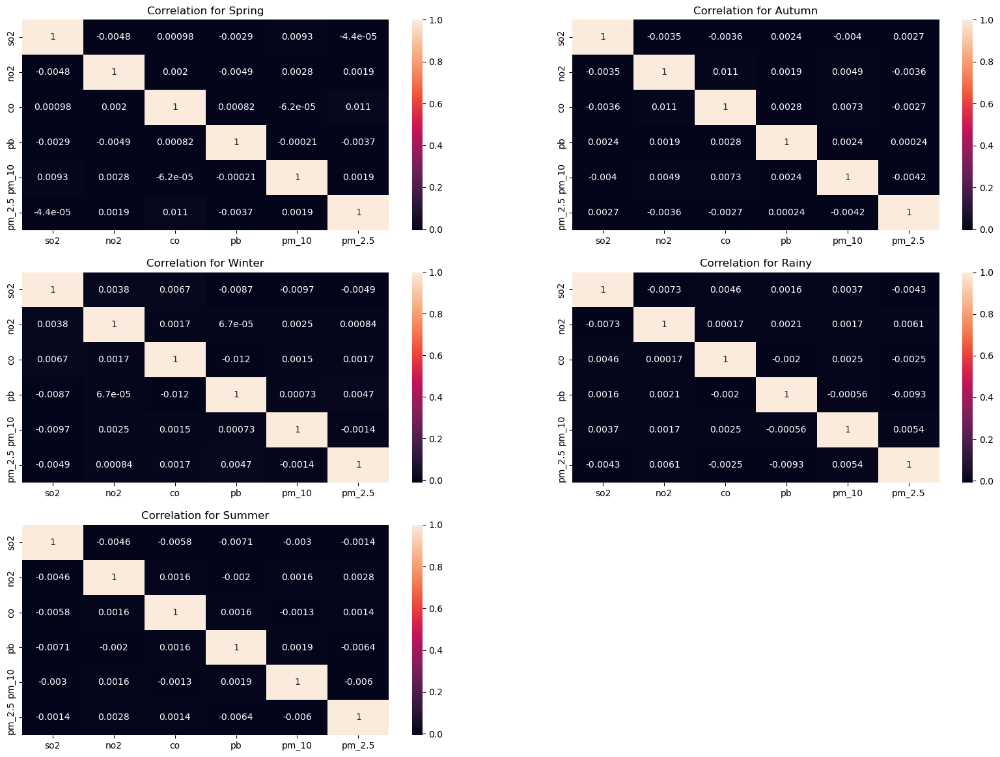

In [453]:
# What is the correlation among different pollution levels in different seasons

clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']
st=df['Seasons'].unique().tolist()

plt.figure(figsize=(20,100))
for i in range(len(st)):
    s_u=df[df['Seasons']==st[i]]
    plt.subplot(20,2,i+1)
    corr=s_u[clm].corr()
    sb.heatmap(corr,annot=True)
    plt.title(f'Correlation for {st[i]}')

plt.show()

In [454]:
# Which state has the most and least  air pollution levels (co) over time

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    yt_n= yt.groupby(['state'])['co'].mean().reset_index()

    yt_mx=yt_n['co'].max()
    ind_mx=yt_n[yt_n['co'] == yt_mx].index

    yt_mn=yt_n['co'].min()
    ind_mn=yt_n[yt_n['co'] == yt_mn].index

    print(f'For year {i}')
    print('Maximum => ')
    print('State/UT: ',yt_n['state'][ind_mx].values)
    print('co: ',yt_mx )
    print('Minimum => ')
    print('State/UT: ',yt_n['state'][ind_mn].values)
    print('co: ',yt_mn )
    print('\n')

For year 2024
Maximum => 
State/UT:  ['Punjab']
co:  202.50125253549695
Minimum => 
State/UT:  ['West Bengal']
co:  197.19377710539587


For year 2023
Maximum => 
State/UT:  ['West Bengal']
co:  202.0035814889336
Minimum => 
State/UT:  ['Karnataka']
co:  196.09219171243134


For year 2022
Maximum => 
State/UT:  ['Delhi']
co:  207.05678936605318
Minimum => 
State/UT:  ['Uttar Pradesh']
co:  198.1901429275505


For year 2021
Maximum => 
State/UT:  ['Rajasthan']
co:  201.3026712328767
Minimum => 
State/UT:  ['West Bengal']
co:  197.05039342629482


For year 2020
Maximum => 
State/UT:  ['Tamil Nadu']
co:  203.2192668621701
Minimum => 
State/UT:  ['Rajasthan']
co:  196.2793545028631


For year 2019
Maximum => 
State/UT:  ['Tamil Nadu']
co:  204.66456194919647
Minimum => 
State/UT:  ['Delhi']
co:  197.40708951651507


For year 2018
Maximum => 
State/UT:  ['West Bengal']
co:  203.7642410932162
Minimum => 
State/UT:  ['Madhya Pradesh']
co:  196.70739213806328


For year 2017
Maximum => 
State/

In [455]:
# How does the pollution type (PM 10) vary between locations

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    yt_n= yt.groupby(['location','state'])['pm_10'].mean().reset_index()

    yt_mx=yt_n['pm_10'].max()
    ind_mx=yt_n[yt_n['pm_10'] == yt_mx].index

    yt_mn=yt_n['pm_10'].min()
    ind_mn=yt_n[yt_n['pm_10'] == yt_mn].index

    print(f'For year {i}')
    print('Maximum => ')
    print('State/UT: ',yt_n['state'][ind_mx].values[0])
    print('Location: ',yt_n['location'][ind_mx].values[0])
    print('PM 10: ',yt_mx )
    print('Minimum => ')
    print('State/UT: ',yt_n['state'][ind_mn].values[0])
    print('Location: ',yt_n['location'][ind_mn].values[0])
    print('PM 10: ',yt_mn )
    print('Difference:',yt_mx-yt_mn)
    print('\n')


For year 2024
Maximum => 
State/UT:  Delhi
Location:  Dwarka
PM 10:  222.64459375
Minimum => 
State/UT:  Uttar Pradesh
Location:  Varanasi
PM 10:  210.0359292035398
Difference: 12.608664546460204


For year 2023
Maximum => 
State/UT:  Gujarat
Location:  Vadodara
PM 10:  223.94441221374046
Minimum => 
State/UT:  Tamil Nadu
Location:  Madurai
PM 10:  204.11653225806452
Difference: 19.82787995567594


For year 2022
Maximum => 
State/UT:  Delhi
Location:  New Delhi
PM 10:  222.12120060790272
Minimum => 
State/UT:  Rajasthan
Location:  Jaipur
PM 10:  205.82646884272998
Difference: 16.29473176517274


For year 2021
Maximum => 
State/UT:  Gujarat
Location:  Surat
PM 10:  223.32282477341388
Minimum => 
State/UT:  Delhi
Location:  Dwarka
PM 10:  204.33056634304205
Difference: 18.992258430371834


For year 2020
Maximum => 
State/UT:  Delhi
Location:  Dwarka
PM 10:  224.48883792048932
Minimum => 
State/UT:  West Bengal
Location:  Kolkata
PM 10:  207.2900152905199
Difference: 17.198822629969413




In [456]:
# What are the top 3 cleanest locations in terms of average PM2.5 levels?

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    yt_n= yt.groupby(['location','state'])['pm_2.5'].mean().reset_index()

    yt_mn=yt_n.sort_values(['pm_2.5'])

    print(f'For year {i} , Location with minimum PM 2.5 is:')
    print(yt_mn[:3])
    print('\n')


For year 2024 , Location with minimum PM 2.5 is:
     location           state      pm_2.5
12     Jaipur       Rajasthan  121.594172
3      Bhopal  Madhya Pradesh  122.236984
0   Ahmedabad         Gujarat  122.439971


For year 2023 , Location with minimum PM 2.5 is:
    location      state      pm_2.5
28  Vadodara    Gujarat  117.954168
26     Surat    Gujarat  118.564888
27   Udaipur  Rajasthan  120.984204


For year 2022 , Location with minimum PM 2.5 is:
     location       state      pm_2.5
28   Vadodara     Gujarat  120.253673
23  New Delhi       Delhi  120.464818
4     Chennai  Tamil Nadu  120.631020


For year 2021 , Location with minimum PM 2.5 is:
   location           state      pm_2.5
8   Gwalior  Madhya Pradesh  119.583397
11   Indore  Madhya Pradesh  119.772512
7    Dwarka           Delhi  120.229531


For year 2020 , Location with minimum PM 2.5 is:
    location        state      pm_2.5
10     Hubli    Karnataka  115.315899
6   Durgapur  West Bengal  118.049190
12    Jai

In [457]:
# Which states have the highest variation in pollution

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    yt_n= yt.groupby(['state'])[clm].mean()

    print(f'For year {i}')
    y_st=yt_n.sort_values(by=clm,ascending=False)
    print('State =>   ',y_st.index[0])
    print(y_st.iloc[0])
    print('\n')



For year 2024
State =>    Maharashtra
so2       825.957550
no2       200.378288
co        201.004596
pb          1.996826
pm_10     214.153578
pm_2.5    125.487036
Name: Maharashtra, dtype: float64


For year 2023
State =>    Punjab
so2       812.358935
no2       199.347048
co        200.169950
pb          2.004774
pm_10     214.498492
pm_2.5    128.026779
Name: Punjab, dtype: float64


For year 2022
State =>    Gujarat
so2       819.444290
no2       198.577374
co        200.760044
pb          2.030005
pm_10     211.084119
pm_2.5    125.007404
Name: Gujarat, dtype: float64


For year 2021
State =>    Rajasthan
so2       814.941908
no2       198.143787
co        201.302671
pb          2.024609
pm_10     213.143870
pm_2.5    125.666115
Name: Rajasthan, dtype: float64


For year 2020
State =>    Uttar Pradesh
so2       809.797607
no2       196.074156
co        201.006846
pb          2.007365
pm_10     215.622363
pm_2.5    123.604207
Name: Uttar Pradesh, dtype: float64


For year 2019
Stat

In [463]:
# How does pollution (pb) compare between capital cities (Delhi) and other state

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    yt_n= yt.groupby(['state'])['pb'].mean()

    print(f'For year {i}')
    yt_s=yt_n['Delhi']-yt_n
    yts=yt_s.sort_values(ascending=False)
    print(yts)
    print('\n')



For year 2024
state
Gujarat           0.082994
West Bengal       0.066813
Tamil Nadu        0.041787
Madhya Pradesh    0.025719
Rajasthan         0.025304
Maharashtra       0.024358
Uttar Pradesh     0.021313
Punjab            0.017914
Delhi             0.000000
Karnataka        -0.026803
Name: pb, dtype: float64


For year 2023
state
Tamil Nadu        0.066519
Gujarat           0.042805
Karnataka         0.035812
West Bengal       0.033450
Punjab            0.020669
Maharashtra       0.017500
Rajasthan         0.017336
Delhi             0.000000
Madhya Pradesh   -0.008937
Uttar Pradesh    -0.046782
Name: pb, dtype: float64


For year 2022
state
Delhi             0.000000
Karnataka        -0.008529
Rajasthan        -0.013248
Tamil Nadu       -0.019855
Madhya Pradesh   -0.022788
Uttar Pradesh    -0.024545
Punjab           -0.024958
West Bengal      -0.026927
Maharashtra      -0.044501
Gujarat          -0.060864
Name: pb, dtype: float64


For year 2021
state
Karnataka         0.008872
Ut

In [468]:
# What are the top polluted regions for each specific pollutant

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    yt_s=yt.groupby('region')[clm].mean()
    yts=yt_s.sort_values(by=clm,ascending=False)
    print(f'For year {i}')
    print('Region =>  ',yts.index[0])
    print(yts.iloc[0])
    print('\n')


For year 2024
Region =>   West
so2       810.085504
no2       198.304567
co        201.029552
pb          1.977455
pm_10     215.757115
pm_2.5    125.779306
Name: West, dtype: float64


For year 2023
Region =>   North
so2       799.115752
no2       201.000264
co        198.546758
pb          2.034043
pm_10     215.432283
pm_2.5    125.365025
Name: North, dtype: float64


For year 2022
Region =>   West
so2       805.859721
no2       199.106206
co        201.713422
pb          2.009086
pm_10     212.997069
pm_2.5    124.263710
Name: West, dtype: float64


For year 2021
Region =>   East
so2       807.822465
no2       199.721514
co        197.050393
pb          2.037296
pm_10     214.560951
pm_2.5    124.454238
Name: East, dtype: float64


For year 2020
Region =>   East
so2       808.630010
no2       200.772398
co        197.187671
pb          1.957324
pm_10     210.511887
pm_2.5    123.206708
Name: East, dtype: float64


For year 2019
Region =>   West
so2       797.997410
no2       199.58

In [469]:
# . How does pollution in industrial zones compare to sensitive zones

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    ia=df[(df['Year']==i)&(df['type']=='Industrial Area')].groupby(['type'])['so2'].mean()
    ra=df[(df['Year']==i)&(df['type']=='Sensitive Area')].groupby(['type'])['so2'].mean()

    print(f'For year {i}')
    print('Industrial Area: ',ia.values)
    print('Sensitive Area: ',ra.values)
    print('Diff: ',ia.values-ra.values)
    print('')


For year 2024
Industrial Area:  [798.06573944]
Sensitive Area:  [799.17504178]
Diff:  [-1.10930234]

For year 2023
Industrial Area:  [792.84860844]
Sensitive Area:  [810.33705339]
Diff:  [-17.48844495]

For year 2022
Industrial Area:  [800.24846719]
Sensitive Area:  [796.36228672]
Diff:  [3.88618047]

For year 2021
Industrial Area:  [805.38900805]
Sensitive Area:  [780.278221]
Diff:  [25.11078705]

For year 2020
Industrial Area:  [791.42721918]
Sensitive Area:  [807.81762848]
Diff:  [-16.3904093]

For year 2019
Industrial Area:  [791.13267624]
Sensitive Area:  [793.75017215]
Diff:  [-2.61749591]

For year 2018
Industrial Area:  [801.18914343]
Sensitive Area:  [794.2934029]
Diff:  [6.89574054]

For year 2017
Industrial Area:  [795.00946627]
Sensitive Area:  [801.13312484]
Diff:  [-6.12365858]

For year 2016
Industrial Area:  [794.44010767]
Sensitive Area:  [822.11837139]
Diff:  [-27.67826372]

For year 2015
Industrial Area:  [792.093246]
Sensitive Area:  [797.5039995]
Diff:  [-5.4107535

In [470]:
# How do pollution levels (NO2) compare between summer vs. winter season in different year

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    ia=df[(df['Year']==i)&(df['Seasons']=='Winter')].groupby(['Seasons'])['no2'].mean()
    ra=df[(df['Year']==i)&(df['Seasons']=='Rainy')].groupby(['Seasons'])['no2'].mean()

    print(f'For State {i}')
    print('Winter Season: ',ia.values)
    print('Summer Season: ',ra.values)
    print('Diff: ',ia.values-ra.values)
    print('')



For State 2024
Winter Season:  [200.82145557]
Summer Season:  [202.58725855]
Diff:  [-1.76580298]

For State 2023
Winter Season:  [202.2135388]
Summer Season:  [203.42563548]
Diff:  [-1.21209667]

For State 2022
Winter Season:  [200.77885877]
Summer Season:  [202.03225144]
Diff:  [-1.25339267]

For State 2021
Winter Season:  [199.6680141]
Summer Season:  [197.43108092]
Diff:  [2.23693318]

For State 2020
Winter Season:  [199.55613993]
Summer Season:  [201.59517857]
Diff:  [-2.03903864]

For State 2019
Winter Season:  [199.50092571]
Summer Season:  [203.42068561]
Diff:  [-3.9197599]

For State 2018
Winter Season:  [199.73648896]
Summer Season:  [198.49893056]
Diff:  [1.2375584]

For State 2017
Winter Season:  [201.0822915]
Summer Season:  [200.08067058]
Diff:  [1.00162092]

For State 2016
Winter Season:  [199.37060544]
Summer Season:  [200.59516408]
Diff:  [-1.22455864]

For State 2015
Winter Season:  [200.43597559]
Summer Season:  [202.46455971]
Diff:  [-2.02858413]



In [471]:
# Are there states where pollution levels (co) are consistently abovw the national average?

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    yt_s=yt.groupby(['state'])['co'].mean()
    print(f'For year {i}')
    yts= yt_s[yt_s.mean()<yt_s]
    print('National co level: ',yt_s.mean())
    print(yts)
    print('\n')


For year 2024
National co level:  199.99407677667384
state
Gujarat        200.755691
Karnataka      202.345097
Maharashtra    201.004596
Punjab         202.501253
Rajasthan      201.319027
Tamil Nadu     200.067802
Name: co, dtype: float64


For year 2023
National co level:  199.12534266091455
state
Maharashtra    199.165979
Punjab         200.169950
Rajasthan      200.781475
Tamil Nadu     200.595700
West Bengal    202.003581
Name: co, dtype: float64


For year 2022
National co level:  201.0835585056629
state
Delhi          207.056789
Karnataka      201.145483
Maharashtra    202.990405
Rajasthan      201.374910
Name: co, dtype: float64


For year 2021
National co level:  199.1659117834485
state
Delhi             200.238228
Gujarat           200.939716
Madhya Pradesh    200.212322
Maharashtra       199.782232
Rajasthan         201.302671
Name: co, dtype: float64


For year 2020
National co level:  200.2281924506587
state
Karnataka         201.565383
Madhya Pradesh    200.458770
Maharas

#### 3. Pollutant-Specific Analysis

In [473]:
# What is the trend of SO2 levels in the past 6 years

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:6]

for i in yr:
    yt=df[df['Year']==i]
    print(f'For year {i}')
    print('Max SO2:',yt['so2'].max() )
    print('Min SO2:',yt['so2'].min() )
    print('Diff:',yt['so2'].max()-yt['so2'].min())
    print('\n')


For year 2024
Max SO2: 1599.99
Min SO2: 0.21
Diff: 1599.78


For year 2023
Max SO2: 1599.9
Min SO2: 0.28
Diff: 1599.6200000000001


For year 2022
Max SO2: 1599.84
Min SO2: 0.02
Diff: 1599.82


For year 2021
Max SO2: 1599.99
Min SO2: 0.21
Diff: 1599.78


For year 2020
Max SO2: 1599.64
Min SO2: 0.01
Diff: 1599.63


For year 2019
Max SO2: 1599.97
Min SO2: 0.11
Diff: 1599.8600000000001




In [474]:
# Which zone(statewise) has shown the most drastic increase of PM 2.5 over time

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state','type'])['pm_2.5'].mean().reset_index()

    y_mx=y_st['pm_2.5'].max()
    ind_mx=y_st[y_st['pm_2.5']==y_mx].index

    print('Zone: ',y_st['type'][ind_mx].values.tolist())
    print('State: ',y_st['state'][ind_mx].values[0])
    print('PM 2.5 level: ',y_mx)
    print('\n')



Zone:  ['Rural and other Areas']
State:  Karnataka
PM 2.5 level:  129.10396524486572


Zone:  ['Industrial Area']
State:  Punjab
PM 2.5 level:  132.59466947960618


Zone:  ['Sensitive Area']
State:  Madhya Pradesh
PM 2.5 level:  129.42497841726617


Zone:  ['Residential']
State:  Rajasthan
PM 2.5 level:  129.2957756232687


Zone:  ['Sensitive Area']
State:  Tamil Nadu
PM 2.5 level:  131.7461266568483


Zone:  ['Industrial Area']
State:  Punjab
PM 2.5 level:  131.89624810892587


Zone:  ['Residential']
State:  Maharashtra
PM 2.5 level:  129.76624441132637


Zone:  ['Rural and other Areas']
State:  Rajasthan
PM 2.5 level:  131.65144736842106


Zone:  ['Industrial Area']
State:  Maharashtra
PM 2.5 level:  129.61380530973452


Zone:  ['Sensitive Area']
State:  Uttar Pradesh
PM 2.5 level:  129.24547286821706




In [475]:
# Which state is the biggest contributor to overall air quality deterioration?

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state'])[clm].mean().reset_index()
    print(f'For year {i}')
    yst=y_st.sort_values(by=clm,ascending=False)
    print(yst.iloc[0])
    print('\n')


For year 2024
state     Maharashtra
so2         825.95755
no2        200.378288
co         201.004596
pb           1.996826
pm_10      214.153578
pm_2.5     125.487036
Name: 4, dtype: object


For year 2023
state         Punjab
so2       812.358935
no2       199.347048
co         200.16995
pb          2.004774
pm_10     214.498492
pm_2.5    128.026779
Name: 5, dtype: object


For year 2022
state        Gujarat
so2        819.44429
no2       198.577374
co        200.760044
pb          2.030005
pm_10     211.084119
pm_2.5    125.007404
Name: 1, dtype: object


For year 2021
state      Rajasthan
so2       814.941908
no2       198.143787
co        201.302671
pb          2.024609
pm_10      213.14387
pm_2.5    125.666115
Name: 6, dtype: object


For year 2020
state     Uttar Pradesh
so2          809.797607
no2          196.074156
co           201.006846
pb             2.007365
pm_10        215.622363
pm_2.5       123.604207
Name: 8, dtype: object


For year 2019
state     Maharashtra
so2   

In [476]:
# How does NO2 concentration vary across different seasons of the year regionwise

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=pd.pivot_table(data=yt,columns='Seasons',index='region',
                        values='no2',aggfunc='mean')
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
Seasons      Autumn       Rainy      Spring      Summer      Winter
region                                                             
East     204.055139  204.005174  199.700864  204.952234  200.070842
North    210.591058  206.097077  203.446798  196.831313  203.462381
South    202.132817  196.688892  200.159603  199.159573  197.958031
West     201.139258  201.231228  197.684408  194.007040  199.218638


For year 2023
Seasons      Autumn       Rainy      Spring      Summer      Winter
region                                                             
East     209.987086  206.886377  197.903143  200.883758  202.273068
North    203.204530  201.935679  198.774186  200.910934  200.571204
South    204.700166  205.547019  198.334766  205.004006  206.398739
West     202.694096  202.763224  201.296366  202.139050  201.604026


For year 2022
Seasons      Autumn       Rainy      Spring      Summer      Winter
region                                                             
Ea

In [477]:
# What is the minimal pollutant value accross different region

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=pd.pivot_table(data=yt,index='region',
                        values=clm,aggfunc='min')
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
          co   no2   pb  pm_10  pm_2.5   so2
region                                      
East    0.26  0.00  0.0   0.66    0.46  0.24
North   0.01  0.01  0.0   0.09    0.03  0.21
South   0.13  0.04  0.0   0.23    0.08  0.26
West    0.05  0.04  0.0   0.00    0.05  0.22


For year 2023
          co   no2   pb  pm_10  pm_2.5   so2
region                                      
East    0.15  0.18  0.0   0.11    0.03  0.76
North   0.07  0.04  0.0   0.11    0.01  0.36
South   0.15  0.32  0.0   0.42    0.01  0.28
West    0.06  0.02  0.0   0.03    0.04  0.39


For year 2022
          co   no2   pb  pm_10  pm_2.5   so2
region                                      
East    0.02  0.14  0.0   0.09    0.12  0.62
North   0.24  0.02  0.0   0.05    0.04  0.33
South   0.12  0.13  0.0   0.05    0.13  0.62
West    0.09  0.04  0.0   0.05    0.03  0.02


For year 2021
          co   no2   pb  pm_10  pm_2.5   so2
region                                      
East    0.10  0.19  0.0   0.10    0.07

In [478]:
# How do (SO2 & NO2),(pb & co),(PM 10 & PM 2.5) levels correlate with each other?

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    crr_sn=yt[['so2','no2']].corr()
    crr_sr=yt[['pb','co']].corr()
    crr_pm=yt[['pm_10','pm_2.5']].corr()
    print(f'For year {i}')
    print('Corr for (SO2 & NO2): \n',crr_sn)
    print('Corr for (pb & co): \n',crr_sr)
    print('Corr for (PM 10 & PM ): \n',crr_pm)
    print('\n')



For year 2024
Corr for (SO2 & NO2): 
           so2       no2
so2  1.000000 -0.004625
no2 -0.004625  1.000000
Corr for (pb & co): 
           pb        co
pb  1.000000 -0.002961
co -0.002961  1.000000
Corr for (PM 10 & PM ): 
            pm_10    pm_2.5
pm_10   1.000000 -0.008867
pm_2.5 -0.008867  1.000000


For year 2023
Corr for (SO2 & NO2): 
           so2       no2
so2  1.000000  0.000621
no2  0.000621  1.000000
Corr for (pb & co): 
           pb        co
pb  1.000000  0.000803
co  0.000803  1.000000
Corr for (PM 10 & PM ): 
            pm_10    pm_2.5
pm_10   1.000000  0.000975
pm_2.5  0.000975  1.000000


For year 2022
Corr for (SO2 & NO2): 
           so2       no2
so2  1.000000 -0.007175
no2 -0.007175  1.000000
Corr for (pb & co): 
           pb        co
pb  1.000000  0.000703
co  0.000703  1.000000
Corr for (PM 10 & PM ): 
            pm_10    pm_2.5
pm_10   1.000000 -0.002604
pm_2.5 -0.002604  1.000000


For year 2021
Corr for (SO2 & NO2): 
           so2       no2
so2  1.0

In [479]:
# How does PM2.5 compare to PM10 in different location and which is maximum

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state','location'])[['pm_10','pm_2.5']].mean().reset_index()

    print(f'For year {i}')
    yst=y_st.sort_values(['pm_10','pm_2.5'],ascending=False)
    print(yst.max())
    print('\n')

For year 2024
state       West Bengal
location       Varanasi
pm_10        222.644594
pm_2.5       131.566524
dtype: object


For year 2023
state       West Bengal
location       Varanasi
pm_10        223.944412
pm_2.5       132.594669
dtype: object


For year 2022
state       West Bengal
location       Varanasi
pm_10        222.121201
pm_2.5       129.535267
dtype: object


For year 2021
state       West Bengal
location       Varanasi
pm_10        223.322825
pm_2.5       129.295776
dtype: object


For year 2020
state       West Bengal
location       Varanasi
pm_10        224.488838
pm_2.5       131.746127
dtype: object


For year 2019
state       West Bengal
location       Varanasi
pm_10        225.476405
pm_2.5       133.403151
dtype: object


For year 2018
state       West Bengal
location       Varanasi
pm_10        227.245658
pm_2.5       129.766244
dtype: object


For year 2017
state       West Bengal
location       Varanasi
pm_10         226.50389
pm_2.5       131.651447
dtype: o

In [480]:
# What is the zonewise maximum recorded value for SO2 pollutant, in which state

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state','type'])['so2'].mean().reset_index()

    y_mx=y_st['so2'].max()
    ind_mx=y_st[y_st['so2']==y_mx].index

    print(f'For year {i}')
    print('Zone: ',y_st['type'][ind_mx].values.tolist())
    print('State: ',y_st['state'][ind_mx].values.tolist()[0])
    print('PM 2.5 level: ',y_mx)
    print('\n')



For year 2024
Zone:  ['Residential']
State:  Maharashtra
PM 2.5 level:  866.2753731343283


For year 2023
Zone:  ['Sensitive Area']
State:  Maharashtra
PM 2.5 level:  825.587496229261


For year 2022
Zone:  ['Residential']
State:  Uttar Pradesh
PM 2.5 level:  849.9412802275959


For year 2021
Zone:  ['Industrial Area']
State:  Punjab
PM 2.5 level:  819.4706493506494


For year 2020
Zone:  ['Sensitive Area']
State:  Uttar Pradesh
PM 2.5 level:  822.0373363774734


For year 2019
Zone:  ['Sensitive Area']
State:  Maharashtra
PM 2.5 level:  828.135977917981


For year 2018
Zone:  ['Industrial Area']
State:  Maharashtra
PM 2.5 level:  851.9265490797546


For year 2017
Zone:  ['Residential']
State:  Rajasthan
PM 2.5 level:  831.5017618270799


For year 2016
Zone:  ['Sensitive Area']
State:  Gujarat
PM 2.5 level:  839.8403062787136


For year 2015
Zone:  ['RIRUO']
State:  Rajasthan
PM 2.5 level:  818.316065318818




In [481]:
# Which state peaks in Autumn compared to Spring for pb

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    wn=yt[(yt['Year']==i)&(yt['Seasons']=='Autumn')].groupby(['state'])['pb'].mean().reset_index()
    sm=yt[(yt['Year']==i)&(yt['Seasons']=='Spring')].groupby(['state'])['pb'].mean().reset_index()

    wn_mx=wn['pb'].max()
    ind_wnmx=wn[wn['pb']==wn_mx].index

    sm_mx=sm['pb'].max()
    ind_smmx=sm[sm['pb']==sm_mx].index

    print(f'For years {i}')

    print('In Autumn => ')
    print('State: ',y_st['state'][ind_wnmx].values.tolist()[0])
    print('pb level: ',wn_mx)

    print('In Spring => ')
    print('State: ',y_st['state'][ind_smmx].values.tolist()[0])
    print('pb level: ',sm_mx)

    print('\n')



For years 2024
In Autumn => 
State:  Karnataka
pb level:  2.106141975308642
In Spring => 
State:  Karnataka
pb level:  2.1154687500000002


For years 2023
In Autumn => 
State:  Delhi
pb level:  2.094586894586895
In Spring => 
State:  Gujarat
pb level:  2.0932537313432835


For years 2022
In Autumn => 
State:  Madhya Pradesh
pb level:  2.061898016997167
In Spring => 
State:  Madhya Pradesh
pb level:  2.0922289156626506


For years 2021
In Autumn => 
State:  Karnataka
pb level:  2.09707100591716
In Spring => 
State:  Maharashtra
pb level:  2.0833734939759037


For years 2020
In Autumn => 
State:  Delhi
pb level:  2.075786350148368
In Spring => 
State:  Madhya Pradesh
pb level:  2.112936046511628


For years 2019
In Autumn => 
State:  Karnataka
pb level:  2.0946246246246245
In Spring => 
State:  Delhi
pb level:  2.142789317507418


For years 2018
In Autumn => 
State:  Karnataka
pb level:  2.1289490445859873
In Spring => 
State:  Gujarat
pb level:  2.1455029585798817


For years 2017
In Au

In [482]:
# What is the minimum (PM10,PM2.5) and (pb,co) levels ( state and seasonwise)

yr=list(df['Year'].unique())
yr.sort(reverse=True)
cl=['pm_10','pm_2.5','pb','co']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state','Seasons'])[cl].mean().reset_index().min()

    print(f'For year {i}')
    print(y_st)
    print('\n')



For year 2024
state           Delhi
Seasons        Autumn
pm_10      202.081384
pm_2.5     114.503224
pb            1.87677
co         188.069492
dtype: object


For year 2023
state           Delhi
Seasons        Autumn
pm_10      203.056718
pm_2.5     115.624735
pb           1.861006
co         187.594012
dtype: object


For year 2022
state           Delhi
Seasons        Autumn
pm_10      196.931111
pm_2.5         117.98
pb           1.856166
co         182.894901
dtype: object


For year 2021
state           Delhi
Seasons        Autumn
pm_10      195.966606
pm_2.5     116.173816
pb           1.881158
co         184.623918
dtype: object


For year 2020
state           Delhi
Seasons        Autumn
pm_10      202.882733
pm_2.5     115.661761
pb               1.88
co         190.203864
dtype: object


For year 2019
state           Delhi
Seasons        Autumn
pm_10      199.115284
pm_2.5     116.546593
pb           1.891857
co         190.811267
dtype: object


For year 2018
state         

In [483]:
# How do PM2.5 and PM10 levels change zonewise before and after a major rainfall event

yr=list(df['Year'].unique())
yr.sort(reverse=True)
cl=['pm_10','pm_2.5','pb','co']

for i in yr:
    yt=df[df['Year']==i]
    ss=df[(df['Seasons']=='Spring')|(df['Seasons']=='Summer')].groupby('type')[['pm_2.5','pm_10']].mean()
    aw=df[(df['Seasons']=='Autumn')|(df['Seasons']=='Winter')].groupby('type')[['pm_2.5','pm_10']].mean()

    print(f'For years {i}')
    print('Pre Rainy Day: \n',ss,'\n')
    print('Post Rainy Day: \n',aw)
    print('\n')

For years 2024
Pre Rainy Day: 
                            pm_2.5       pm_10
type                                         
Industrial Area        124.759611  215.406123
RIRUO                  124.203355  214.224612
Residential            125.308414  214.586517
Rural and other Areas  125.840171  215.422762
Sensitive Area         124.758372  214.600301 

Post Rainy Day: 
                            pm_2.5       pm_10
type                                         
Industrial Area        125.299977  215.690614
RIRUO                  123.244531  213.829803
Residential            124.462214  215.448219
Rural and other Areas  126.369721  215.737112
Sensitive Area         124.243033  215.568226


For years 2023
Pre Rainy Day: 
                            pm_2.5       pm_10
type                                         
Industrial Area        124.759611  215.406123
RIRUO                  124.203355  214.224612
Residential            125.308414  214.586517
Rural and other Areas  125.840171  215.4

In [484]:
# Which Quarter show a drastic increase of pollution level , along with region

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    qr=pd.pivot_table(data=yt,index=['region','Qtr'],values=clm,aggfunc='mean').reset_index()
    print(f'For year {i}')
    print(qr.max())
    print('\n')



For year 2024
region          West
Qtr            Qtr 4
co        205.853921
no2       208.812417
pb          2.040609
pm_10     224.568541
pm_2.5    130.851051
so2       825.265005
dtype: object


For year 2023
region          West
Qtr            Qtr 4
co        208.003512
no2         210.7748
pb          2.118393
pm_10     220.820958
pm_2.5    130.413636
so2       815.239953
dtype: object


For year 2022
region          West
Qtr            Qtr 4
co        205.859625
no2       207.814172
pb           2.05815
pm_10     220.574677
pm_2.5    129.434576
so2       819.232669
dtype: object


For year 2021
region          West
Qtr            Qtr 4
co        203.004311
no2       207.667558
pb          2.060038
pm_10     220.862107
pm_2.5    130.951913
so2       825.044245
dtype: object


For year 2020
region          West
Qtr            Qtr 4
co        204.552979
no2       207.059979
pb          2.097129
pm_10     219.677325
pm_2.5    128.407947
so2       860.599788
dtype: object


For year 2

In [485]:
# How does air pollution vary near industrial zones vs. non industrial zone, Quarterwise

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    i_st=yt[(yt['Year']==i)&(yt['type']=='Industrial Area')]
    ni_st=yt[(yt['Year']==i)&(yt['type']!='Industrial Area')]

    print(f'For Year {i}')
    print('Industrial Area => ')
    print(i_st[clm].mean(),'\n')
    print('Industrial Area => ')
    print(ni_st[clm].mean())
    print('\n')


For Year 2024
Industrial Area => 
so2       798.065739
no2       200.597006
co        198.719616
pb          1.967788
pm_10     214.017046
pm_2.5    126.845756
dtype: float64 

Industrial Area => 
so2       803.257234
no2       201.116642
co        200.436011
pb          2.002775
pm_10     215.868770
pm_2.5    125.486666
dtype: float64


For Year 2023
Industrial Area => 
so2       792.848608
no2       201.023433
co        198.100616
pb          2.022890
pm_10     214.851347
pm_2.5    125.146862
dtype: float64 

Industrial Area => 
so2       800.331786
no2       202.651542
co        199.502611
pb          2.001898
pm_10     215.736114
pm_2.5    124.795913
dtype: float64


For Year 2022
Industrial Area => 
so2       800.248467
no2       197.693222
co        199.583736
pb          1.999541
pm_10     212.681468
pm_2.5    126.067885
dtype: float64 

Industrial Area => 
so2       801.807000
no2       201.980516
co        201.622622
pb          1.991960
pm_10     215.815989
pm_2.5    124.1845

In [486]:
# Which state is responsible for the highest air quality index

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby('state')[clm].mean().reset_index().min()
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
state          Delhi
so2       781.834544
no2       194.964028
co        197.193777
pb          1.938191
pm_10     212.130588
pm_2.5    123.600283
dtype: object


For year 2023
state          Delhi
so2       786.400704
no2       198.958566
co        196.092192
pb          1.958924
pm_10     212.729793
pm_2.5    121.104016
dtype: object


For year 2022
state          Delhi
so2       783.639109
no2       196.580976
co        198.190143
pb          1.969141
pm_10     211.084119
pm_2.5    122.915486
dtype: object


For year 2021
state          Delhi
so2       785.256856
no2       198.019786
co        197.050393
pb          1.981351
pm_10     209.541061
pm_2.5    121.393587
dtype: object


For year 2020
state          Delhi
so2       782.132942
no2       196.074156
co        196.279355
pb          1.957324
pm_10     210.511887
pm_2.5    121.102582
dtype: object


For year 2019
state          Delhi
so2       768.903416
no2       196.436558
co         197.40709
pb          1.959

In [487]:
# How does air pollution (pb and co) behave during spring and autumn season

yr=list(df['Year'].unique())
yr.sort(reverse=True)
cl=['pm_10','pm_2.5','pb','co']

for i in yr:
    yt=df[df['Year']==i]
    ss=df[(df['Seasons']=='Spring')].groupby('type')[['pb','co']].mean()
    aw=df[(df['Seasons']=='Autumn')].groupby('type')[['pb','co']].mean()

    print(f'For years {i}')
    print('In Spring: \n',ss,'\n')
    print('In Autumn: \n',aw)
    print('\n')

For years 2024
In Spring: 
                              pb          co
type                                       
Industrial Area        2.009984  197.469617
RIRUO                  2.050219  200.972850
Residential            2.008907  200.306443
Rural and other Areas  1.996570  200.738412
Sensitive Area         1.977649  201.043329 

In Autumn: 
                              pb          co
type                                       
Industrial Area        1.992405  199.426070
RIRUO                  1.992256  200.003058
Residential            2.017701  201.699436
Rural and other Areas  2.007476  199.576207
Sensitive Area         1.975379  199.498929


For years 2023
In Spring: 
                              pb          co
type                                       
Industrial Area        2.009984  197.469617
RIRUO                  2.050219  200.972850
Residential            2.008907  200.306443
Rural and other Areas  1.996570  200.738412
Sensitive Area         1.977649  201.043329 

I

In [488]:
# Are there locations where  SO2 and NO2 levels are higher (mention its state)

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['location','state'])[['so2','no2']].mean().reset_index().max()
    print(f'For year {i}')
    print(y_st)
    print('\n')



For year 2024
location       Varanasi
state       West Bengal
so2          866.275373
no2          211.041728
dtype: object


For year 2023
location       Varanasi
state       West Bengal
so2          825.587496
no2          210.841108
dtype: object


For year 2022
location       Varanasi
state       West Bengal
so2           849.94128
no2          211.167969
dtype: object


For year 2021
location       Varanasi
state       West Bengal
so2          825.537362
no2          208.464453
dtype: object


For year 2020
location       Varanasi
state       West Bengal
so2          822.037336
no2          208.925787
dtype: object


For year 2019
location       Varanasi
state       West Bengal
so2          828.135978
no2          212.631656
dtype: object


For year 2018
location       Varanasi
state       West Bengal
so2          851.926549
no2          212.545612
dtype: object


For year 2017
location       Varanasi
state       West Bengal
so2          831.501762
no2          207.919591
dtype: o

#### 4. Comparative & Anomaly Detection

In [490]:
#  Which state has shown the biggest improvement in air quality over time

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state'])[clm].mean().reset_index().min()
    print(f'For year {i}')
    print(y_st)
    print('\n')


For year 2024
state          Delhi
so2       781.834544
no2       194.964028
co        197.193777
pb          1.938191
pm_10     212.130588
pm_2.5    123.600283
dtype: object


For year 2023
state          Delhi
so2       786.400704
no2       198.958566
co        196.092192
pb          1.958924
pm_10     212.729793
pm_2.5    121.104016
dtype: object


For year 2022
state          Delhi
so2       783.639109
no2       196.580976
co        198.190143
pb          1.969141
pm_10     211.084119
pm_2.5    122.915486
dtype: object


For year 2021
state          Delhi
so2       785.256856
no2       198.019786
co        197.050393
pb          1.981351
pm_10     209.541061
pm_2.5    121.393587
dtype: object


For year 2020
state          Delhi
so2       782.132942
no2       196.074156
co        196.279355
pb          1.957324
pm_10     210.511887
pm_2.5    121.102582
dtype: object


For year 2019
state          Delhi
so2       768.903416
no2       196.436558
co         197.40709
pb          1.959

In [491]:
# Are pollution levels more stable or erratic across different locations, which one

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['location','state'])[clm].mean().reset_index().min()
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
location     Ahmedabad
state            Delhi
so2         755.751856
no2         190.068968
co            190.2196
pb             1.84324
pm_10       210.035929
pm_2.5      121.594172
dtype: object


For year 2023
location     Ahmedabad
state            Delhi
so2         771.732685
no2         190.116726
co           191.15577
pb            1.914887
pm_10       204.116532
pm_2.5      117.954168
dtype: object


For year 2022
location     Ahmedabad
state            Delhi
so2         763.975504
no2         191.709985
co          192.903026
pb            1.921672
pm_10       205.826469
pm_2.5      120.253673
dtype: object


For year 2021
location     Ahmedabad
state            Delhi
so2         768.777548
no2         192.765306
co          191.010722
pb            1.904774
pm_10       204.330566
pm_2.5      119.583397
dtype: object


For year 2020
location     Ahmedabad
state            Delhi
so2         764.005828
no2         192.026506
co          191.621597
pb            1

In [492]:
# Identify the top 10 highest particle spikes recorded in history , with state

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['location','state'])[clm].mean().reset_index()
    print(f'For year {i}')
    print(y_st.sort_values(by=clm,ascending=False).iloc[:10])
    print('\n')

For year 2024
    location           state         so2         no2          co        pb  \
24      Pune     Maharashtra  866.275373  196.615567  195.773239  2.060090   
28  Vadodara         Gujarat  842.982281  198.104496  194.398628  1.843240   
4    Chennai      Tamil Nadu  840.147764  195.960974  205.982891  1.967157   
22    Nagpur     Maharashtra  822.641160  201.334992  206.215588  2.000718   
21    Mysore       Karnataka  821.639258  196.836998  204.037204  2.071722   
18  Ludhiana          Punjab  820.718238  198.374639  199.881235  2.004639   
8    Gwalior  Madhya Pradesh  818.705613  208.836306  193.837229  1.951025   
17   Lucknow   Uttar Pradesh  817.530417  209.650525  202.915432  2.011991   
7     Dwarka           Delhi  812.757000  202.682391  200.174250  1.967859   
26     Surat         Gujarat  810.204730  190.068968  205.423968  1.992413   

         pm_10      pm_2.5  
24  212.705507  128.682821  
28  215.506116  126.539901  
4   218.732188  122.605272  
22  215.460

In [493]:
# Which State  pollution levels (NO2) exceed mean threshold

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state'])['no2'].mean()
    yst=y_st[y_st>y_st.mean()].sort_values(ascending=False)
    print(f'For year {i}')
    print('Threshold: ',y_st.mean())
    print(yst)
    print('\n')

For year 2024
Threshold:  200.9372711944956
state
Madhya Pradesh    205.936529
Uttar Pradesh     203.985171
Delhi             202.873164
West Bengal       202.658800
Punjab            200.937500
Name: no2, dtype: float64


For year 2023
Threshold:  202.1971026886664
state
Karnataka      208.195721
Rajasthan      203.672076
Maharashtra    203.569782
West Bengal    203.305885
Name: no2, dtype: float64


For year 2022
Threshold:  200.84864854659997
state
Karnataka      205.334552
Tamil Nadu     203.927686
West Bengal    203.110078
Delhi          201.644949
Rajasthan      201.052522
Punjab         200.978879
Name: no2, dtype: float64


For year 2021
Threshold:  200.05435259212658
state
Tamil Nadu        203.953601
Madhya Pradesh    201.023822
Karnataka         200.918679
Punjab            200.639322
Name: no2, dtype: float64


For year 2020
Threshold:  200.07737629778075
state
Delhi          203.757613
Karnataka      202.421641
Tamil Nadu     202.198294
West Bengal    200.772398
Punjab    

In [494]:
# At which month  is the biggest air pollution event recorded

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['Month'])[clm].mean().reset_index().max()
    print(f'For year {i}')
    print(y_st)
    print('\n')


For year 2024
Month      September
so2        825.89644
no2       206.692951
co        204.256276
pb          2.032294
pm_10     220.768638
pm_2.5    129.640185
dtype: object


For year 2023
Month      September
so2       822.698418
no2       206.951706
co        205.180863
pb          2.045124
pm_10     220.058022
pm_2.5    127.443564
dtype: object


For year 2022
Month      September
so2       813.359259
no2       204.117352
co        204.599227
pb           2.02231
pm_10     220.180567
pm_2.5    128.054646
dtype: object


For year 2021
Month      September
so2       805.588224
no2       204.326788
co        208.860847
pb            2.0553
pm_10      218.65199
pm_2.5    127.730287
dtype: object


For year 2020
Month      September
so2       822.925095
no2       203.053417
co        203.712304
pb          2.041282
pm_10     217.344323
pm_2.5     126.19232
dtype: object


For year 2019
Month      September
so2       809.464274
no2       205.257648
co        207.995988
pb          2.036

In [495]:
# Are there days of the year when pollution always peaks

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['Day'])[clm].mean().reset_index().max()
    print(f'For year {i}')
    print(y_st)
    print('\n')


For year 2024
Day        Wednesday
so2       809.551536
no2       204.437894
co        202.239091
pb          2.046863
pm_10     218.243973
pm_2.5    126.804875
dtype: object


For year 2023
Day        Wednesday
so2       812.574406
no2       204.647551
co        202.218872
pb           2.04953
pm_10     218.109108
pm_2.5     129.42156
dtype: object


For year 2022
Day        Wednesday
so2       819.905717
no2       205.005693
co        204.269408
pb          2.026416
pm_10     218.487231
pm_2.5    126.435519
dtype: object


For year 2021
Day        Wednesday
so2       805.059912
no2       201.223687
co        201.962678
pb          2.046072
pm_10     218.210087
pm_2.5    125.779213
dtype: object


For year 2020
Day        Wednesday
so2        803.20779
no2       202.064393
co        203.411903
pb          2.035756
pm_10     216.227434
pm_2.5    126.613811
dtype: object


For year 2019
Day        Wednesday
so2       805.014255
no2       203.728883
co        204.807244
pb          2.040

In [496]:
# Compare min and max air pollution levels (PM 10) between two locations

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['location','state'])[['pm_10','pm_2.5']].mean().reset_index()

    print(f'For year {i}')
    print('Maximum Value =>')
    print(y_st.max(),'\n')
    print('Minimum Value =>')
    print(y_st.min(),'\n')

    print('PM 10 Diff:',y_st.max()['pm_10']-y_st.min()['pm_10'])
    print('PM 2.5 Diff:',y_st.max()['pm_2.5']-y_st.min()['pm_2.5'])
    print('\n')


For year 2024
Maximum Value =>
location       Varanasi
state       West Bengal
pm_10        222.644594
pm_2.5       131.566524
dtype: object 

Minimum Value =>
location     Ahmedabad
state            Delhi
pm_10       210.035929
pm_2.5      121.594172
dtype: object 

PM 10 Diff: 12.608664546460204
PM 2.5 Diff: 9.972352122776812


For year 2023
Maximum Value =>
location       Varanasi
state       West Bengal
pm_10        223.944412
pm_2.5       132.594669
dtype: object 

Minimum Value =>
location     Ahmedabad
state            Delhi
pm_10       204.116532
pm_2.5      117.954168
dtype: object 

PM 10 Diff: 19.82787995567594
PM 2.5 Diff: 14.64050154067489


For year 2022
Maximum Value =>
location       Varanasi
state       West Bengal
pm_10        222.121201
pm_2.5       129.535267
dtype: object 

Minimum Value =>
location     Ahmedabad
state            Delhi
pm_10       205.826469
pm_2.5      120.253673
dtype: object 

PM 10 Diff: 16.29473176517274
PM 2.5 Diff: 9.281593706184779


For ye

In [497]:
# Identify Quarterwise days with low pollution  over the past 5 years

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['Day','Qtr'])[clm].mean().reset_index().min()
    print(f'For year {i}')
    print(y_st)
    print('\n')


For year 2024
Day           Friday
Qtr            Qtr 1
so2       778.790071
no2        193.79433
co        185.863496
pb          1.886574
pm_10      202.66967
pm_2.5    118.771175
dtype: object


For year 2023
Day           Friday
Qtr            Qtr 1
so2       747.770043
no2       194.351803
co        189.436207
pb          1.919155
pm_10      210.29502
pm_2.5    118.575671
dtype: object


For year 2022
Day           Friday
Qtr            Qtr 1
so2       754.570084
no2       190.715644
co        191.078296
pb          1.895252
pm_10     206.708469
pm_2.5    118.031495
dtype: object


For year 2021
Day           Friday
Qtr            Qtr 1
so2       760.707173
no2       194.108126
co        187.161289
pb          1.904169
pm_10     208.951855
pm_2.5    119.775577
dtype: object


For year 2020
Day           Friday
Qtr            Qtr 1
so2       768.128165
no2       188.006187
co        193.685416
pb          1.941089
pm_10     207.424026
pm_2.5    117.447649
dtype: object


For year 2

In [498]:
# Identify states where pollution control measures have worked best

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['state'])[clm].mean().reset_index().min()
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
state          Delhi
so2       781.834544
no2       194.964028
co        197.193777
pb          1.938191
pm_10     212.130588
pm_2.5    123.600283
dtype: object


For year 2023
state          Delhi
so2       786.400704
no2       198.958566
co        196.092192
pb          1.958924
pm_10     212.729793
pm_2.5    121.104016
dtype: object


For year 2022
state          Delhi
so2       783.639109
no2       196.580976
co        198.190143
pb          1.969141
pm_10     211.084119
pm_2.5    122.915486
dtype: object


For year 2021
state          Delhi
so2       785.256856
no2       198.019786
co        197.050393
pb          1.981351
pm_10     209.541061
pm_2.5    121.393587
dtype: object


For year 2020
state          Delhi
so2       782.132942
no2       196.074156
co        196.279355
pb          1.957324
pm_10     210.511887
pm_2.5    121.102582
dtype: object


For year 2019
state          Delhi
so2       768.903416
no2       196.436558
co         197.40709
pb          1.959

In [499]:
# What are the top 3 months with highest pb and co pollution levels every year

yr=list(df['Year'].unique())
yr.sort(reverse=True)

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['Month'])[['pb','co']].mean().reset_index()
    yst=y_st.sort_values(by=['pb','co'],ascending=False)
    print(f'For year {i}')
    print(yst.iloc[:3])
    print('\n')

For year 2024
      Month        pb          co
5      July  2.032294  200.057327
0     April  2.027047  198.269599
10  October  2.021212  203.350456


For year 2023
      Month        pb          co
2  December  2.045124  200.679512
5      July  2.039450  199.738047
7     March  2.033700  205.180863


For year 2022
        Month        pb          co
1      August  2.022310  203.781867
10    October  2.016362  197.799607
11  September  2.013962  197.988281


For year 2021
      Month        pb          co
2  December  2.055300  200.673822
4   January  2.053040  198.605443
8       May  2.041325  198.592054


For year 2020
      Month        pb          co
8       May  2.041282  202.108386
7     March  2.034852  201.482452
2  December  2.024649  201.769311


For year 2019
        Month        pb          co
0       April  2.036326  203.644470
11  September  2.022364  200.020031
5        July  2.016402  201.786617


For year 2018
      Month        pb          co
6      June  2.033975  2

In [500]:
# Identify the 5 least predictable month for pollution trends

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['Month'])[clm].mean().reset_index().min()
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
Month          April
so2       782.756295
no2         195.5462
co        196.338623
pb           1.95605
pm_10     210.869688
pm_2.5    122.167428
dtype: object


For year 2023
Month          April
so2       764.613059
no2       198.125033
co        191.380755
pb          1.945548
pm_10     211.119819
pm_2.5    122.592749
dtype: object


For year 2022
Month          April
so2        778.47194
no2       195.433315
co        196.009344
pb          1.956289
pm_10     209.980446
pm_2.5    121.484051
dtype: object


For year 2021
Month          April
so2        788.44237
no2       195.636239
co        196.455767
pb          1.948739
pm_10     210.228125
pm_2.5    122.259604
dtype: object


For year 2020
Month          April
so2        778.03616
no2       195.608202
co        198.365704
pb            1.9732
pm_10      208.28519
pm_2.5    122.526583
dtype: object


For year 2019
Month          April
so2       770.518731
no2       196.651868
co        198.162568
pb          1.955

In [501]:
# What is the mont pollutant month  in terms of seasonwise and location & statewise

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

for i in yr:
    yt=df[df['Year']==i]
    y_st=yt.groupby(['Month','Seasons','location','state'])[clm].mean().reset_index().max()
    print(f'For year {i}')
    print(y_st)
    print('\n')

For year 2024
Month         September
Seasons          Winter
location       Varanasi
state       West Bengal
so2          981.043617
no2          244.715263
co           251.307826
pb             2.399828
pm_10         265.48375
pm_2.5       149.747021
dtype: object


For year 2023
Month         September
Seasons          Winter
location       Varanasi
state       West Bengal
so2         1009.284615
no2           239.59283
co           245.282642
pb             2.597143
pm_10        271.745263
pm_2.5       158.551569
dtype: object


For year 2022
Month         September
Seasons          Winter
location       Varanasi
state       West Bengal
so2          995.609259
no2          249.548154
co           247.905455
pb             2.397917
pm_10        255.112545
pm_2.5         159.2556
dtype: object


For year 2021
Month         September
Seasons          Winter
location       Varanasi
state       West Bengal
so2          971.138837
no2          247.550385
co           247.340727
pb      

In [502]:
# How do pollution levels compare between COVID vs. open economies

y1=[2018, 2019, 2022, 2023, 2024]
y2=[2020, 2021]
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']


yt1=df[df['Year'].isin(y1)]
yt2=df[df['Year'].isin(y2)]

y1_m=yt1[clm].mean().reset_index()
y2_m=yt2[clm].mean().reset_index()

y1_m.columns=['Pollutant','Covid']
y2_m.columns=['Pollutant','Non_Covid']

mg=pd.merge(y1_m,y2_m,on='Pollutant')
mg['Diff']=mg['Non_Covid']-mg['Covid']
print(mg)

  Pollutant       Covid   Non_Covid      Diff
0       so2  799.050776  796.507014 -2.543762
1       no2  200.719012  200.059600 -0.659412
2        co  200.272884  199.707825 -0.565059
3        pb    2.000119    2.004981  0.004861
4     pm_10  215.569163  214.399470 -1.169694
5    pm_2.5  124.898176  124.438353 -0.459823


### Visual Analysis

#### 1. Time-Series Visualizations

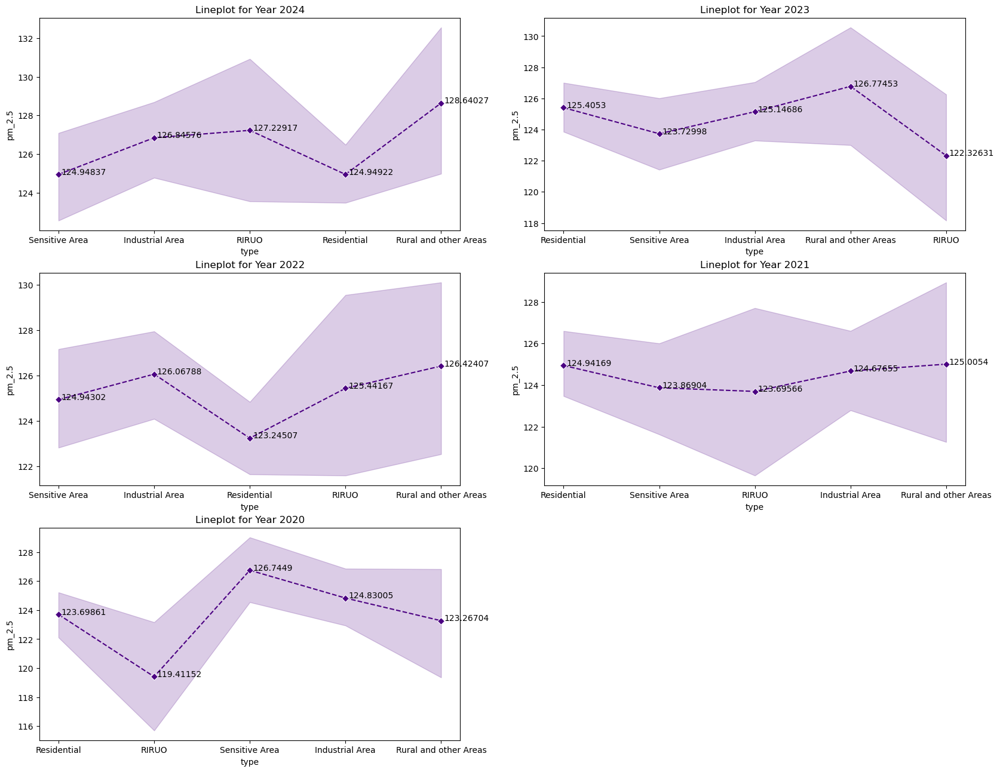

In [505]:
# How do PM2.5 levels vary Zonewise over the last 5 years using a line chart

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:5]

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    cl=sb.lineplot(x=yt['type'],y=yt['pm_2.5'],color='indigo',marker='D',linestyle='--')
    for j in cl.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    plt.title(f'Lineplot for Year {yr[i]}')

plt.show()

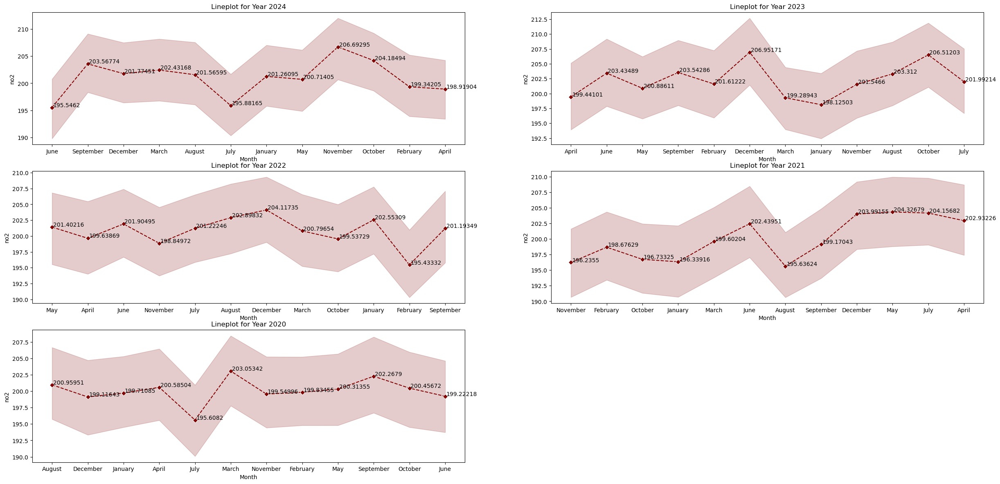

In [506]:
# What is the Monthly trend of NO2 levels over the past 5 years

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:5]

plt.figure(figsize=(30,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    cl=sb.lineplot(x=yt['Month'],y=yt['no2'],color='maroon',marker='D',linestyle='--')
    for j in cl.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b+0.1,round(b,5))
    plt.title(f'Lineplot for Year {yr[i]}')

plt.show()

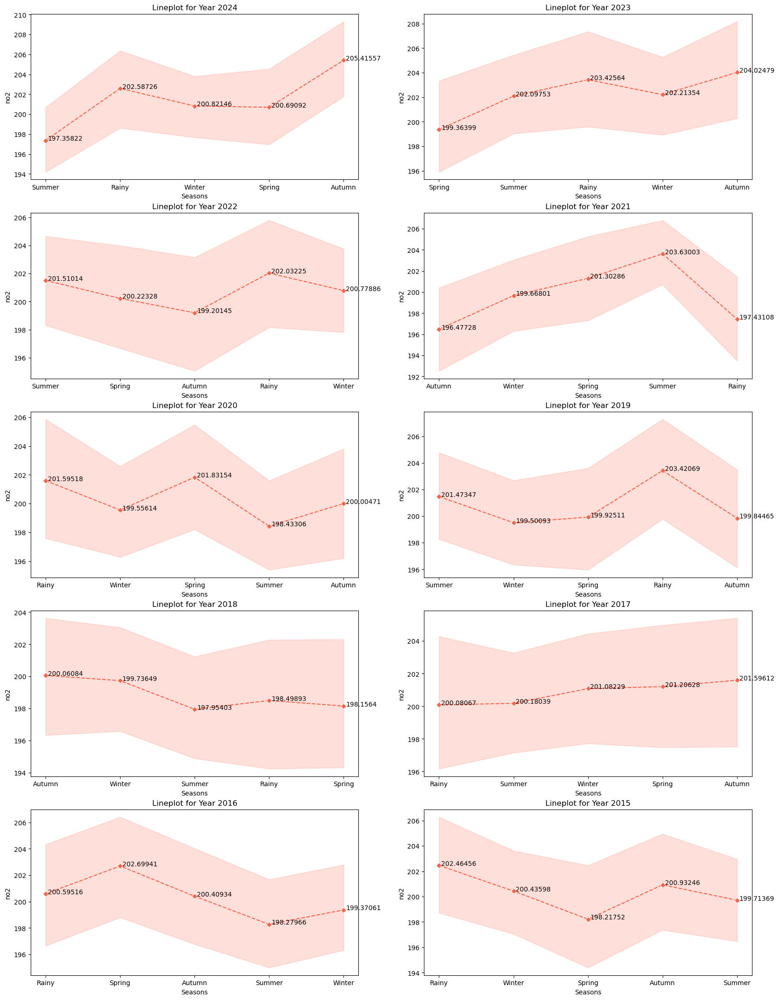

In [507]:
# Show a seasonal trend analysis of PM10 levels across different years

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    cl=sb.lineplot(x=yt['Seasons'],y=yt['no2'],color="#FF6347",marker='D',linestyle='--')
    for j in cl.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    plt.title(f'Lineplot for Year {yr[i]}')


plt.show()

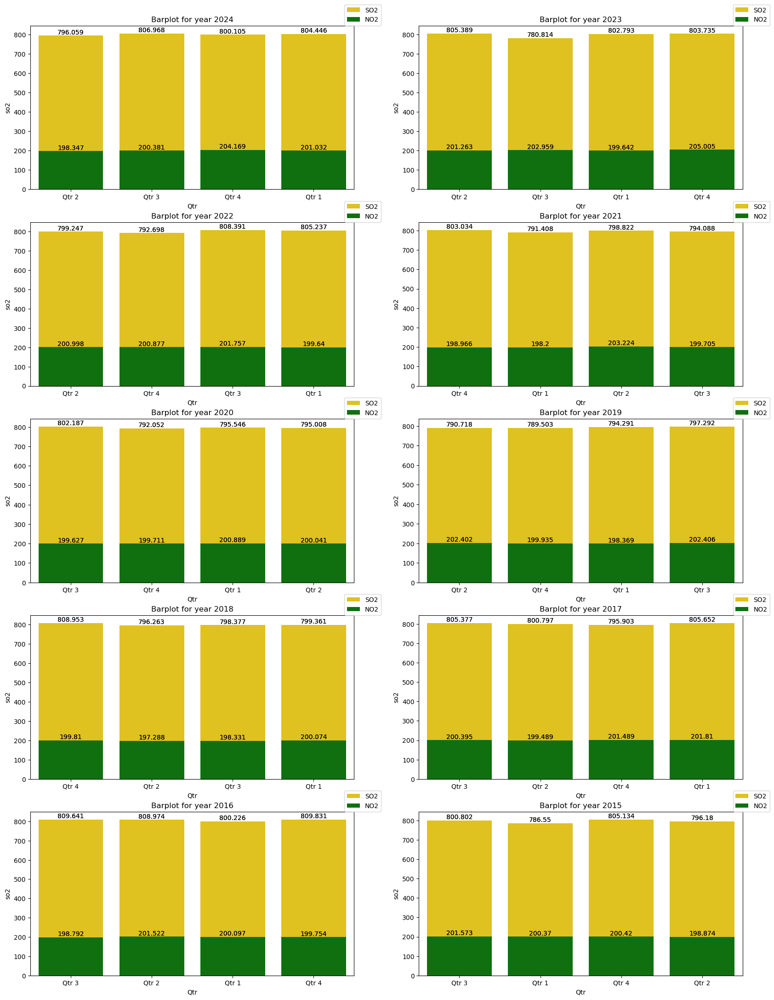

In [508]:
# Compare the quarterly pollution levels of SO2, NO2 using a stacked area chart.

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.barplot(x=yt['Qtr'],y=yt['so2'],color="gold",label='SO2',errorbar=('ci',0))
    c2=sb.barplot(x=yt['Qtr'],y=yt['no2'],color="green",label='NO2',errorbar=('ci',0))

    for j in c1.containers:
        c1.bar_label(j)
    for k in c1.containers:
        c1.bar_label(k)
    plt.title(f'Barplot for year {yr[i]}')
    plt.legend(loc=(0.97,1))

plt.show()


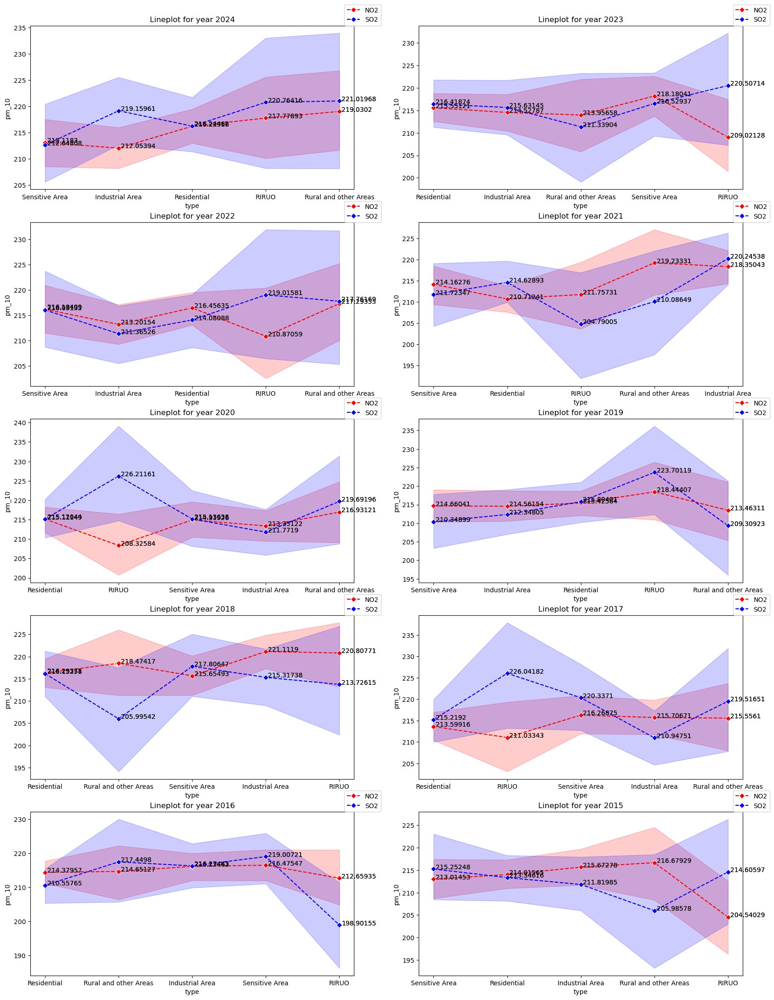

In [509]:
# How does air pollution PM 10 fluctuate on weekdays vs. weekends over time

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    wd=yt[yt['IsWeekend']=='Weekday']
    wk=yt[yt['IsWeekend']!='Weekday']
    c1=sb.lineplot(x=wd['type'],y=wd['pm_10'],color="red",label='NO2',marker='D',linestyle='--')
    c2=sb.lineplot(x=wk['type'],y=wk['pm_10'],color="blue",label='SO2',marker='D',linestyle='--')
    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))

    plt.title(f'Lineplot for year {yr[i]}')
    plt.legend(loc=(0.97,1))



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

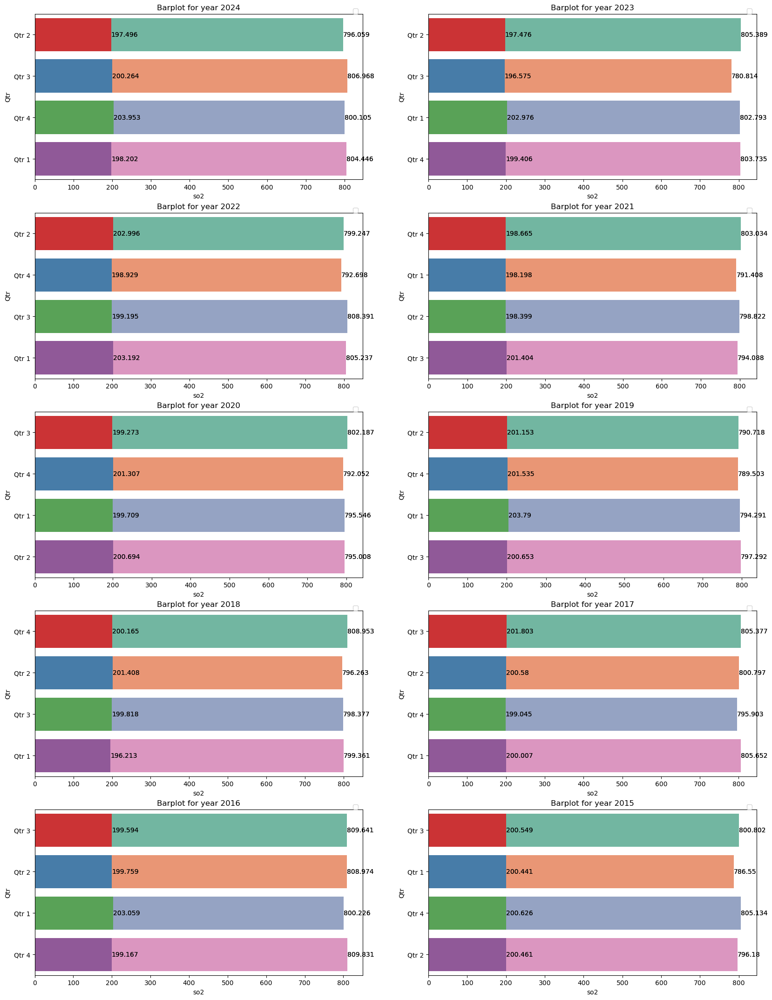

In [510]:
# Which Quarter of the year consistently show the highest Relattion between so2 & co

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.barplot(data=yt,x='so2',y='Qtr',palette='Set2',errorbar=('ci',0))
    c2=sb.barplot(data=yt,x='co',y='Qtr',errorbar=('ci',0),palette='Set1')
    for j in c1.containers:
        c1.bar_label(j)
    for k in c2.containers:
        c2.bar_label(k)

    plt.title(f'Barplot for year {yr[i]}')
    plt.legend(loc=(0.97,1))

plt.show()

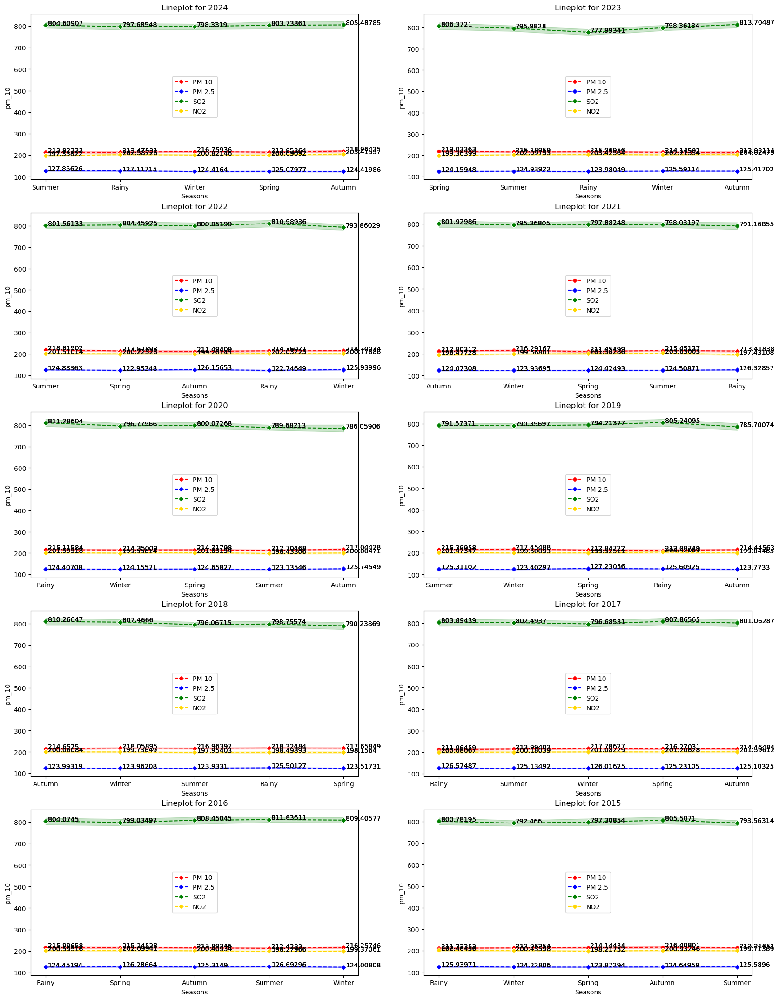

In [511]:
# Plot the yearly average SO2, NO2, PM10, PM 2.5 concentrations to observe long-term trends.

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.lineplot(x=yt['Seasons'],y=yt['pm_10'],color="red",marker='D',linestyle='--',label='PM 10')
    c2=sb.lineplot(x=yt['Seasons'],y=yt['pm_2.5'],color="blue",marker='D',linestyle='--',label='PM 2.5')
    c3=sb.lineplot(x=yt['Seasons'],y=yt['so2'],color="green",marker='D',linestyle='--',label='SO2')
    c4=sb.lineplot(x=yt['Seasons'],y=yt['no2'],color="gold",marker='D',linestyle='--',label='NO2')

    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))
    for l in c3.get_lines():
        for e,f in zip(l.get_xdata(),l.get_ydata()):
            plt.text(e+0.03,f,round(f,5))
    for m in c4.get_lines():
        for g,h in zip(m.get_xdata(),m.get_ydata()):
            plt.text(g+0.03,h,round(h,5))


    plt.title(f'Lineplot for {yr[i]}')
    plt.legend(loc=10)

plt.show()


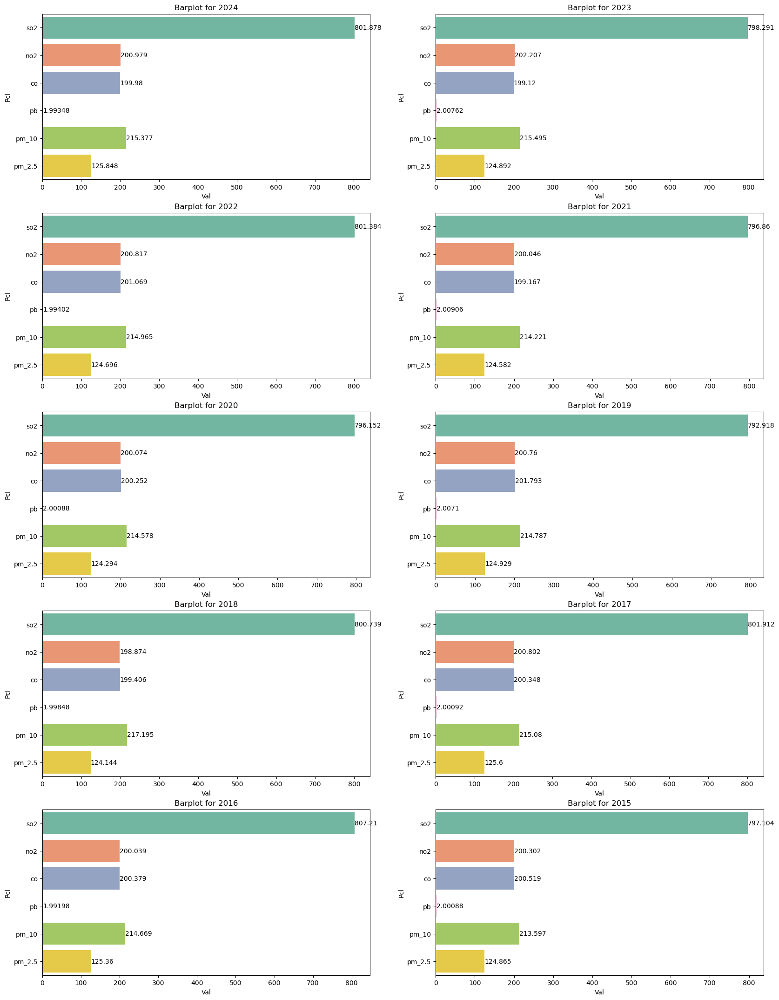

In [512]:
# Identify yearwise sharp increases or decreases in pollution using an visualization.

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    xt=yt[clm].mean().reset_index()
    xt.columns=['Pcl','Val']
    cl=sb.barplot(y=xt['Pcl'],x=xt['Val'],palette='Set2')
    for j in cl.containers:
        cl.bar_label(j)
    plt.title(f'Barplot for {yr[i]}')

plt.show()

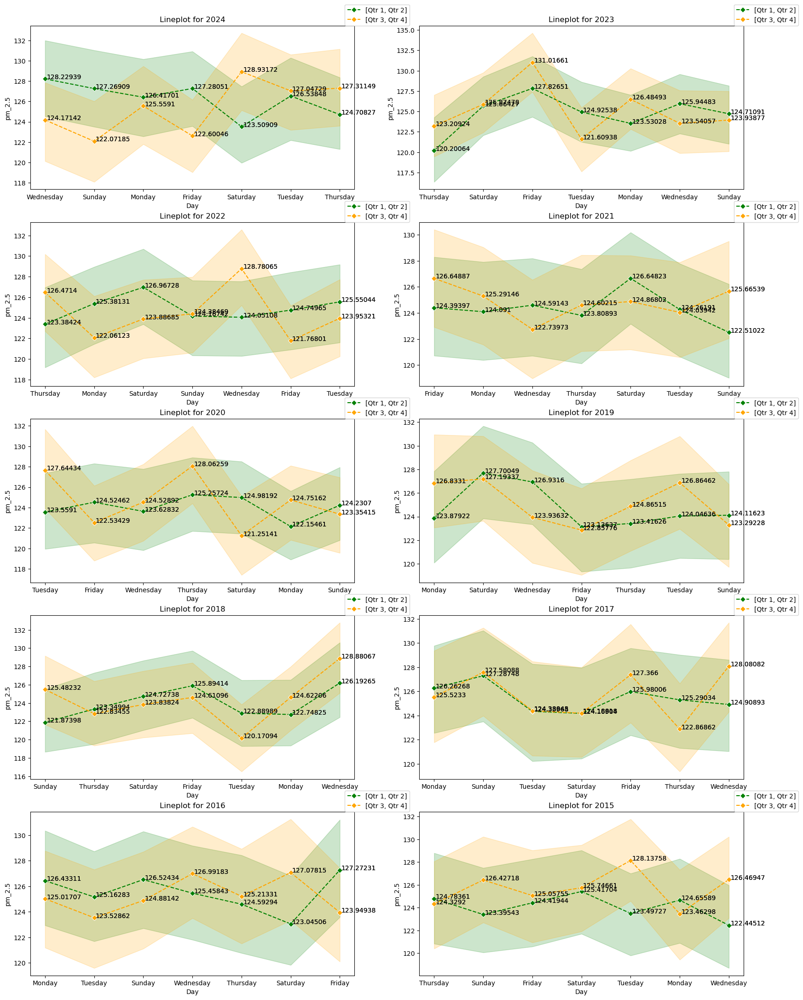

In [513]:
# How does pollution PM 2.5 vary 1st and 2nd half statewise Daywise

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    h1=yt[yt['Qtr'].isin(['Qtr 1','Qtr 2'])]
    h2=yt[yt['Qtr'].isin(['Qtr 3','Qtr 4'])]
    c1=sb.lineplot(x=h1['Day'],y=h1['pm_2.5'],color="green",marker='D',linestyle='--',label='[Qtr 1, Qtr 2]')
    c2=sb.lineplot(x=h2['Day'],y=h2['pm_2.5'],color="orange",marker='D',linestyle='--',label='[Qtr 3, Qtr 4]')

    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))

    plt.title(f'Lineplot for {yr[i]}')
    plt.legend(loc=(0.97,1))

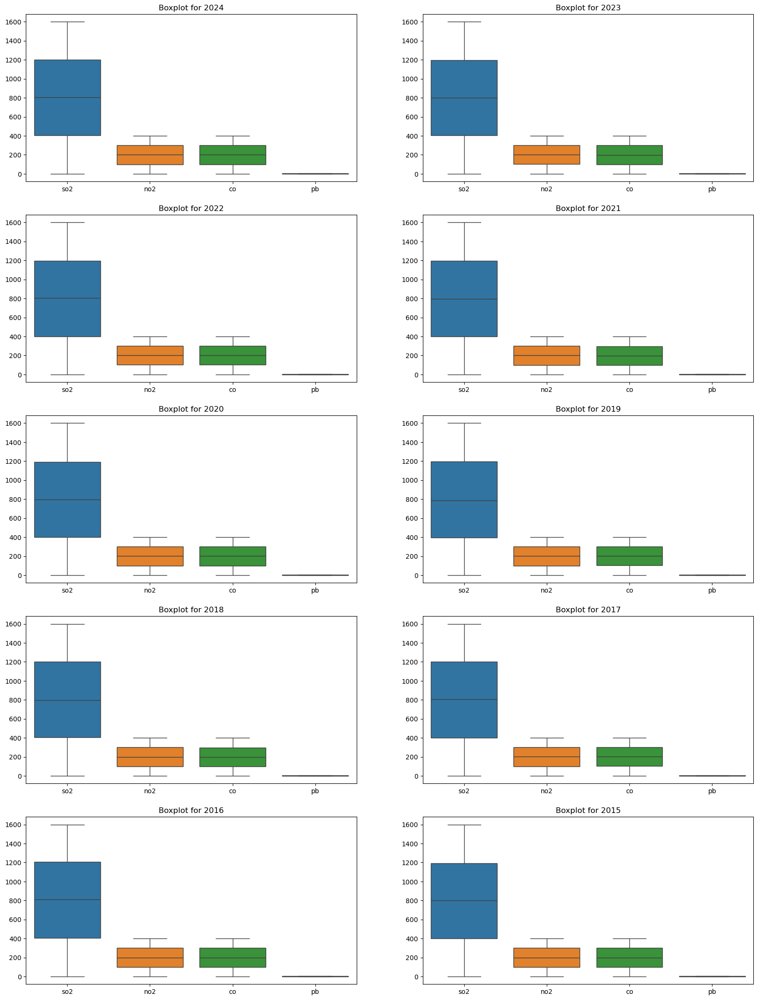

In [514]:
# Show the daily average pollution levels ('so2', 'no2', 'co', 'pb') across an entire year using boxplot.

yr=list(df['Year'].unique())
yr.sort(reverse=True)
cl=['so2', 'no2', 'co', 'pb']

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    sb.boxplot(data=yt[cl])
    plt.title(f'Boxplot for {yr[i]}')

plt.show()

#### 2. Location & State-Based Visualizations

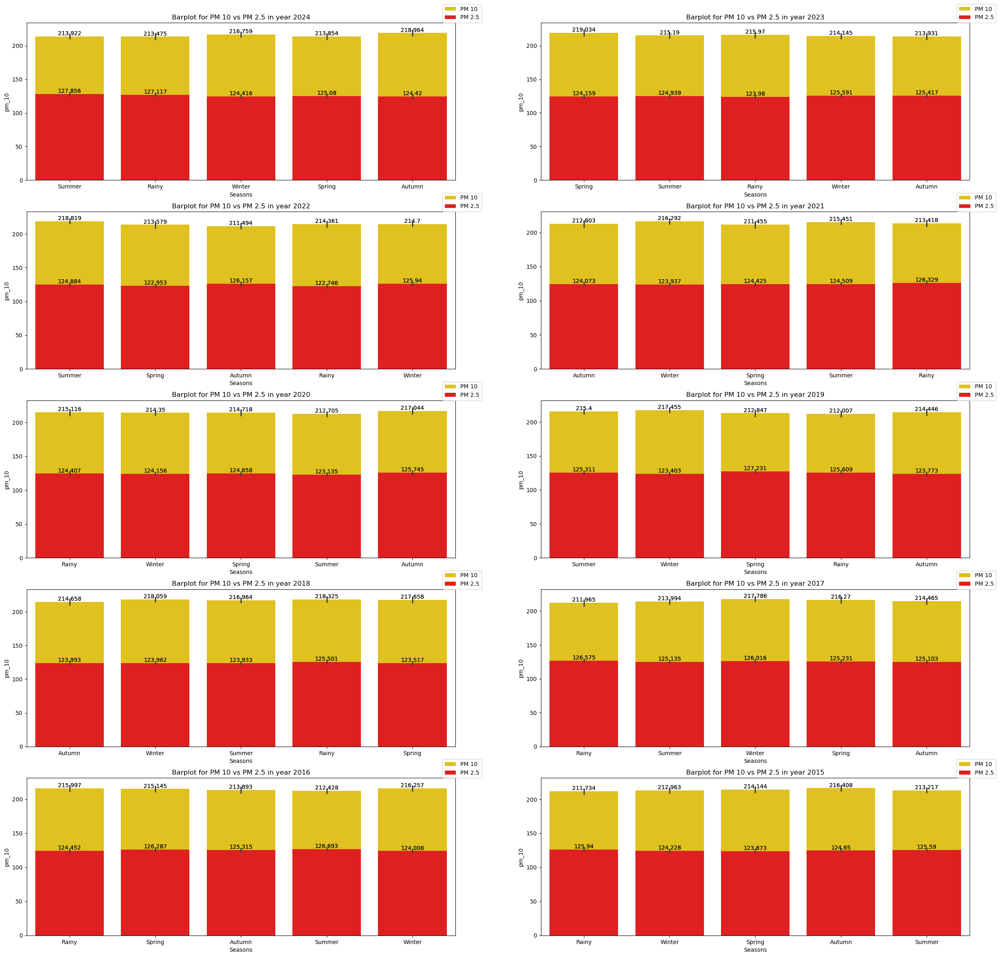

In [516]:
#  seasonwisewise have the  PM 2.5 vs PM 10 levels

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,120))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.barplot(x=yt['Seasons'],y=yt['pm_10'],color="gold",estimator='mean',label='PM 10')
    c2=sb.barplot(x=yt['Seasons'],y=yt['pm_2.5'],color="red",estimator='mean',label='PM 2.5')
    for j in c1.containers:
        c1.bar_label(j)
    for k in c2.containers:
        c2.bar_label(k)
    plt.title(f'Barplot for PM 10 vs PM 2.5 in year {yr[i]}')
    plt.legend(loc=(0.97,1))

plt.show()

Graph 1 : Boxplot for North and West
Graph 2 : Boxplot for South and East


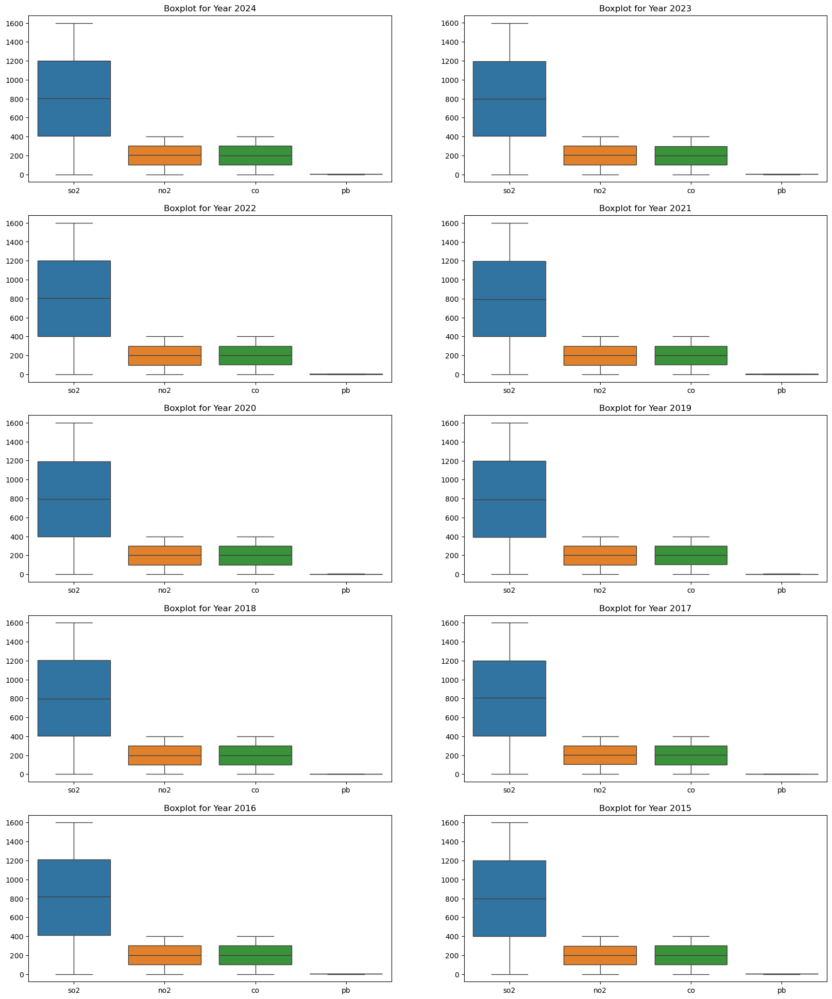

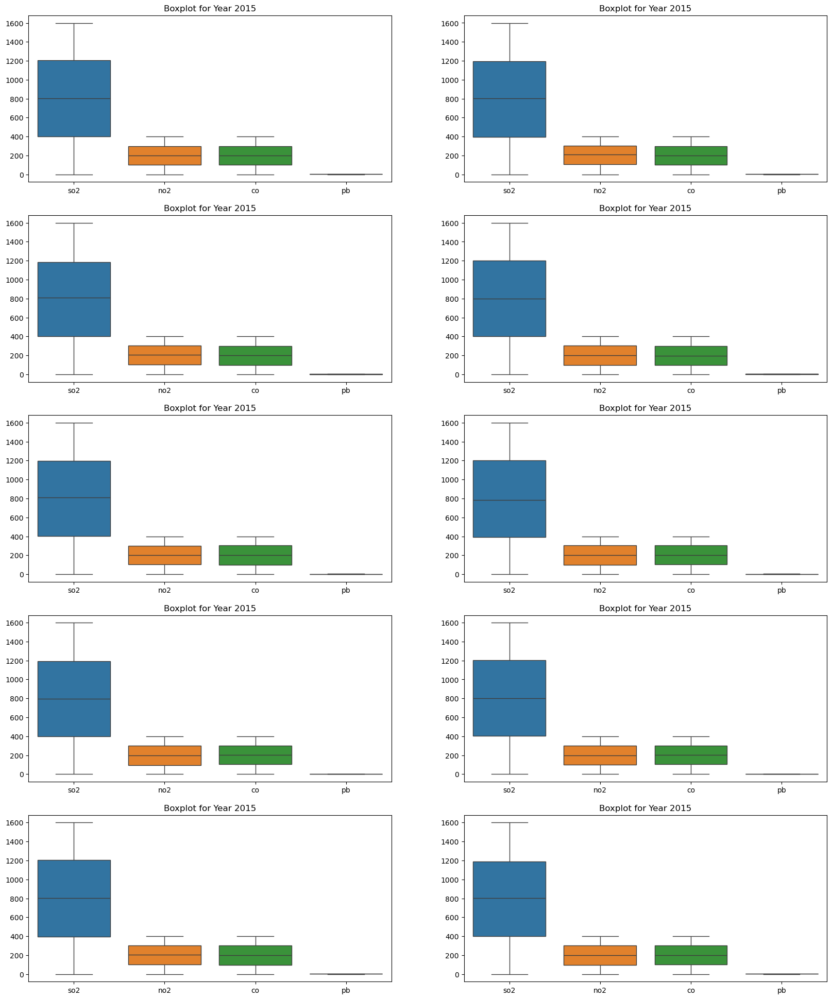

In [517]:
# Compare pollution levels in nort and west vs. south and east  locations using a box plot.

yr=list(df['Year'].unique())
yr.sort(reverse=True)
cl=['so2', 'no2', 'co', 'pb']

print('Graph 1 : Boxplot for North and West')
plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h1=yt[yt['region'].isin(['North', 'West'])]
    plt.subplot(20,2,i+1)
    sb.boxplot(data=h1[cl])
    plt.title(f'Boxplot for Year {yr[i]}')

print('Graph 2 : Boxplot for South and East')
plt.figure(figsize=(20,100))
for j in range(len(yr)):
    yt=df[df['Year']==yr[j]]
    h2=yt[yt['region'].isin(['South', 'East'])]
    plt.subplot(20,2,j+1)
    sb.boxplot(data=h2[cl])
    plt.title(f'Boxplot for Year {yr[i]}')


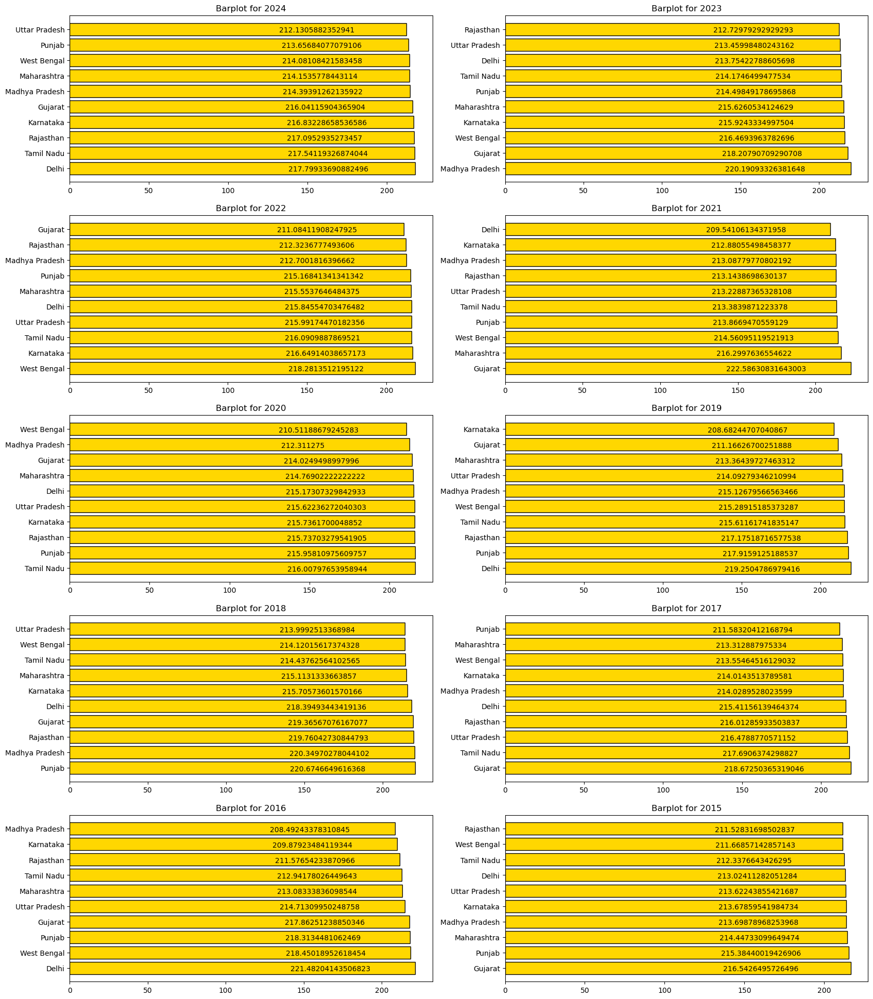

In [518]:
# What are the top 10 most polluted locations in the dataset having High PM 10 ?

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    s=yt.groupby('state')['pm_10'].mean().reset_index()
    st=s.sort_values(by='pm_10',ascending=False).iloc[:10]
    plt.barh(st['state'],st['pm_10'],color='gold',edgecolor='black')
    for j ,k in enumerate(st['pm_10']):
        plt.text(k-80,j-0.2,str(k))

    plt.title(f'Barplot for {yr[i]}')


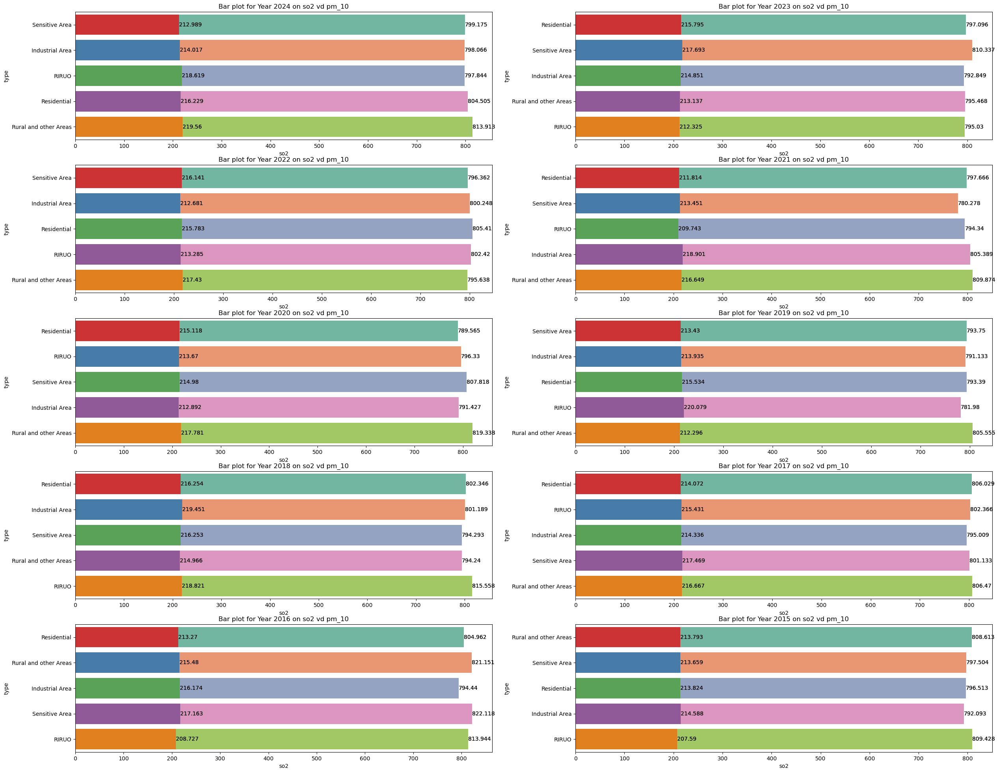

In [519]:
# Visualize relationship b/w pm_10 and co using scatterplot zonewise , along  quarterwisww

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.barplot(data=yt,x='so2',y='type',palette='Set2',errorbar=('ci',0))
    c2=sb.barplot(data=yt,x='pm_10',y='type',errorbar=('ci',0),palette='Set1')
    for j in c1.containers:
        c1.bar_label(j)
    for k in c2.containers:
        c2.bar_label(k)
    plt.title(f'Bar plot for Year {yr[i]} on so2 vd pm_10')
plt.show()


Graph 1: Graph for 1st half (Qtr 1 & Qtr2)
Graph 2: Graph for 2nd half (Qtr 3 & Qtr4)


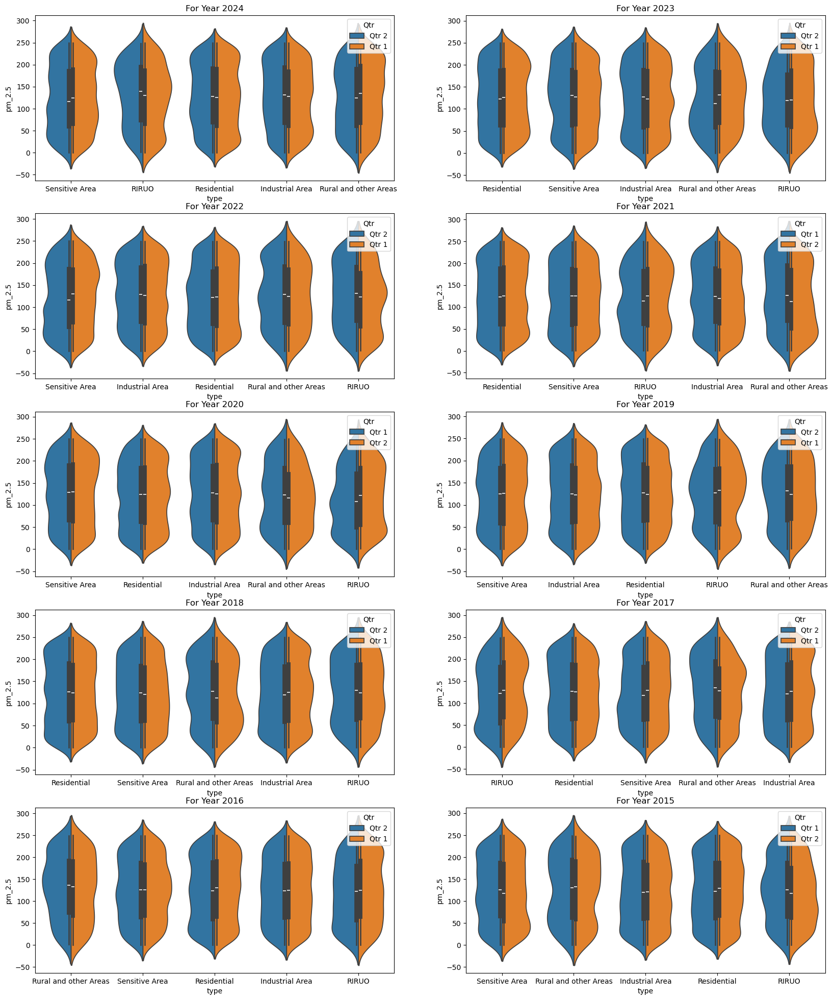

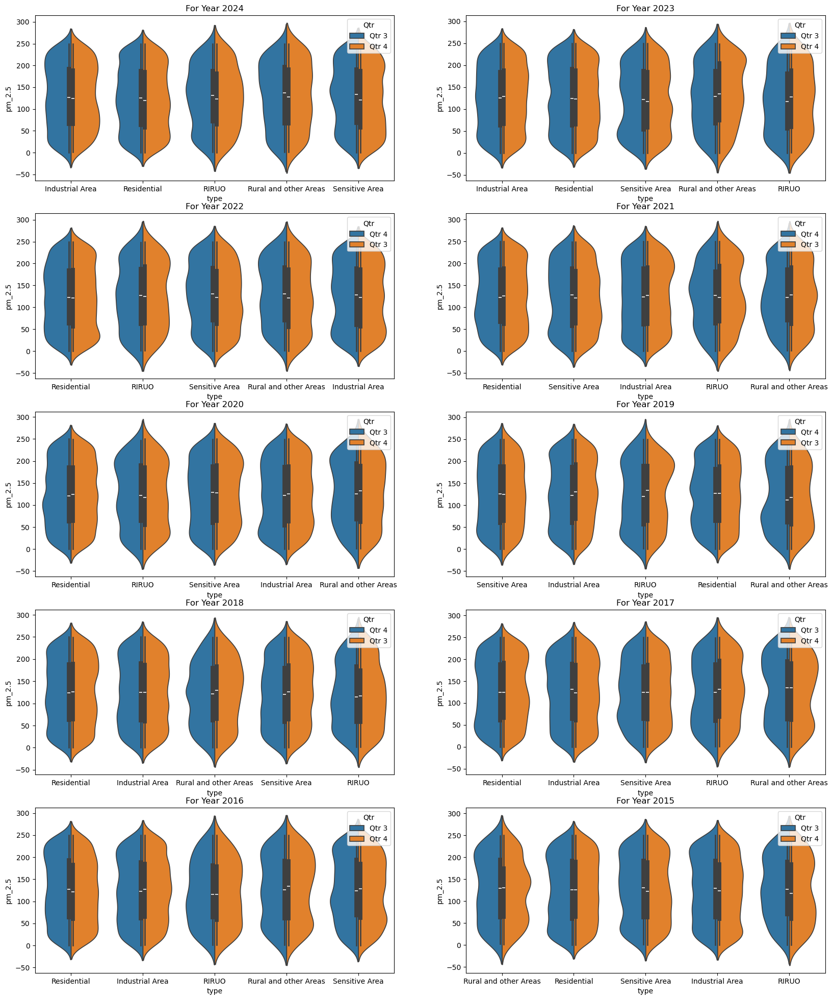

In [520]:
# How do PM 2.5  differ  zonewise across 1st half vs. 2nd half? (Violin Chart)

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Graph 1: Graph for 1st half (Qtr 1 & Qtr2)')
print('Graph 2: Graph for 2nd half (Qtr 3 & Qtr4)')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h1=yt[yt['Qtr'].isin(['Qtr 1','Qtr 2'])]
    plt.subplot(20,2,i+1)
    sb.violinplot(data=h1,x='type',y='pm_2.5',hue='Qtr',split=True)
    plt.title(f'For Year {yr[i]}')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h2=yt[yt['Qtr'].isin(['Qtr 3','Qtr 4'])]
    plt.subplot(20,2,i+1)
    sb.violinplot(data=h2,x='type',y='pm_2.5',hue='Qtr',split=True)
    plt.title(f'For Year {yr[i]}')

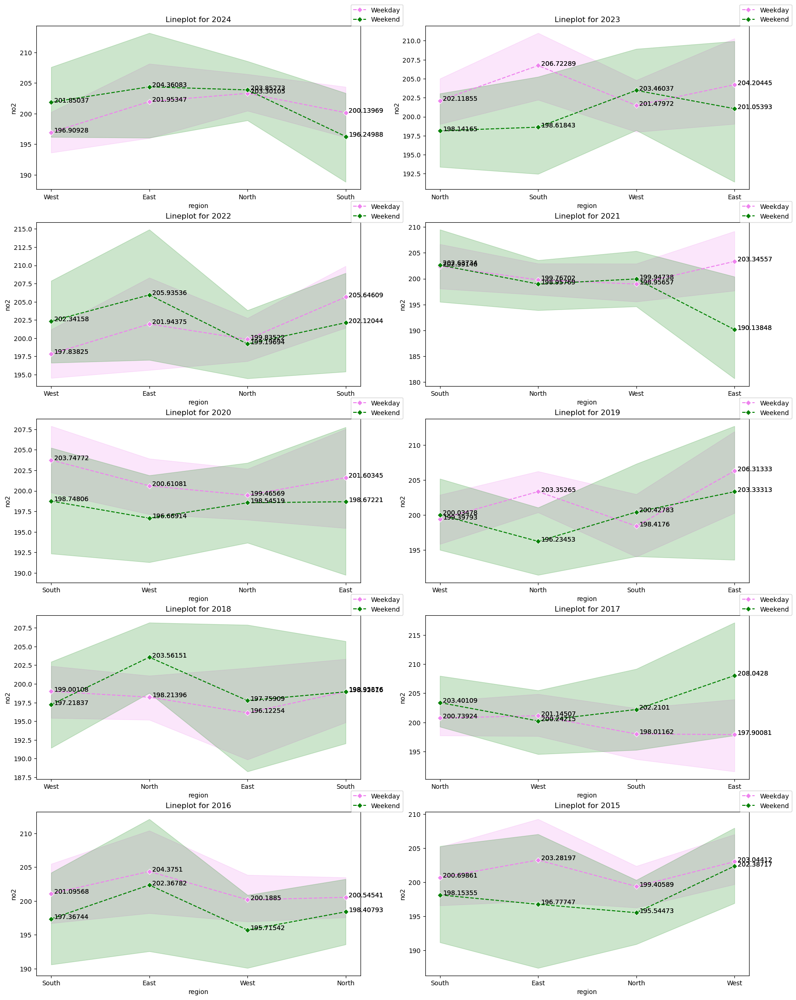

In [521]:
#  Compare the NO2 pollution trends for the regions in weekend and weekdays over time.

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    h1=yt[yt['IsWeekend']=='Weekday']
    h2=yt[yt['IsWeekend']=='Weekend']
    c1=sb.lineplot(x=h1['region'],y=h1['no2'],label='Weekday',color="violet",marker='D',linestyle='--')
    c2=sb.lineplot(x=h2['region'],y=h2['no2'],label='Weekend',color="green",marker='D',linestyle='--')

    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))

    plt.title(f'Lineplot for {yr[i]}')
    plt.legend(loc=(0.97,1))

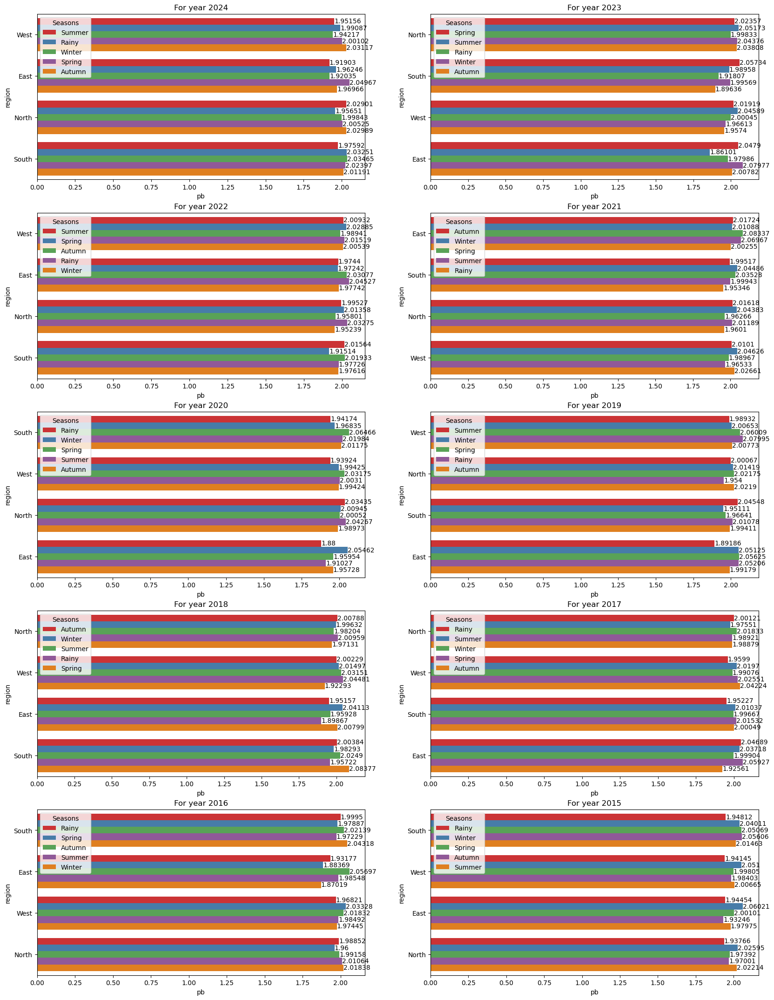

In [522]:
# Which region show the largest seasonal variations in pollution

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    cl=sb.barplot(data=yt,y='region',x='pb',hue='Seasons',errorbar=('ci',0),palette='Set1')
    for j in cl.containers:
        cl.bar_label(j)
    plt.title(f'For year {yr[i]}')

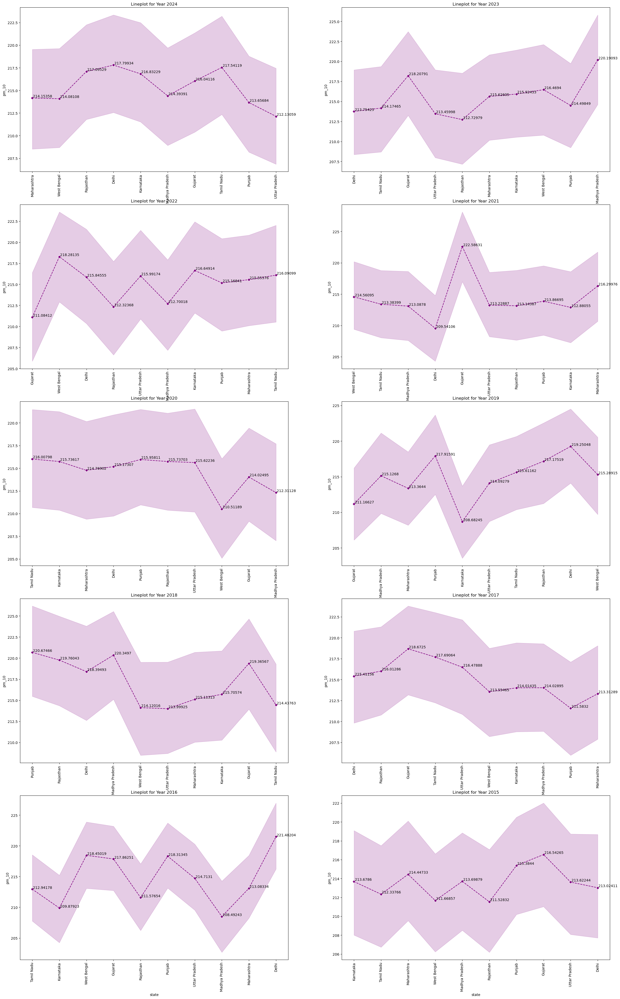

In [523]:
# Use Lineplot to show the distribution of PM 10 contributors across state

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,200))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    cl=sb.lineplot(data=yt,x='state',y='pm_10',marker='D',color='purple',linestyle='--')
    for j in cl.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b+0.1,round(b,5))
    plt.title(f'Lineplot for Year {yr[i]}')
    plt.xticks(rotation=90)

plt.show()


Graph 1: Graph for 1st half (Qtr 1 & Qtr2)
Graph 2: Graph for 2nd half (Qtr 3 & Qtr4)


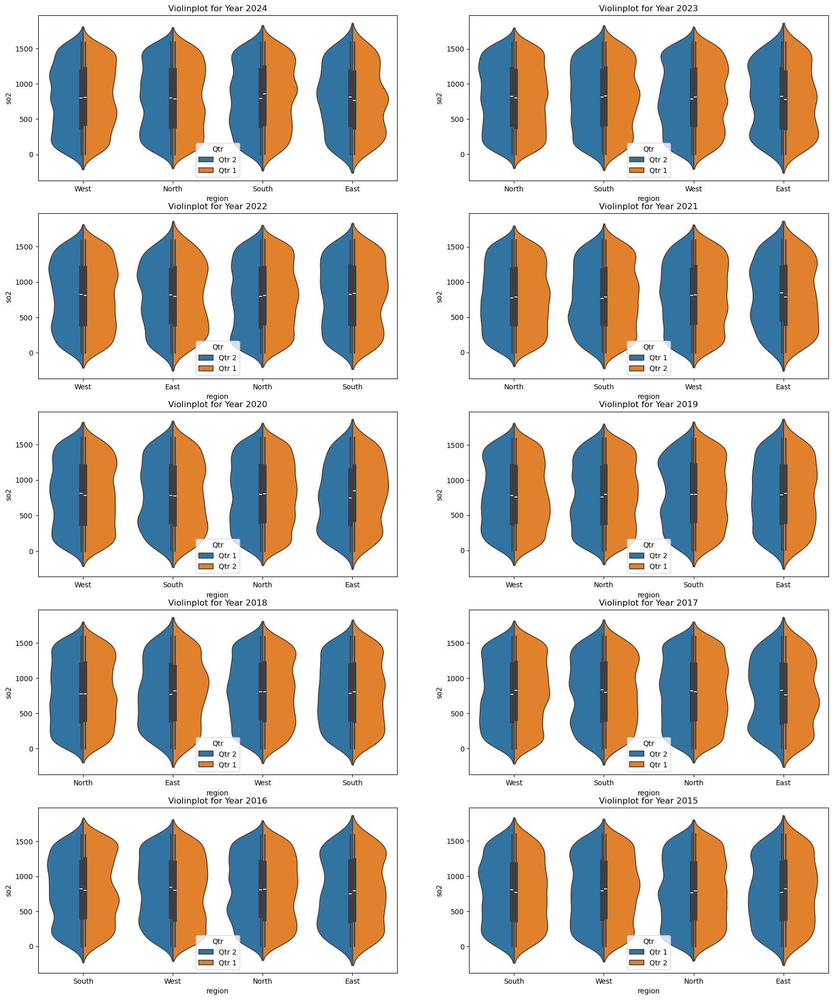

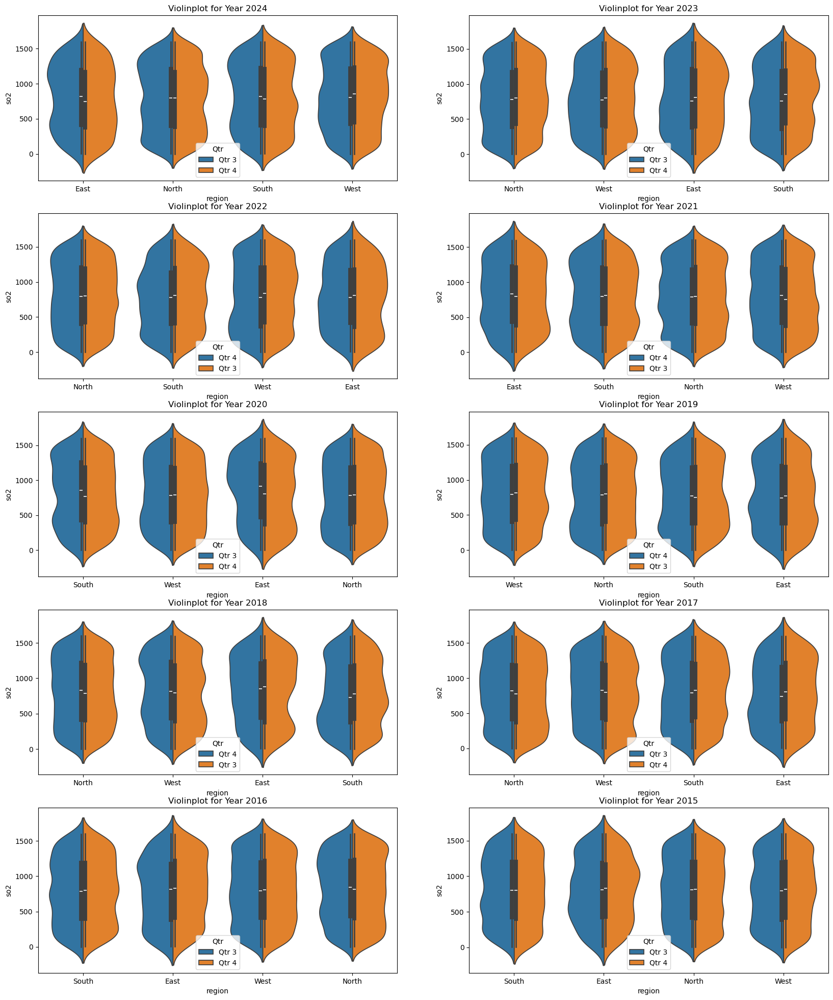

In [524]:
# Show pollution (SO2) across different regions using a violinplot on a map for 1st and 2nd half

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Graph 1: Graph for 1st half (Qtr 1 & Qtr2)')
print('Graph 2: Graph for 2nd half (Qtr 3 & Qtr4)')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h1=yt[yt['Qtr'].isin(['Qtr 1','Qtr 2'])]
    plt.subplot(20,2,i+1)
    sb.violinplot(data=h1,x='region',y='so2',hue='Qtr',split=True)
    plt.title(f'Violinplot for Year {yr[i]}')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h2=yt[yt['Qtr'].isin(['Qtr 3','Qtr 4'])]
    plt.subplot(20,2,i+1)
    sb.violinplot(data=h2,x='region',y='so2',hue='Qtr',split=True)
    plt.title(f'Violinplot for Year {yr[i]}')

plt.show()

Graph 1: For States
Graph 2: For Union Terotory


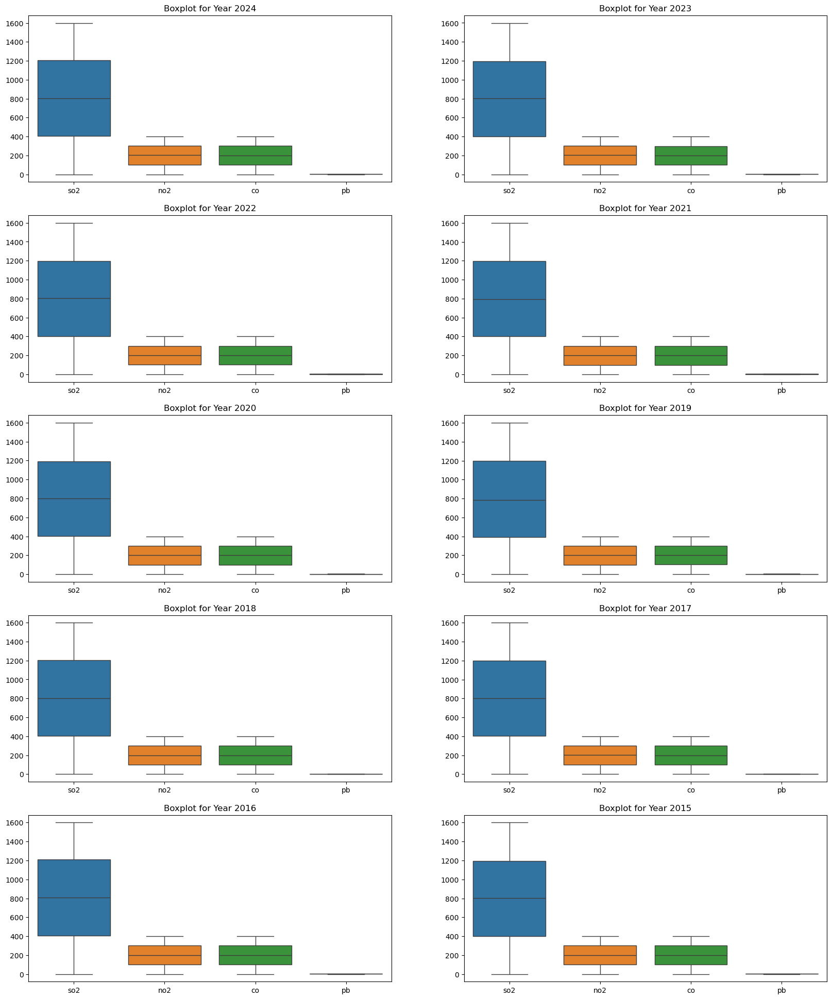

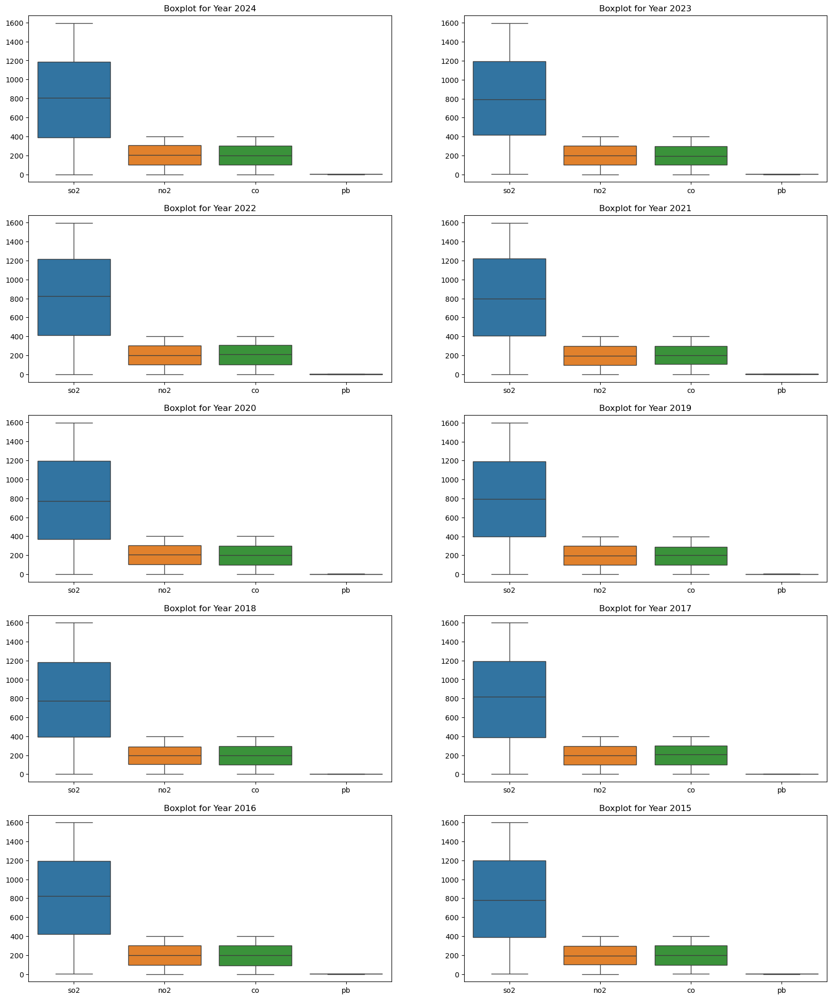

In [525]:
# Compare pollution in capital cities vs. other cities using a box plot.

yr=list(df['Year'].unique())
yr.sort(reverse=True)
ut=['Daman & Diu','Delhi', 'Puducherry','Dadra & Nagar Haveli']
clm=['so2', 'no2', 'co', 'pb']

print('Graph 1: For States')
print('Graph 2: For Union Terotory')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h1=yt[~(yt['state'].isin(ut))]
    plt.subplot(20,2,i+1)
    sb.boxplot(h1[clm])
    plt.title(f'Boxplot for Year {yr[i]}')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    h2=yt[yt['state'].isin(ut)]
    plt.subplot(20,2,i+1)
    sb.boxplot(h2[clm])
    plt.title(f'Boxplot for Year {yr[i]}')


#### 3. Pollutant-Specific Comparisons

Graph 1: SO2 vs NO2
Graph 2: PM 10 vs PM 2.5


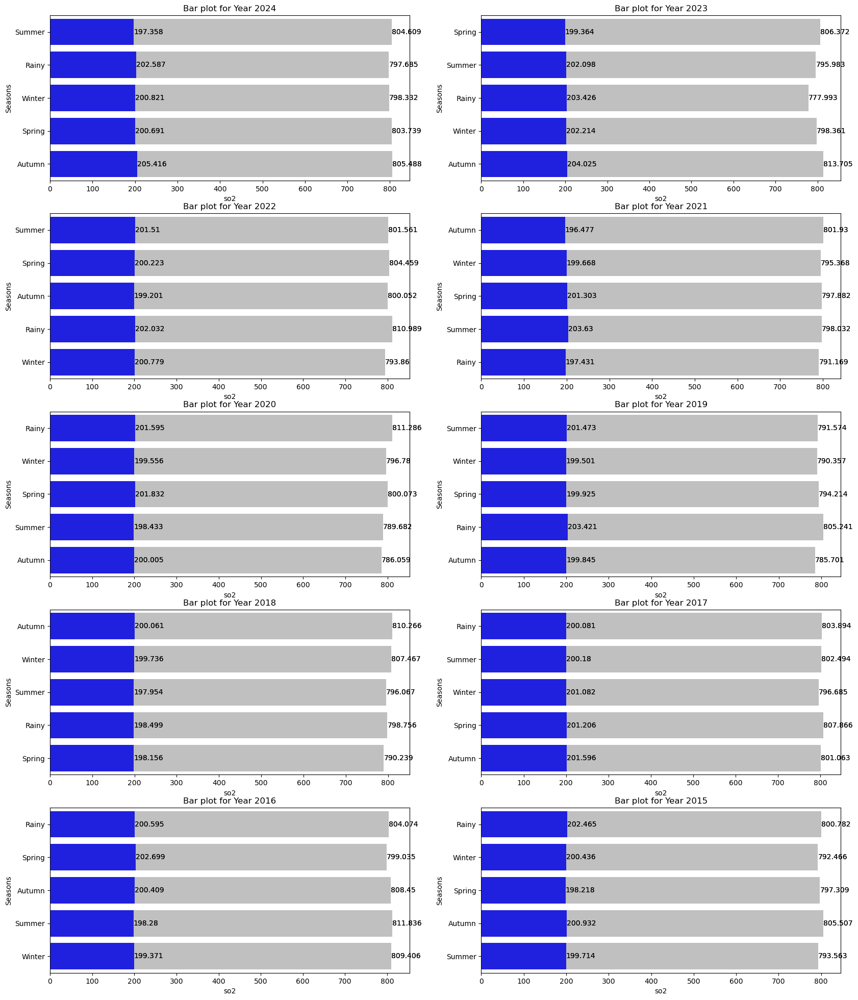

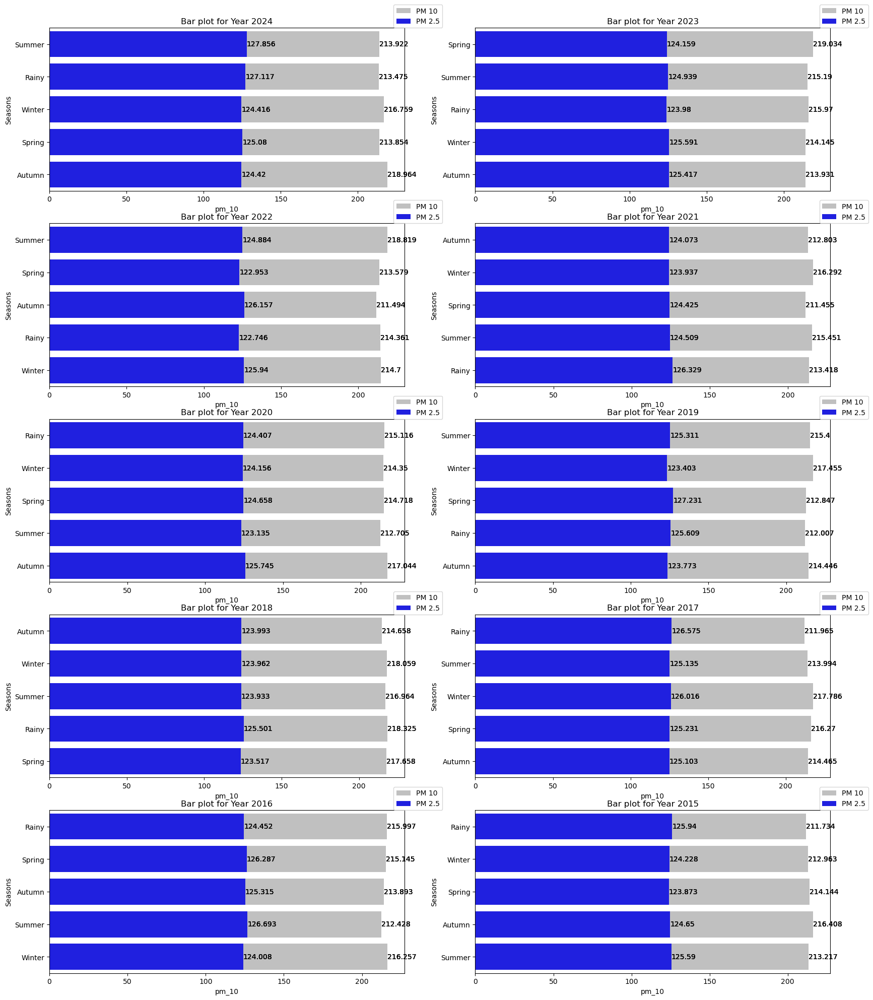

In [527]:
#  How do SO2, NO2, PM10, and PM2.5 correlate with each other Seasonwise

yr=list(df['Year'].unique())
yr.sort(reverse=True)

print('Graph 1: SO2 vs NO2')
print('Graph 2: PM 10 vs PM 2.5')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt1=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.barplot(data=yt1,x='so2',y='Seasons',errorbar=('ci',0),color='silver')
    c2=sb.barplot(data=yt1,x='no2',y='Seasons',errorbar=('ci',0),color='blue')
    for j in c1.containers:
        c1.bar_label(j)
    for k in c2.containers:
        c2.bar_label(k)
    plt.title(f'Bar plot for Year {yr[i]}')

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt2=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.barplot(data=yt2,x='pm_10',y='Seasons',errorbar=('ci',0),color='silver',label='PM 10')
    c2=sb.barplot(data=yt2,x='pm_2.5',y='Seasons',errorbar=('ci',0),color='blue',label='PM 2.5')
    for j in c1.containers:
        c1.bar_label(j)
    for k in c2.containers:
        c2.bar_label(k)
    for l in c1.containers:
        c1.bar_label(l)
    for m in c2.containers:
        c2.bar_label(m)

    plt.title(f'Bar plot for Year {yr[i]}')
    plt.legend(loc=(0.97,1))

plt.show()

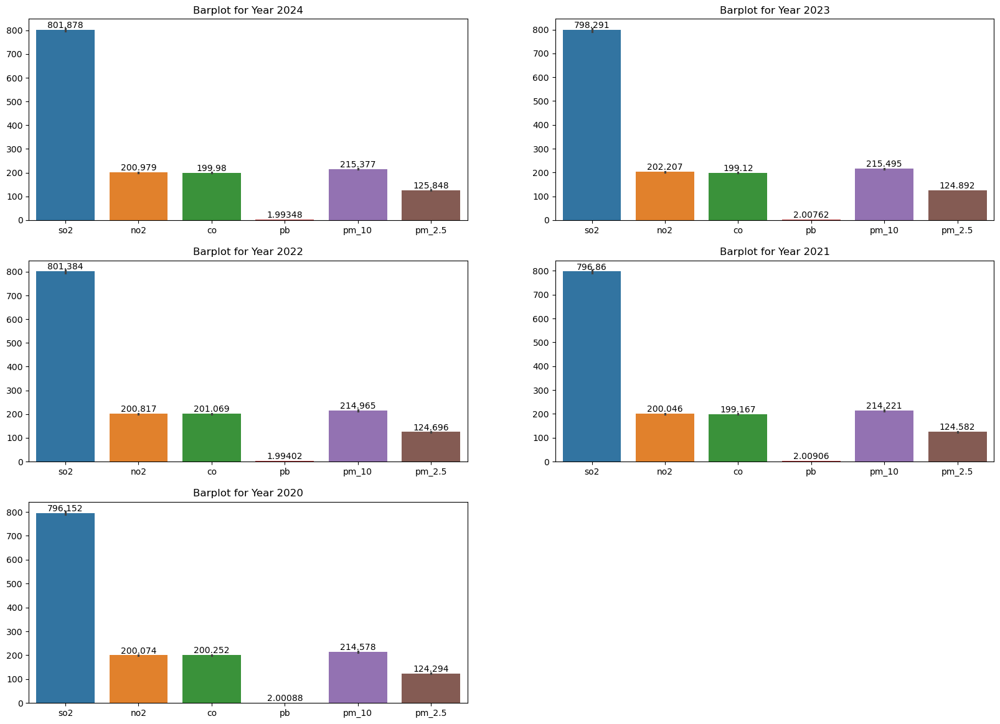

In [528]:
#  Which pollutant has shown the most significant increase over the last 5 years

yr=list(df['Year'].unique())
yr.sort(reverse=True)
yr=yr[:5]
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    cl=sb.barplot(data=yt[clm])
    for j in cl.containers:
        cl.bar_label(j)
    plt.title(f'Barplot for Year {yr[i]}')

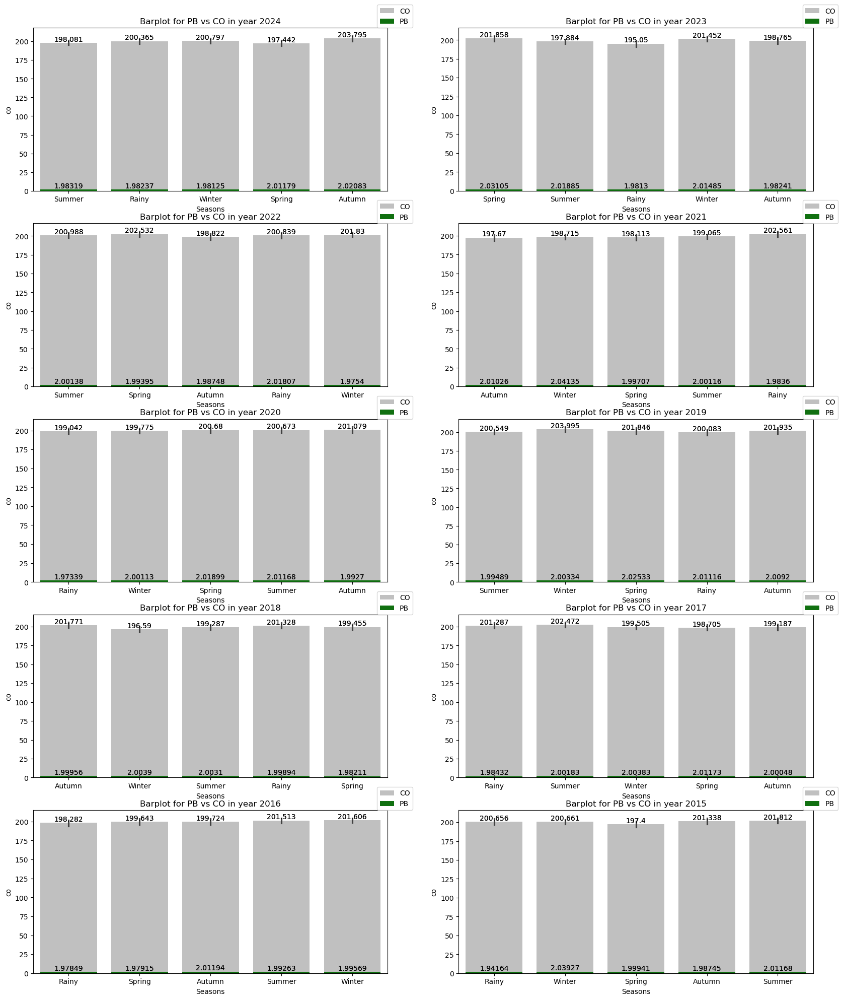

In [529]:
# How do pb and co levels compare in different seasons

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)

    h2=sb.barplot(data=yt,x='Seasons',y='co',color='silver',label='CO')
    h1=sb.barplot(data=yt,x='Seasons',y='pb',color='green',label='PB')


    for j in h1.containers:
        h1.bar_label(j)
    for k in h2.containers:
        h2.bar_label(k)
    plt.title(f'Barplot for PB vs CO in year {yr[i]}')
    plt.legend(loc=(0.97,1))

plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

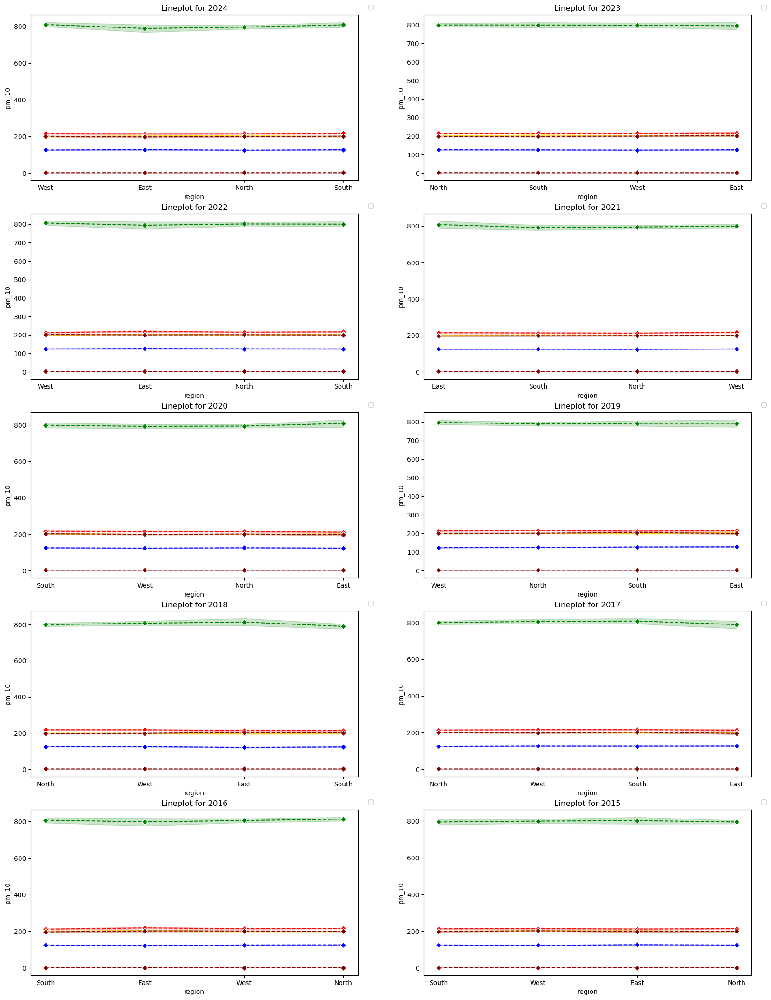

In [530]:
# Show a stacked area chart representing the total contribution of each pollutant over time.

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c1=sb.lineplot(x=yt['region'],y=yt['pm_10'],color="red",marker='D',linestyle='--')
    c2=sb.lineplot(x=yt['region'],y=yt['pm_2.5'],color="blue",marker='D',linestyle='--')
    c3=sb.lineplot(x=yt['region'],y=yt['so2'],color="green",marker='D',linestyle='--')
    c4=sb.lineplot(x=yt['region'],y=yt['no2'],color="gold",marker='D',linestyle='--')
    c5=sb.lineplot(x=yt['region'],y=yt['pb'],color="maroon",marker='D',linestyle='--')
    c6=sb.lineplot(x=yt['region'],y=yt['co'],color="maroon",marker='D',linestyle='--')

    plt.title(f'Lineplot for {yr[i]}')
    plt.legend(loc=(1.03,1.03))

plt.show()

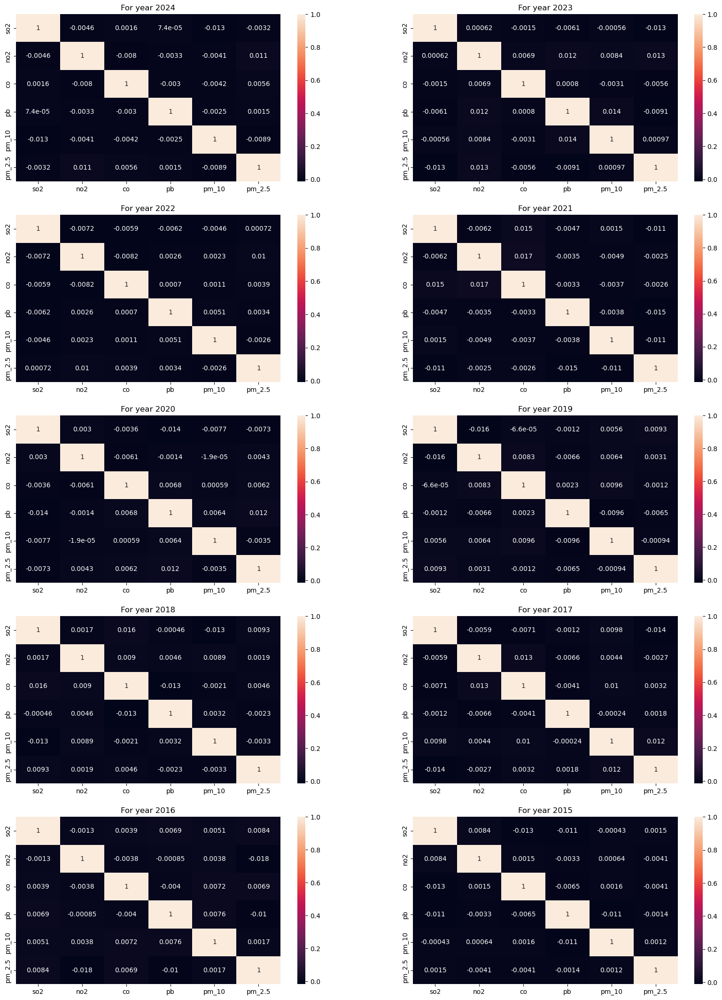

In [531]:
# Compare the concentration levels of all pollutant

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(20,110))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    sb.heatmap(yt[clm].corr(),annot=True)
    plt.title(f'For year {yr[i]}')

plt.show()

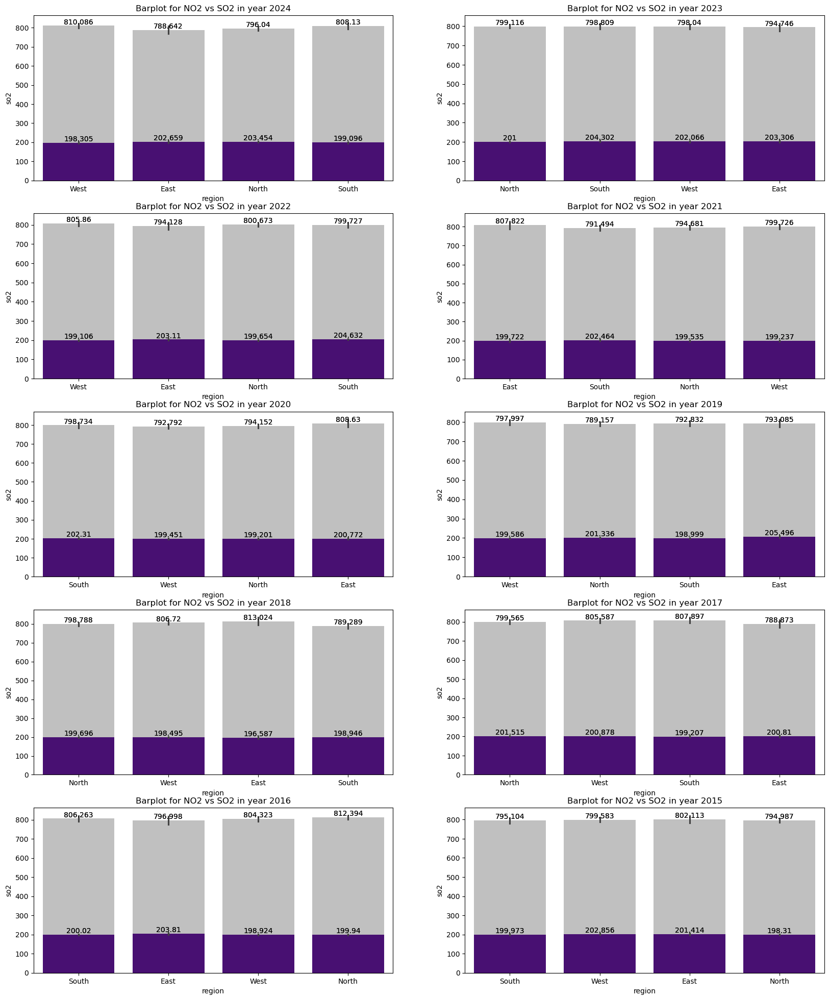

In [532]:
# How does the ratio of NO2 to SO2 vary across different region

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)

    h2=sb.barplot(data=yt,x='region',y='so2',color='silver')
    h1=sb.barplot(data=yt,x='region',y='no2',color='indigo')


    for j in h1.containers:
        h1.bar_label(j)
    for k in h2.containers:
        h2.bar_label(k)
    plt.title(f'Barplot for NO2 vs SO2 in year {yr[i]}')

plt.show()

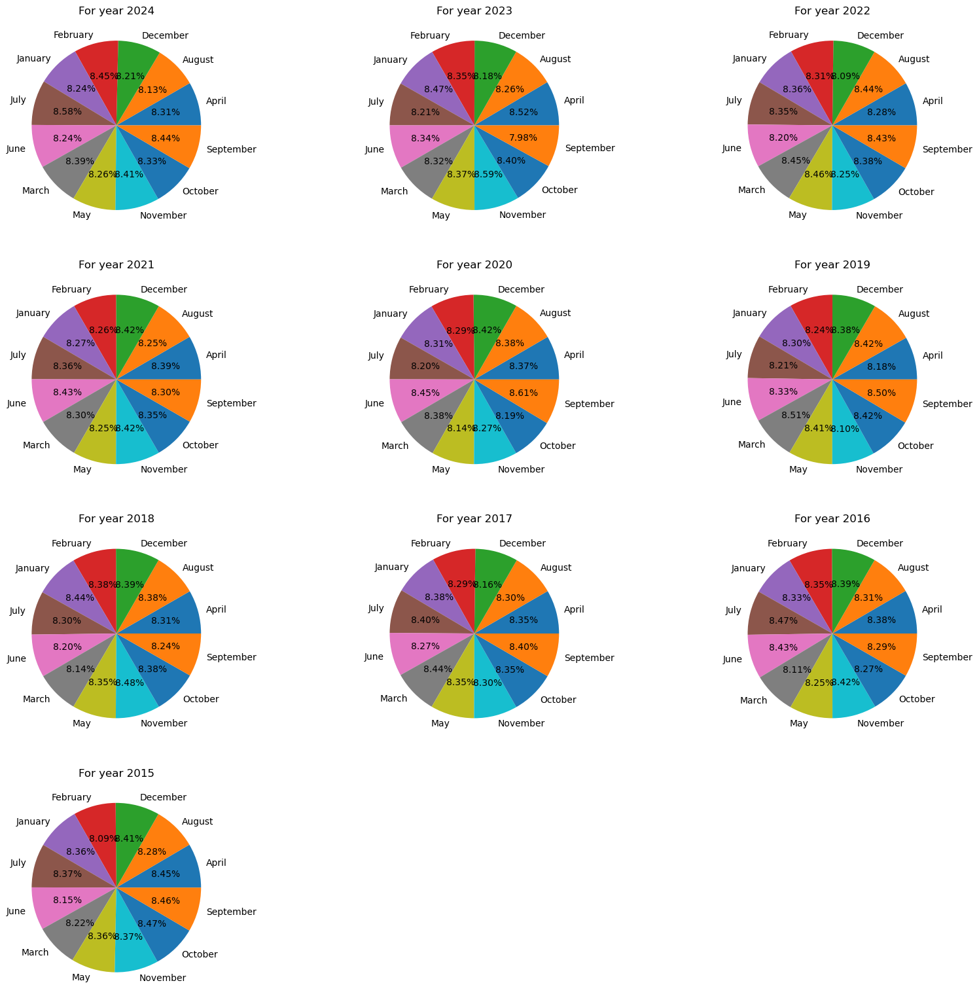

In [533]:
# Visualize how SO2 contributes to overall air quality in different month.

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(20,100))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,3,i+1)

    st=yt.groupby(['Month'])['so2'].mean()
    plt.pie(st,labels=st.index,autopct="%0.2f%%")
    plt.title(f'For year {yr[i]}')

plt.show()

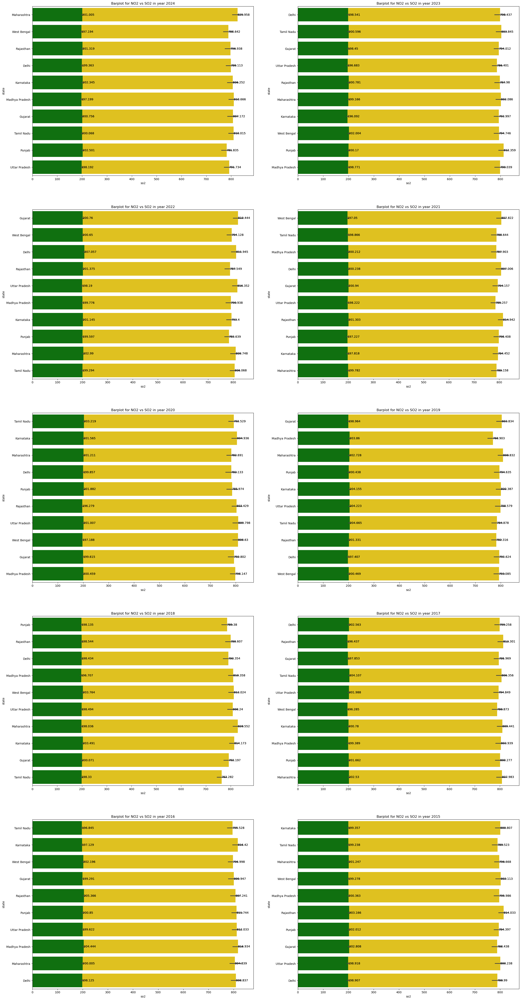

In [534]:
# Show the pollutant composition (so2 & co) per state using a stacked bar char

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,250))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)

    h1=sb.barplot(data=yt,y='state',x='so2',color='gold')
    h2=sb.barplot(data=yt,y='state',x='co',color='green')


    for j in h1.containers:
        h1.bar_label(j)
    for k in h2.containers:
        h2.bar_label(k)
    plt.title(f'Barplot for NO2 vs SO2 in year {yr[i]}')

plt.show()

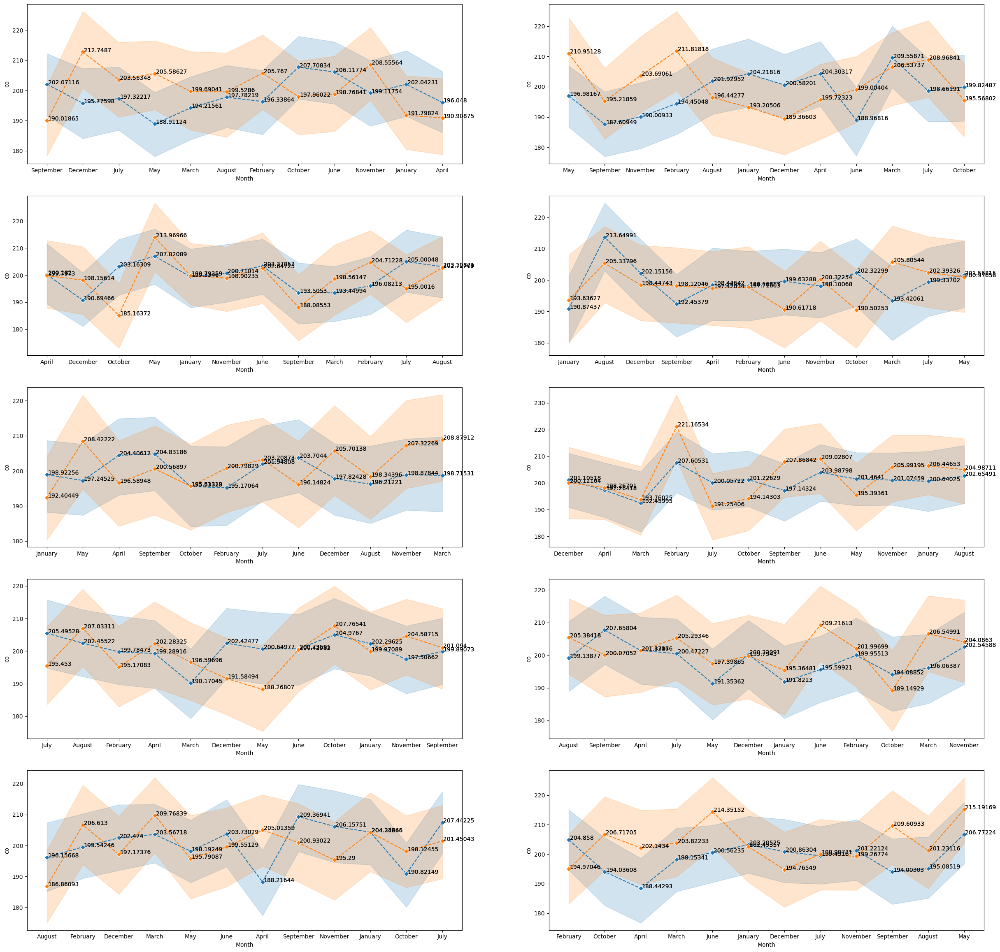

In [535]:
# How does the co differ between industrial and sensitive areas Monthwise

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,120))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    s1=yt[yt['type']=='Industrial Area']
    s2=yt[yt['type']=='Sensitive Area']
    c1=sb.lineplot(data=s1,x='Month',y='co',marker='D',linestyle='--')
    c2=sb.lineplot(data=s2,x='Month',y='co',marker='D',linestyle='--')
    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))

plt.show()


#### 4. Comparative Analysis

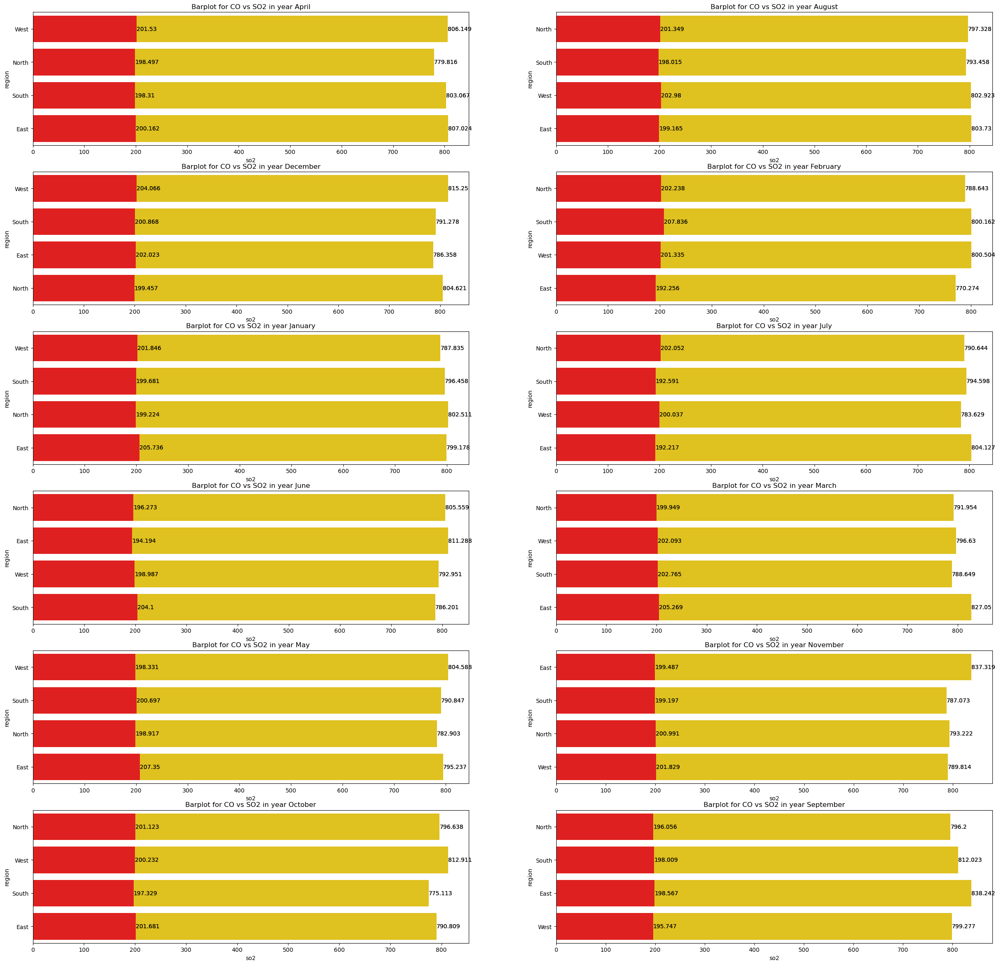

In [537]:
# Compare pollution levels SO2 and CO before and after lockdown periods regionwise

mn=list(df['Month'].unique())
mn.sort()

plt.figure(figsize=(30,200))
for i in range(len(mn)):
    yt=df[df['Month']==mn[i]]
    plt.subplot(40,2,i+1)
    s1=yt[yt['Year'].between(2018,2021)]
    s2=yt[yt['Year'].between(2022,2024)]
    c1=sb.barplot(data=s1,y='region',x='so2',color='gold',errorbar=('ci',0))
    c2=sb.barplot(data=s2,y='region',x='co',color='red',errorbar=('ci',0))
    for j in c1.containers:
        c1.bar_label(j)
    for k in c2.containers:
        c2.bar_label(k)
    plt.title(f'Barplot for CO vs SO2 in year {mn[i]}')




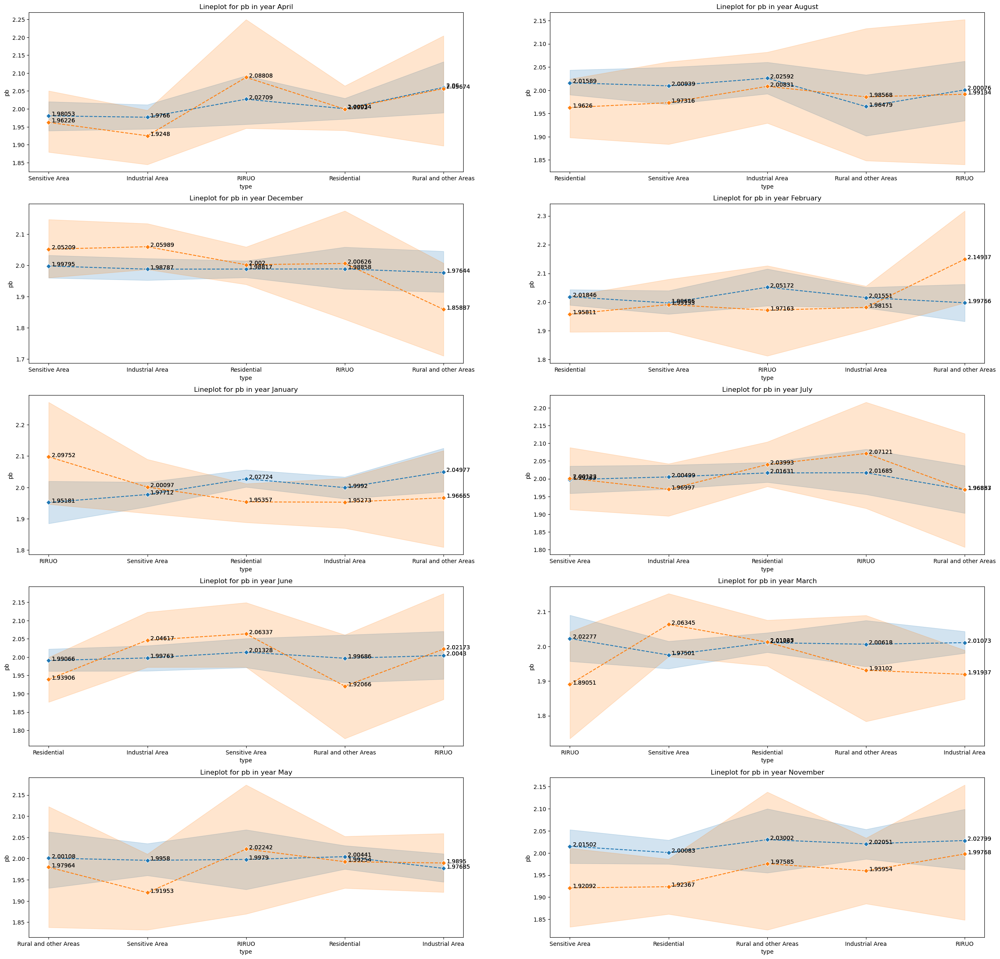

In [538]:
# How do pb levels change during and after rainfall events zonewise

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,120))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    s1=yt[yt['Seasons'].isin(['Spring','Autumn','Summer','Winter'])]
    s2=yt[yt['Seasons']=='Rainy']
    c1=sb.lineplot(data=s1,x='type',y='pb',marker='D',linestyle='--')
    c2=sb.lineplot(data=s2,x='type',y='pb',marker='D',linestyle='--')
    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))
    plt.title(f'Lineplot for pb in year {mn[i]}')

plt.show()

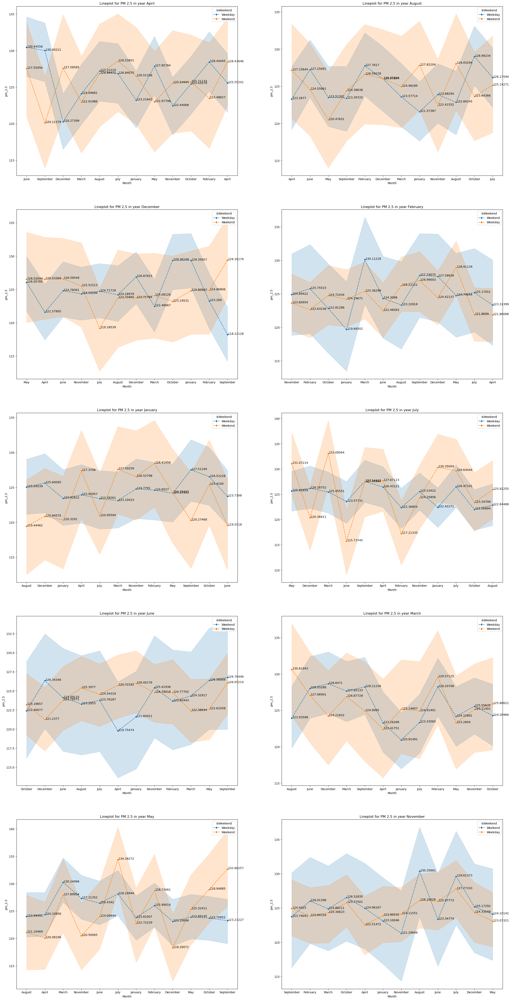

In [539]:
# Show the difference in PM 2.5 levels between weekdays and weekends based on month

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,250))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c=sb.lineplot(data=yt,x='Month',y='pm_2.5',hue='IsWeekend',marker='D',linestyle='--')
    for j in c.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    plt.title(f'Lineplot for PM 2.5 in year {mn[i]}')
plt.show()

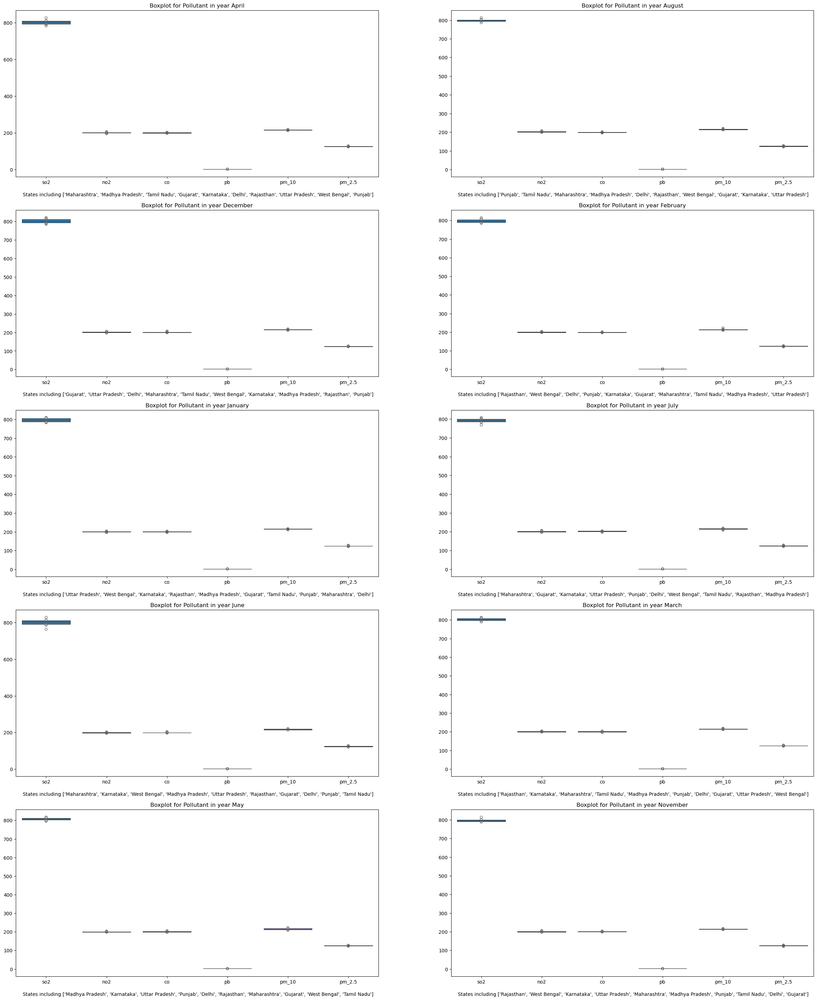

In [540]:
# What are the 5 most volatile state in terms of pb  pollution fluctuations

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(30,150))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    el=yt.groupby(['state'])[clm].mean().reset_index()
    el=el.sort_values(by=clm,ascending=False)[:10]
    sb.boxenplot(el)
    plt.title(f'Boxplot for Pollutant in year {mn[i]}')
    plt.xlabel(f"\n States including {list(el['state'])}", size=10)

plt.show()

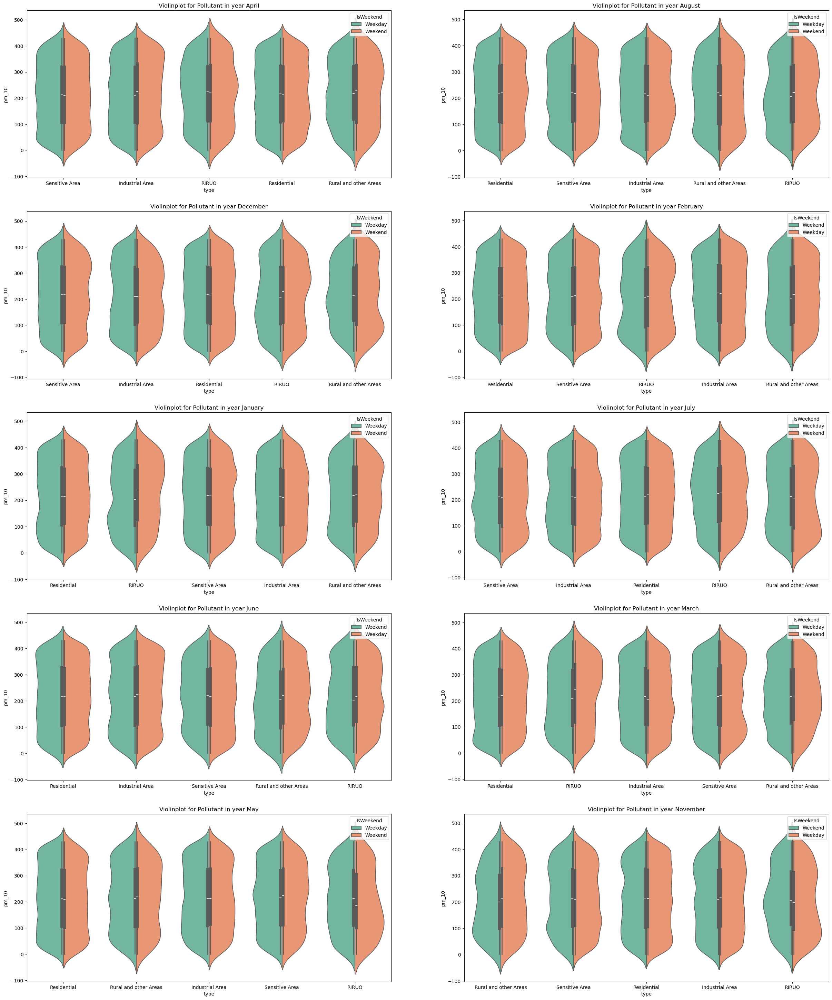

In [541]:
# Compare PM 10 pollution levels on weekends vs. weekdaysdays zonewise

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(30,150))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    sb.violinplot(data=yt,x='type',y='pm_10',hue='IsWeekend',palette='Set2',split=True)
    plt.title(f'Violinplot for Pollutant in year {mn[i]}')


plt.show()

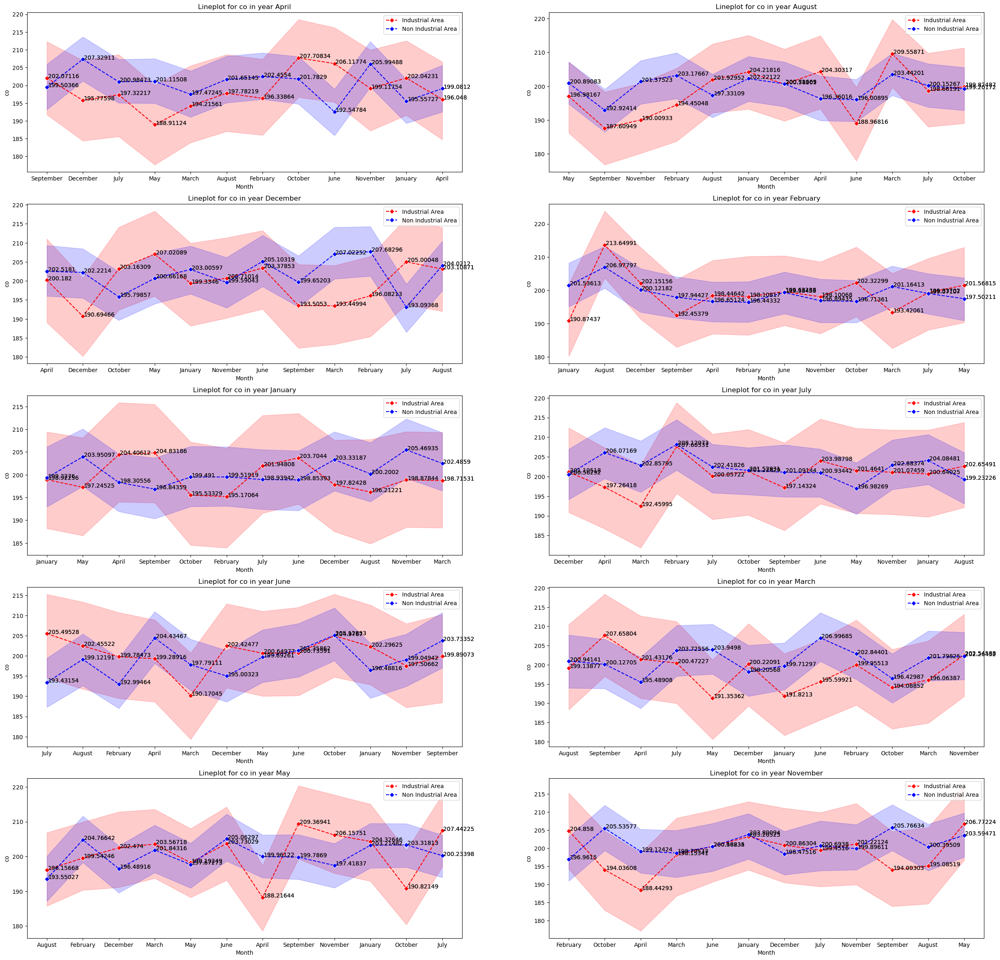

In [542]:
# Visualize the co level difference between industrial and non-industrial regions month

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,120))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    s1=yt[yt['type']=='Industrial Area']
    s2=yt[yt['type']!='Industrial Area']
    c1=sb.lineplot(data=s1,x='Month',y='co',marker='D',linestyle='--',color='red',label='Industrial Area')
    c2=sb.lineplot(data=s2,x='Month',y='co',marker='D',linestyle='--',color='blue',label='Non Industrial Area')
    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))
    plt.title(f'Lineplot for co in year {mn[i]}')

plt.show()


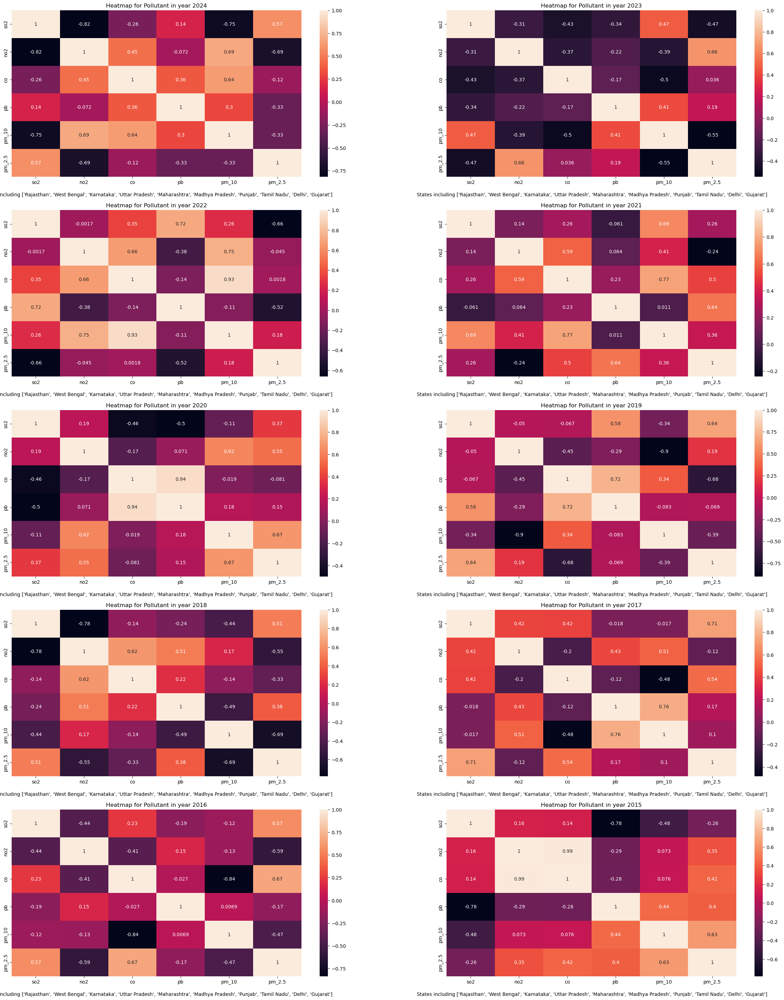

In [543]:
# What are the top 3 months with unusual pollution levels every year

yr=list(df['Year'].unique())
yr.sort(reverse=True)
clm=['so2', 'no2', 'co', 'pb', 'pm_10', 'pm_2.5']

plt.figure(figsize=(30,150))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    e=yt.groupby(['Month'])[clm].mean().reset_index()
    e=e.sort_values(by=clm,ascending=False)[:6]
    sb.heatmap(e[clm].corr(),annot=True)
    plt.title(f'Heatmap for Pollutant in year {yr[i]}')
    plt.xlabel(f"\n States including {list(el['state'])}", size=10)
plt.show()

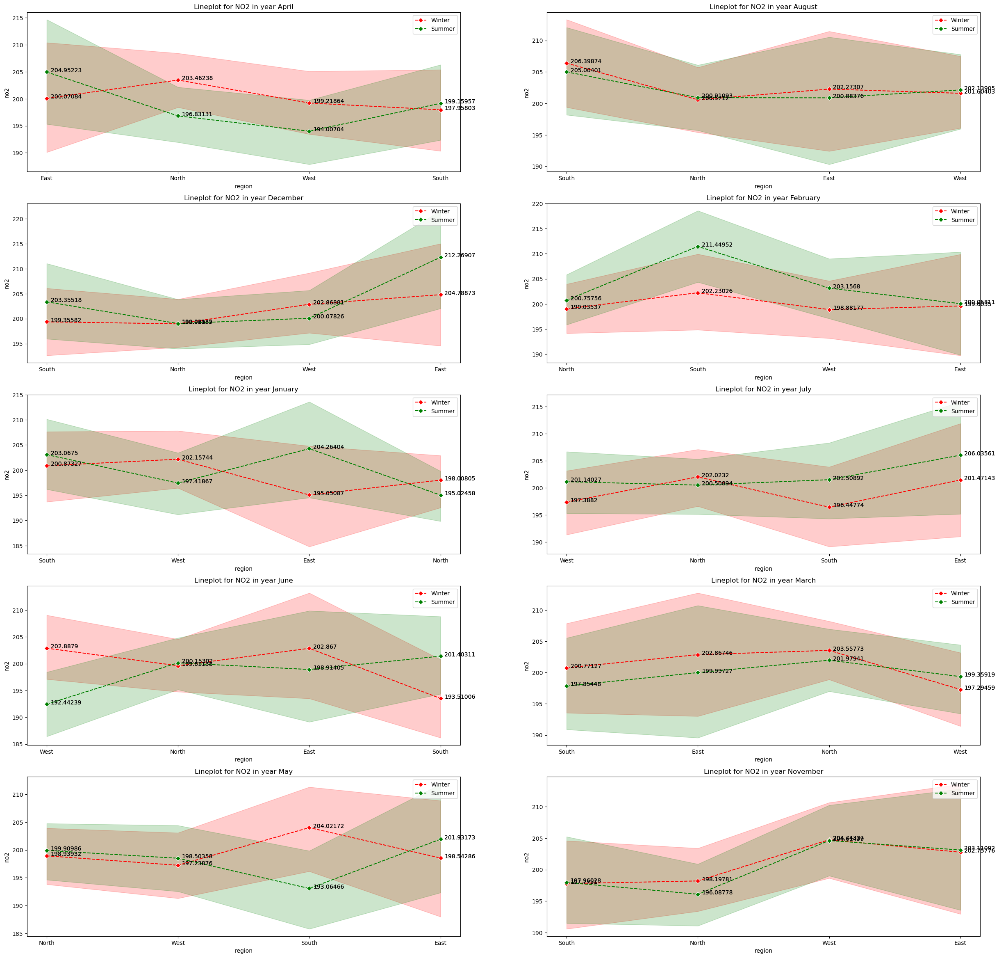

In [544]:
# How does NO2 vary between winter and summer months Regionwise? (Stacked Line Chart)

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,120))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    s1=yt[yt['Seasons']=='Winter']
    s2=yt[yt['Seasons']=='Summer']
    c1=sb.lineplot(data=s1,x='region',y='no2',marker='D',linestyle='--',color='red',label='Winter')
    c2=sb.lineplot(data=s2,x='region',y='no2',marker='D',linestyle='--',color='green',label='Summer')
    for j in c1.get_lines():
        for a,b in zip(j.get_xdata(),j.get_ydata()):
            plt.text(a+0.03,b,round(b,5))
    for k in c2.get_lines():
        for c,d in zip(k.get_xdata(),k.get_ydata()):
            plt.text(c+0.03,d,round(d,5))
    plt.title(f'Lineplot for NO2 in year {mn[i]}')

plt.show()

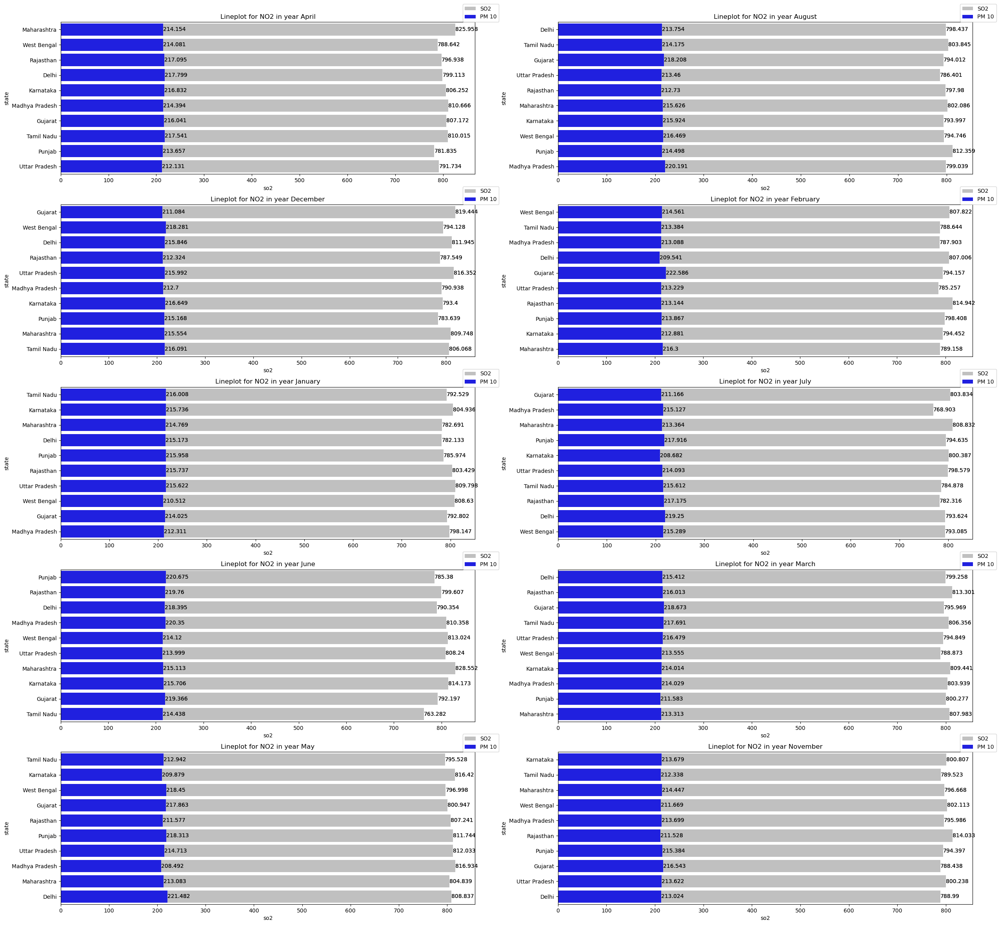

In [545]:
# Compare NO2 and PM10 pollution trends statewise.

yr=list(df['Year'].unique())
yr.sort(reverse=True)

plt.figure(figsize=(30,120))
for i in range(len(yr)):
    yt=df[df['Year']==yr[i]]
    plt.subplot(20,2,i+1)
    c2=sb.barplot(data=yt,x='so2',y='state',errorbar=('ci',0),color='silver',label='SO2')
    c1=sb.barplot(data=yt,x='pm_10',y='state',errorbar=('ci',0),color='blue',label='PM 10')

    for l in c1.containers:
        c1.bar_label(l)
    for m in c2.containers:
        c2.bar_label(m)
    plt.title(f'Lineplot for NO2 in year {mn[i]}')
    plt.legend(loc=(0.97,1))

plt.show()

## Divide the data into Actuall Groups (Clustering [KMean] )

In [547]:
from sklearn.cluster import KMeans

### Scaling and Encoding

In [549]:
from sklearn.preprocessing import StandardScaler,LabelEncoder

In [550]:
# Encoding

In [551]:
ws=df.dtypes[df.dtypes=='object'].index
for i in ws:
    print(i,df[i].nunique())

state 10
location 30
type 5
Qtr 4
Month 12
Day 7
IsWeekend 2
Seasons 5
region 4
In_ct 2


In [552]:
lb=LabelEncoder()
cl=['state','location','Month','Day']
for i in cl:
    df[i]=lb.fit_transform(df[i])

In [553]:
dm=pd.get_dummies(data=df,columns=['type','Qtr','IsWeekend','Seasons','region','In_ct'],drop_first=True,dtype=int)
dm.shape

(200000, 28)

In [554]:
x=dm.drop('date',axis=1)
x.shape

(200000, 27)

In [555]:
# Standardization

In [556]:
ss=StandardScaler()
x_s=ss.fit_transform(x)

In [559]:
xs=pd.DataFrame(data=x_s,columns=x.columns)
xs.shape

(200000, 27)

### Determine optimal Clusters

In [561]:
n_cls=np.arange(1,21)
wcss=[]

In [562]:
for i in n_cls:
    cs=KMeans(n_clusters=i,random_state=50)
    cs.fit(xs)
    wcss.append(cs.inertia_)

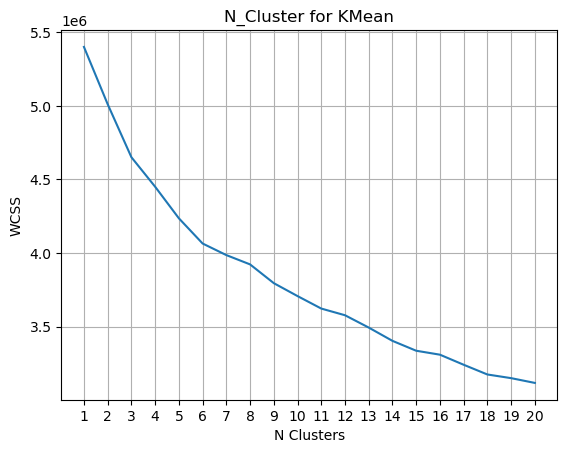

In [563]:
plt.plot(n_cls,wcss)
plt.title('N_Cluster for KMean')
plt.xlabel('N Clusters')
plt.ylabel('WCSS')
plt.xticks(n_cls)
plt.grid()
plt.show()

In [564]:
# Optimal Clusters :- 4,5,6,7

### Clustering using optimal clusters [4,5,6,7 ]

In [566]:
cls1=KMeans(n_clusters=4,random_state=50)
cls1.fit(xs)

cls2=KMeans(n_clusters=5,random_state=50)
cls2.fit(xs)

cls3=KMeans(n_clusters=6,random_state=50)
cls1.fit(xs)

cls4=KMeans(n_clusters=7,random_state=50)
cls1.fit(xs)

KMeans(n_clusters=4, random_state=50)

In [567]:
x['cls_1']=cls1.fit_predict(xs)
x['cls_2']=cls2.fit_predict(xs)
x['cls_3']=cls3.fit_predict(xs)
x['cls_4']=cls4.fit_predict(xs)


In [582]:
cls=['cls_1','cls_2','cls_3','cls_4']
for i in cls:
    print(x[i].value_counts())
    print('\n')

cls_1
1    70190
0    67084
2    33039
3    29687
Name: count, dtype: int64


cls_2
1    50226
3    49968
0    33416
4    33351
2    33039
Name: count, dtype: int64


cls_3
2    43112
5    40105
0    33778
4    33351
3    29687
1    19967
Name: count, dtype: int64


cls_4
2    43112
5    40105
0    33778
3    29687
1    19967
4    16704
6    16647
Name: count, dtype: int64




### Cluster Profiling

In [584]:
def cluster_profile(n,dt,dt_s):
    dt1=dt.mean().reset_index()
    dt1.columns=['Feature','Mean']

    km=KMeans(n_clusters=n,random_state=50)
    km.fit(dt_s)

    dt[f'Cls_{n}']=km.predict(dt_s)
    dt2=dt.groupby(f'Cls_{n}').mean().T.reset_index()
    dt2.columns=['Feature']+list(range(n))
    dt_f=pd.merge(dt1,dt2,on='Feature')
    return dt_f

In [585]:
n_cls=[4,5,6,7]

In [586]:
cls_4=cluster_profile(4,x,xs)
cls_4.head(10)

,Feature,Mean,0,1,2,3
0,state,4.501420,4.004457,4.826243,4.515905,4.840300
1,location,14.485520,14.180684,14.673358,14.502043,14.711860
2,so2,799.452204,797.665777,800.671048,800.164270,799.814789
3,no2,200.485628,200.323310,200.353690,201.199933,200.369408
4,co,200.202938,200.023546,200.226677,199.954795,200.828346
5,pb,2.000431,2.005846,2.001789,1.985322,2.001795
6,pm_10,214.998477,215.232995,214.717078,214.257379,215.958630
7,pm_2.5,124.919549,124.976787,124.834588,125.266050,124.605461
8,Year,2019.489570,2019.482246,2019.487349,2019.496020,2019.504194
9,Month,5.503990,5.394774,6.438439,5.988347,3.002392


In [588]:
cls_5=cluster_profile(5,x,xs)
cls_5.head(10)

,Feature,Mean,0,1,2,3,4
0,state,4.501420,4.010983,4.835504,4.515905,4.497959,4.480525
1,location,14.485520,14.215944,14.665631,14.502043,14.455371,14.513178
2,so2,799.452204,800.102125,799.686489,800.164270,797.884017,800.092313
3,no2,200.485628,199.845511,200.690805,201.199933,200.317037,200.362971
4,co,200.202938,200.630303,200.085540,199.954795,200.493292,199.762338
5,pb,2.000431,2.007618,1.997106,1.985322,2.005936,2.004954
6,pm_10,214.998477,215.479728,214.362881,214.257379,215.879571,214.887551
7,pm_2.5,124.919549,125.245353,124.944291,125.266050,124.568747,124.738178
8,Year,2019.489570,2019.468847,2019.498208,2019.496020,2019.500040,2019.475248
9,Month,5.503990,7.616202,7.595409,5.988347,3.002542,3.505982


In [589]:
cls_6=cluster_profile(6,x,xs)
cls_6.head(10)

,Feature,Mean,0,1,2,3,4,5
0,state,4.501420,3.999053,4.803726,4.593361,4.840300,4.480525,4.441715
1,location,14.485520,14.132808,14.752792,14.546600,14.711860,14.513178,14.393318
2,so2,799.452204,797.041767,802.994042,799.940368,799.814789,800.092313,798.393528
3,no2,200.485628,200.504333,200.702771,200.960219,200.369408,200.362971,200.039623
4,co,200.202938,200.310292,200.161297,199.582392,200.828346,199.762338,200.703778
5,pb,2.000431,2.007703,1.999556,1.986329,2.001795,2.004954,2.005128
6,pm_10,214.998477,215.544856,214.522955,214.403803,215.958630,214.887551,214.795812
7,pm_2.5,124.919549,124.704571,124.775054,125.313190,124.605461,124.738178,125.132721
8,Year,2019.489570,2019.479010,2019.483999,2019.494364,2019.504194,2019.475248,2019.497170
9,Month,5.503990,5.598022,9.494766,5.757423,3.002392,3.505982,6.678768


In [590]:
cls_7=cluster_profile(7,x,xs)
cls_7.head(10)

,Feature,Mean,0,1,2,3,4,5,6
0,state,4.501420,3.999053,4.803726,4.593361,4.840300,4.480843,4.441715,4.480207
1,location,14.485520,14.132808,14.752792,14.546600,14.711860,14.517541,14.393318,14.508800
2,so2,799.452204,797.041767,802.994042,799.940368,799.814789,798.611761,798.393528,801.577935
3,no2,200.485628,200.504333,200.702771,200.960219,200.369408,200.550660,200.039623,200.174639
4,co,200.202938,200.310292,200.161297,199.582392,200.828346,200.267641,200.703778,199.255305
5,pb,2.000431,2.007703,1.999556,1.986329,2.001795,2.011950,2.005128,1.997934
6,pm_10,214.998477,215.544856,214.522955,214.403803,215.958630,215.609267,214.795812,214.163365
7,pm_2.5,124.919549,124.704571,124.775054,125.313190,124.605461,125.370546,125.132721,124.103646
8,Year,2019.489570,2019.479010,2019.483999,2019.494364,2019.504194,2019.486889,2019.497170,2019.463567
9,Month,5.503990,5.598022,9.494766,5.757423,3.002392,7.000000,6.678768,0.000000
